# BULLKpy - TCGA RNAseq data
@mmm, January 23, 2026

<div style="font-size: 24px; line-height: 1.1; column-count: 2;">
Notebook Menu

<div style="font-size: 18px; line-height: 1.4; column-count: 2;">
<a href="#imports">1. Imports and settings</a><br>
<a href="#loads">2. Load original data into AnnData and BULLKpy object</a><br>
<a href="#pp">3. Quality control and Preprocessing</a><br>
<a href="#pca">4. PCA and Bidimensional Representation</a><br>
<a href="#clusters">5. Clustering and groups</a><br>
<a href="#genes">6. Genes and Gene Signatures</a><br>
<a href="#exploration">7. Data Exploration</a><br>
<a href="#correlations">8. Associations & Correlations</a><br>
<a href="#de">9. Markers and Differential Expression</a><br>
<a href="#go">10. Pathway and Gene Enrichment Analysis</a><br>
<a href="#mp">11. Metaprograms and Tumor Heterogeneity</a><br>
<a href="#plots">12. Additional Plots</a><br>
<a href="#utilities">13. Utilities Data</a><br>

# 1. Imports and settings
<a id="imports"></a>

## 1.1. Modules and Settings

In [1]:
import os
import re
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime

import anndata as ad
import bullkpy as bk

import gseapy as gspy
from gseapy import Msigdb
from gseapy import gseaplot
from gseapy import enrichment_map

In [2]:
bk.settings.verbosity = 3
bk.settings.plot_theme = "paper"      # "default" | "paper" | "talk"
bk.settings.plot_palette = "Set1"
bk.settings.plot_fontsize = 10        # optional
bk.settings.plot_dpi = 200
bk.settings.save_dpi = 300

# every plot calls set_style() internally, or you can call once:
bk.pl.set_style()

import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="lifelines")

In [3]:
import sys
sys.version

'3.10.10 | packaged by conda-forge | (main, Mar 24 2023, 20:12:31) [Clang 14.0.6 ]'

In [4]:
print("Numpy:", np.__version__, "Pandas:", pd.__version__, "Matplotlib:", mpl.__version__, "Seaborn:", sns.__version__, 
      "AnnData:", ad.__version__, "GSEApy:", gspy.__version__)

Numpy: 1.23.5 Pandas: 2.3.3 Matplotlib: 3.8.0 Seaborn: 0.11.2 AnnData: 0.10.3 GSEApy: 1.1.0


In [5]:
pal = sns.color_palette("husl", n_colors=35)       # palette for large categories
bk.settings.set_palette_for("Project_ID", where="obs", palette="husl")

In [6]:
PATH = "/Users/mmalumbres/Desktop/BioDATA/TCGA/"
DESKTOP = "/Users/mmalumbres/Desktop/"

## DELETE IN PUBLIC --_> Load AnnData (when available; otherwise go to section 2)

In [7]:
# h5ad file (compressed) with metadata, preprocessing + PCA + UMAP + scores etc.
adata = ad.read_h5ad("../data/h5ad/251226_BULLKpy_TCGA_RNAseq.h5ad")

In [8]:
adata_lung = ad.read_h5ad("../data/h5ad/251226_BULLKpy_TCGA_lung_RNAseq.h5ad")

In [7]:
adata.shape

(10534, 52603)

## --_> DELETE. Save new versions of .h5ad files

In [ ]:
adata.write("../data/h5ad/251226_BULLKpy_TCGA_RNAseq.h5ad",
            compression="gzip",
            compression_opts=4,   # good balance speed/size
            )

In [59]:
adata_lung = adata[(adata.obs["Project_ID"] == "LUAD") | (adata.obs["Project_ID"] == "LUSC")]

In [37]:
adata_lung.write("../data/h5ad/251226_BULLKpy_TCGA_lung_RNAseq.h5ad",
                 compression="gzip",
                 compression_opts=4,   # good balance speed/size
                 )

In [ ]:
adata

# 2. Load data into AnnData and BULLKpy object
<a id="loads"></a>

## 2.1. Load expression data

Read external data (counts, cpm, log-data etc.)

In [4]:
df = pd.read_csv(PATH + "Xena/Gene expression/tcga_RSEM_Hugo_norm_count.tsv", sep="\t")
print(df.shape)
df.head(3)

(58581, 10536)


,sample,TCGA-S9-A7J2-01,TCGA-G3-A3CH-11,TCGA-EK-A2RE-01,TCGA-44-6778-01,TCGA-F4-6854-01,TCGA-AB-2863-03,TCGA-C8-A1HL-01,TCGA-EW-A2FS-01,TCGA-05-4420-01,...,TCGA-DJ-A2QC-01,TCGA-A8-A09K-01,TCGA-61-1907-01,TCGA-IB-7885-01,TCGA-B6-A0IA-01,TCGA-VQ-AA6F-01,TCGA-BR-8588-01,TCGA-24-2254-01,TCGA-DD-A115-01,TCGA-FV-A3I0-11
0,CTD-2588J6.1,0.7385,0.0,0.0,0.0,0.0,1.1763,0.0,0.0,0.9652,...,0.0,0.0,0.0,0.0,0.0,1.1745,0.0,0.0,0.0,0.0
1,RP11-433M22.1,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0000,...,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0
2,CTD-2588J6.2,0.0000,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0000,...,0.0,0.0,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0


Set Sample ID as index using pandas and transpose the table

In [5]:
df = df.set_index("sample")
df = df.T
df.head(3)

sample,CTD-2588J6.1,RP11-433M22.1,CTD-2588J6.2,RP3-415N12.1,RP11-16E12.2,RP11-433M22.2,PSMA2P3,RP11-181G12.4,RP11-181G12.2,AC007272.3,...,RP11-390F4.3,GNGT2,GNGT1,SELT,DIAPH2-AS1,SELV,NFIX,SELP,AC002386.1,RP11-526P5.2
TCGA-S9-A7J2-01,0.7385,0.0,0.0,1.2246,3.1734,0.0,0.0,0.0,6.5737,0.7385,...,2.9420,4.0334,0.000,12.0972,1.8773,5.6185,14.6130,0.0000,0.0,0.0
TCGA-G3-A3CH-11,0.0000,0.0,0.0,0.0000,4.2488,0.0,0.0,0.0,3.3227,0.0000,...,7.2187,6.2406,0.000,11.6937,1.2721,0.0000,11.2143,7.7539,0.0,0.0
TCGA-EK-A2RE-01,0.0000,0.0,0.0,0.0000,1.7038,0.0,0.0,0.0,3.9175,0.0000,...,3.1541,4.3356,2.604,12.0661,3.5521,0.0000,10.2760,0.6456,0.0,0.0


Store data as AnnData object.  
It is important to understand AnnData structure, visit: https://anndata.readthedocs.io/en/stable/   

In [6]:
adata = ad.AnnData(
    X=df.values,
    obs=pd.DataFrame(index=df.index),           # Obs: samples
    var=pd.DataFrame(index=df.columns),         # var: genes
)
adata

AnnData object with n_obs × n_vars = 10535 × 58581

## 2.2. Load metadata

Metadata store information relative to observations (Samples); e.g. tumor type; age of the patients, tumor purity, immune infiltration, survival, etc.  
Use an external table (excel, csv, tsv etc.)  

In [8]:
# Option 1 for easy metadata tables
adata = bk.add_metadata(adata, 
                        PATH + "251226_TCGA_metadata.tsv", 
                        low_memory=False, 
                        sep="\t",
                        index_col="Sample_ID",)
adata

INFO: Adding metadata from /Users/mmalumbres/Desktop/BioDATA/TCGA/251226_TCGA_metadata.tsv
/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/io.py:128: DtypeWarning: Columns (31,289,510,555,560,561,564,627,672,704,705,706,707,710,711,714,715,722,723,724,730,770,821,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,938,940,946,947,949,950,951,952,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024,1025,1026,1027,1028,1029,1030,1031,10

AnnData object with n_obs × n_vars = 10535 × 58581
    obs: 'Patient_ID_x', 'Project_ID_x', 'gender_x', 'race_x', 'ajcc_pathologic_tumor_stage_x', 'clinical_stage_x', 'histological_type_x', 'histological_grade_x', 'initial_pathologic_dx_year_x', 'menopause_status_x', 'birth_days_to_x', 'vital_status_x', 'tumor_status_x', 'last_contact_days_to_x', 'death_days_to_x', 'cause_of_death_x', 'new_tumor_event_type_x', 'new_tumor_event_site_x', 'new_tumor_event_site_other_x', 'new_tumor_event_dx_days_to_x', 'treatment_outcome_first_course_x', 'margin_status_x', 'OS_x', 'OS.time_x', 'DSS_x', 'DSS.time_x', 'DFI_x', 'DFI.time_x', 'PFI_x', 'PFI.time_x', 'Redaction_x', 'Subtype_mRNA_x', 'Subtype_DNAmeth_x', 'Subtype_protein_x', 'Subtype_miRNA_x', 'Subtype_CNA_x', 'Subtype_Integrative_x', 'Subtype_other_x', 'Subtype_Selected_x', 'sample_type_id_x', 'sample_type_x', '_primary_disease_x', 'Subtype_Immune_Model_Based_x', 'ICS5_score_x', 'LIexpression_score_x', 'Chemokine12_score_x', 'NHI_5gene_score_x',

In [22]:
# Option 2 for tables with complicated format that require modifications in python
metadata = pd.read_csv(PATH + "251226_TCGA_metadata.tsv", sep="\t",
                      encoding="latin1", low_memory=False,
                      )
metadata = metadata.set_index("Sample_ID")
print(metadata.shape)
metadata.head(3)

(10534, 1115)


,Patient_ID,Project_ID,gender,race,ajcc_pathologic_tumor_stage,clinical_stage,histological_type,histological_grade,initial_pathologic_dx_year,menopause_status,...,SLIT2_mut,MYC_mut,MYCL_mut,MYCN_mut,SOX2_mut,ASCL1_mut,NEUROD1_mut,POU2F3_mut,YAP1_mut,NE25_score
Sample_ID,,,,,,,,,,,,,,,,,,,,,
TCGA-S9-A7J2-01,TCGA-S9-A7J2,LGG,MALE,WHITE,NaN,NaN,Oligodendroglioma,G3,2013.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.836809
TCGA-G3-A3CH-11,TCGA-G3-A3CH,LIHC,MALE,ASIAN,Stage IIIA,NaN,Hepatocellular Carcinoma,G2,2010.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.849212
TCGA-EK-A2RE-01,TCGA-EK-A2RE,CESC,FEMALE,WHITE,NaN,Stage IIA,Cervical Squamous Cell Carcinoma,G2,2010.0,Pre (<6 months since LMP AND no prior bilatera...,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-2.038225


In [25]:
adata.uns["bullkpy"] = {
    "version": bk.__version__,
    "date": __import__("datetime").datetime.now().isoformat(),
}

Save the AnnData object for future uses

# 3. Quality Control and preprocessing
<a id="pp"></a>

In [16]:
# h5ad file (compressed) with metadata, preprocessing + PCA + UMAP + scores etc.
adata = ad.read_h5ad("../data/h5ad/251226_BULLKpy_TCGA_RNAseq.h5ad")

## 3.1. Compute QC

If counts:  
- `bk.pp.qc_metrics(adata, layer="counts")`  

If log data:  
- `bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)`  
will compute only n_genes_detected and warn about skipping count-based metrics

In [ ]:
If you are not sure about the format of the expression data:

In [17]:
#check data (non integers and low values -> log transformed data)

X = np.asarray(adata.X if not hasattr(adata.X, "A") else adata.X.A)
print("min/max:", X.min(), X.max())
print("fraction non-integers:", np.mean(np.abs(X - np.round(X)) > 1e-6))

min/max: 0.0 24.912
fraction non-integers: 0.5294770824749979


In [18]:
# Integer (counts) or log transformed?

X = adata.layers["counts"] if "counts" in adata.layers else adata.X
is_integerish = np.all(np.mod(np.asarray(X.todense() if hasattr(X,"todense") else X), 1) == 0)
print("integerish:", is_integerish)

integerish: False


In [12]:
# Integer (counts) or log transformed?
X = adata.layers["counts"] if "counts" in adata.layers else adata.X
bk.pp._is_integerish(X)

False

In [ ]:
# If counts, Save counts in a separata layer before normalization and log
### SKIP if data are already log-transformed
bk.pp.set_raw_counts(adata)      # layers["counts"]

In [19]:
#If your matrix is already log-transformed, store it in a layer and use that layer everywhere:
#If your code expects layer="log1p_cpm" everywhere, just alias it:
adata.layers["log1p_cpm"] = adata.X.copy()

In [24]:
# quick check
adata.layers["log1p_cpm"]

array([[0.7385, 0.    , 0.    , ..., 0.    , 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 7.7539, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 0.6456, 0.    , 0.    ],
       ...,
       [0.    , 0.    , 0.    , ..., 7.5931, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 7.3647, 0.    , 0.    ],
       [0.    , 0.    , 0.    , ..., 6.8309, 0.    , 0.    ]])

In [20]:
bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)
# will compute only n_genes_detected and warn about skipping count-based metrics

INFO: QC metrics added to adata.obs (total_counts, n_genes_detected, pct_counts_mt where applicable).


## 3.2. Visual QC overview

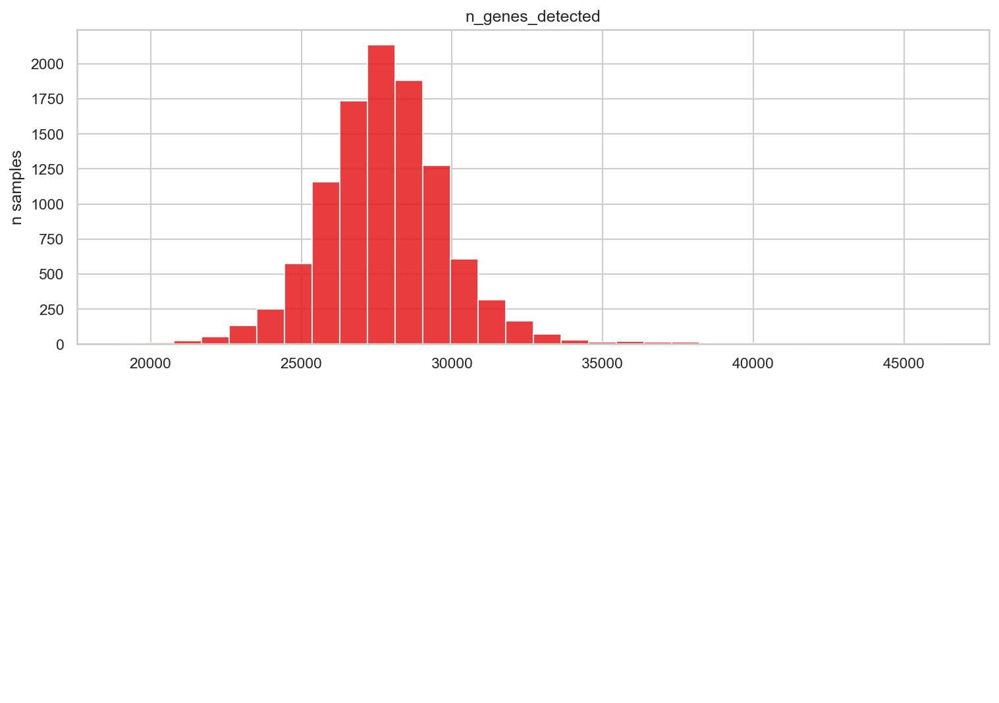

In [22]:
#If you only computed n_genes_detected
bk.pl.qc_metrics(
    adata,
    color="n_genes_detected",
    vars_to_plot=("n_genes_detected",)
);

### Filter out poor quality samples or genes

In [23]:
adata.obs[["n_genes_detected"]].describe()    #"total_counts", "pct_counts_mt"

,n_genes_detected
count,10534.000000
mean,27842.602810
std,2224.427676
min,18937.000000
25%,26529.000000
50%,27771.000000
75%,28991.750000
max,46458.000000


Filter out poor samples or genes
- If counts: use `layer="counts"`
- If normalized, `use layer="cpm"`
- If log-transformed, use `layer="log1p_cpm"`

In [53]:
# keep genes expressed in a minumum of X samples and with expression above a thershol
adata = bk.pp.filter_genes(adata, layer="log1p_cpm", min_samples=10, min_expr=0.1)

INFO: Filtering genes: layer='log1p_cpm', min_expr>0.1, min_samples=10 -> keep 52603/58581


In [54]:
# keep samples with a minimum of genes detected and minimum expression per gene
adata = bk.pp.filter_samples(adata, layer="log1p_cpm", min_genes=15000, expr_threshold_for_genes=0.1)

INFO: Filtering samples -> keep 10534/10535


In [55]:
# 4) Recompute QC after gene filtering (optional but nice)
bk.pp.qc_metrics(adata, layer="log1p_cpm", detection_threshold=0.1)

INFO: QC metrics added to adata.obs (total_counts, n_genes_detected, pct_counts_mt where applicable).


### Normalize (skip is already normalized)

	•	layers["counts"] = raw integer counts
	•	layers["cpm"] = normalized
	•	layers["log1p_cpm"] = for PCA/plotting

### Log-transform (skip is already normalized and log-transformed)

# 4. PCA and bidimensional representation
<a id="pca"></a>

In [25]:
# Chack metadata columns
adata.obs.columns

Index(['Patient_ID', 'Project_ID', 'gender', 'race',
       'ajcc_pathologic_tumor_stage', 'clinical_stage', 'histological_type',
       'histological_grade', 'initial_pathologic_dx_year', 'menopause_status',
       ...
       'MYC_mut', 'MYCL_mut', 'MYCN_mut', 'SOX2_mut', 'ASCL1_mut',
       'NEUROD1_mut', 'POU2F3_mut', 'YAP1_mut', 'NE25_score', 'pct_counts_mt'],
      dtype='object', length=1116)

In [58]:
# IF necessary, ensure data are categories
adata.obs["Project_ID"] = adata.obs["Project_ID"].astype("category")     # or "int" or "float"

<Axes: xlabel='Project_ID'>

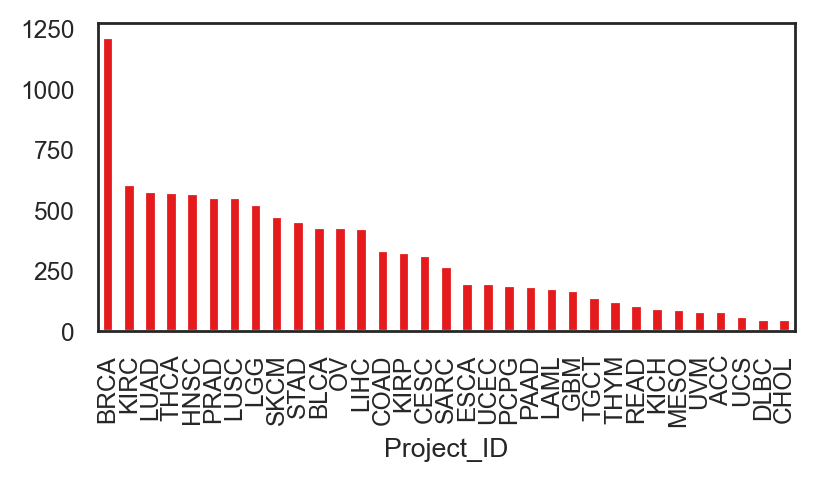

In [22]:
fig, ax = plt.subplots(figsize=(4.5,2), dpi=200)
adata.obs["Project_ID"].value_counts().plot(kind="bar")

## 4.1. Highly-variable genes & PCA

In [27]:
bk.pp.highly_variable_genes(adata, layer="log1p_cpm", n_top_genes=2000)
adata.var["highly_variable"].sum()

INFO: Computing HVGs from layer='log1p_cpm' with n_top_genes=2000
INFO: Marked 2000 highly variable genes in adata.var['highly_variable']


2000

If you ever see HVGs dominated by:
	•	mitochondrial genes
	•	ribosomal genes

you may want to exclude them before HVG selection:

- `mask = ~adata.var_names.str.startswith(("MT-", "RPS", "RPL"))`  
- `adata_hvg = adata[:, mask].copy()`  
- `bk.pp.highly_variable_genes(adata_hvg, ...)`
  


In [28]:
# Compute PCA
bk.tl.pca(adata, layer="log1p_cpm", n_comps=20, 
         use_highly_variable=True,)                              # typically better to use only highly-variable genes

INFO: Running PCA on matrix 10534 samples × 2000 genes; n_comps=20
INFO: PCA stored in adata.obsm['X_pca'], adata.varm['PCs'], adata.uns['pca']


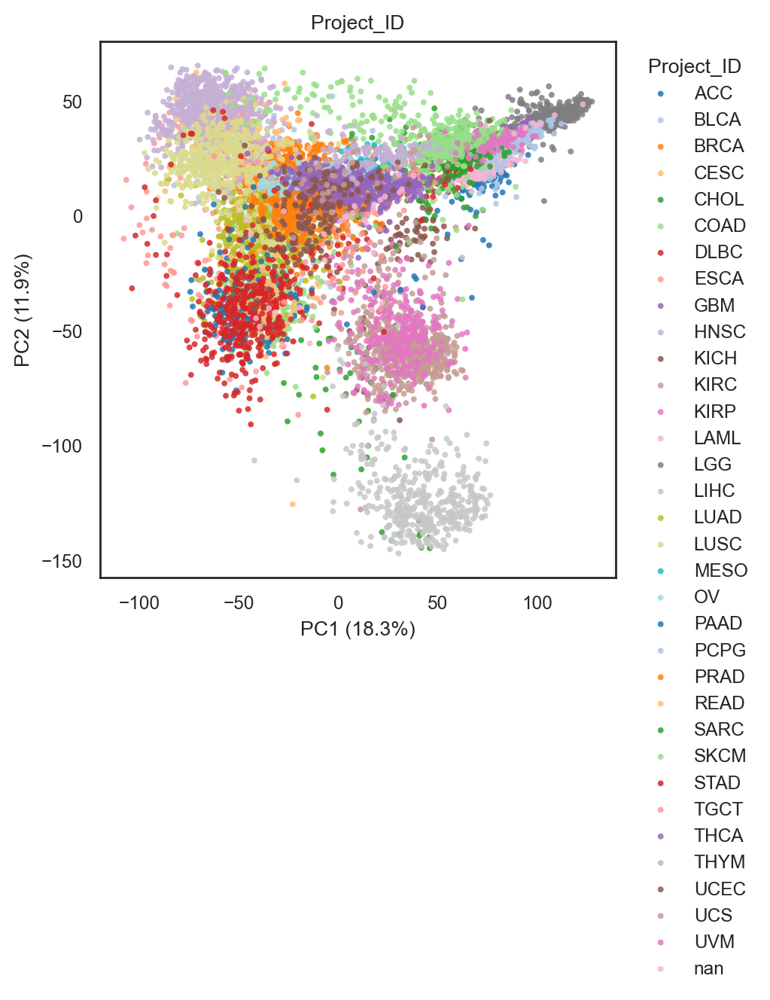

(<Figure size 1000x1200 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [20]:
bk.pl.pca_scatter(adata, color="Project_ID", palette="tab20", figsize=(5,6), point_size=8)

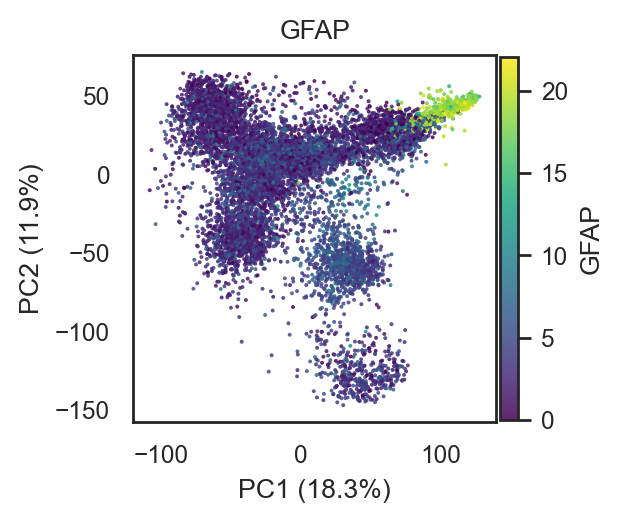

(<Figure size 600x500 with 2 Axes>,
 [<Axes: title={'center': 'GFAP'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [29]:
bk.pl.pca_scatter(adata, color="GFAP", layer="log1p_cpm", cmap="viridis", point_size=2, figsize=(3,2.5))

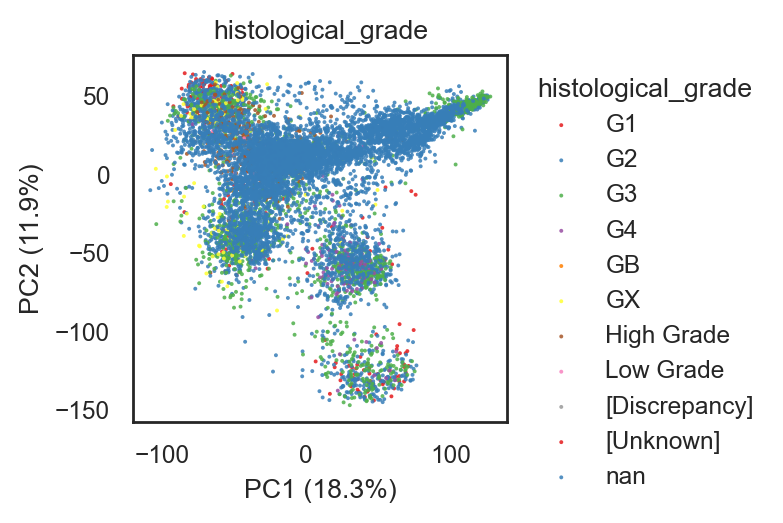

(<Figure size 760x500 with 1 Axes>,
 [<Axes: title={'center': 'histological_grade'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [10]:
bk.pl.pca_scatter(adata, color="histological_grade", point_size=2, figsize=(3.8,2.5))

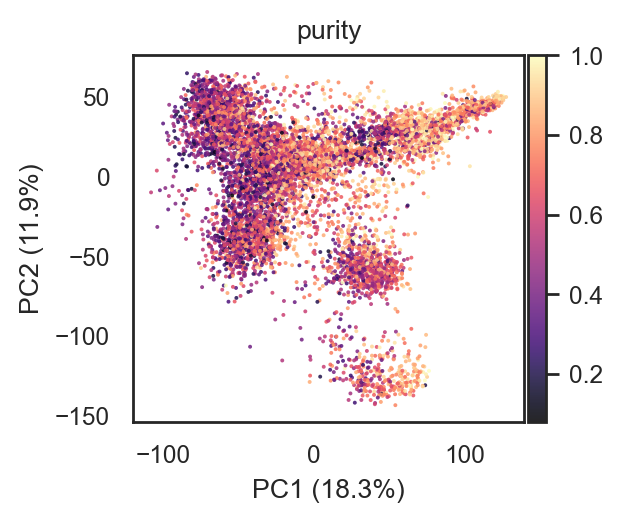

(<Figure size 600x500 with 2 Axes>,
 [<Axes: title={'center': 'purity'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [52]:
bk.pl.pca_scatter(adata, color="purity", point_size=2, figsize=(3,2.5), cmap="magma")

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


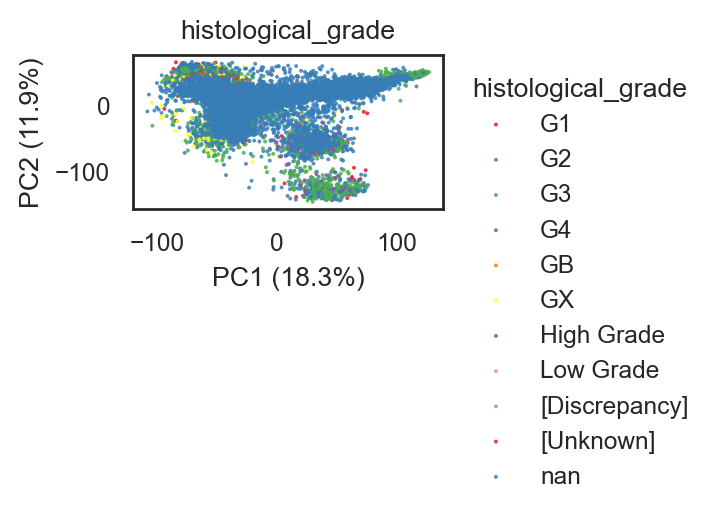

(<Figure size 400x200 with 1 Axes>,
 [<Axes: title={'center': 'histological_grade'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [41]:
bk.pl.pca_scatter(adata, color="histological_grade", point_size=2, figsize=(2,1))

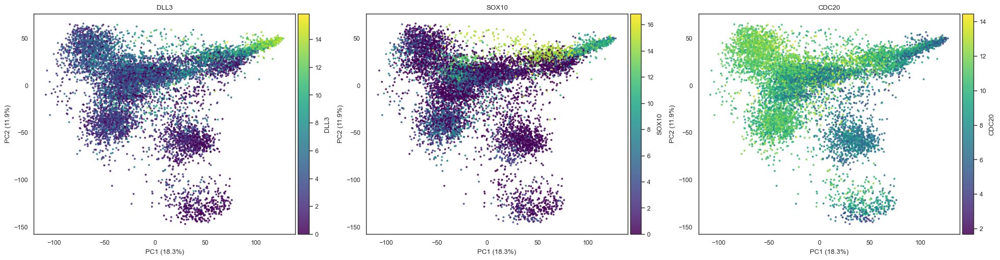

(<Figure size 1950x500 with 6 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'SOX10'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [66]:
bk.pl.pca_scatter(adata, color=["DLL3","SOX10","CDC20"], layer="log1p_cpm", point_size=8)

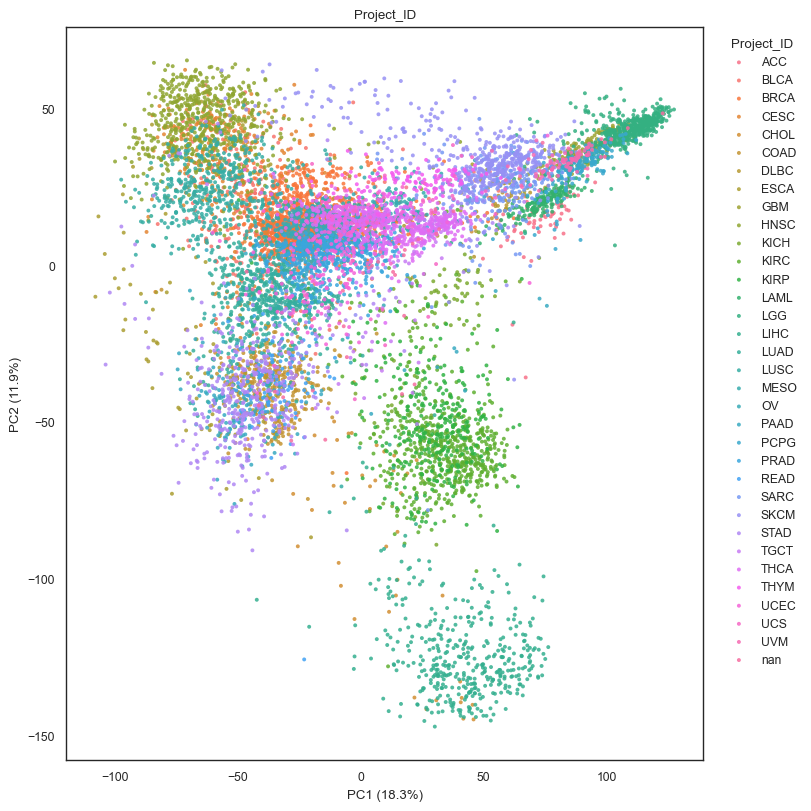

(<Figure size 800x800 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [67]:
# 5) Lots of categories (e.g. 34) → use husl explicitly if you want

bk.pl.pca_scatter(adata, color="Project_ID", palette="husl", 
                  figsize=(8,8),
                  point_size=8)

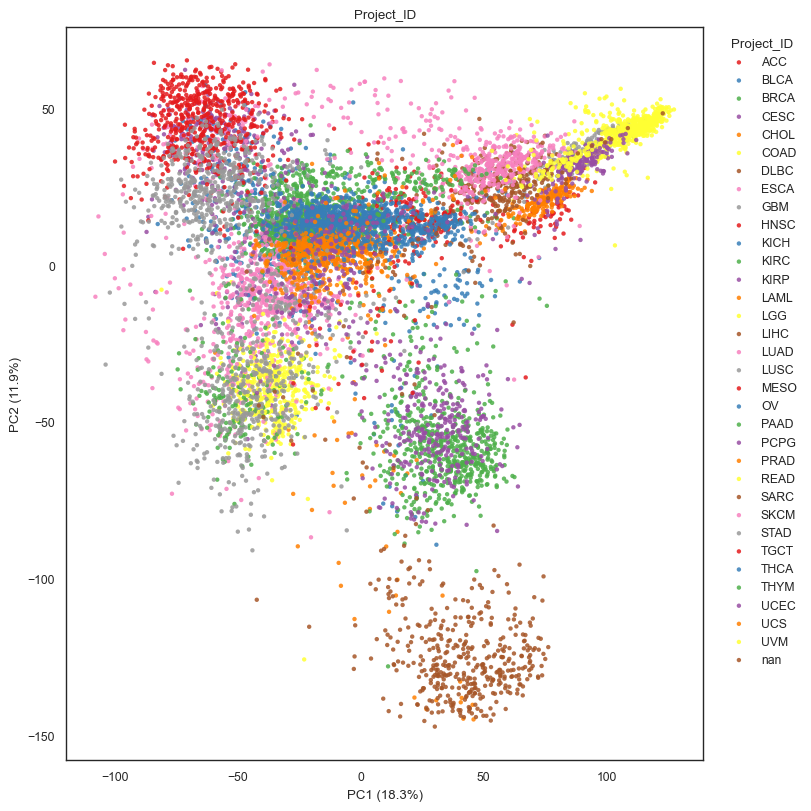

(<Figure size 800x800 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [68]:
#OLD
bk.pl.pca_scatter(adata, color="Project_ID", 
                  figsize=(8,8),
                  point_size=10,
                 )                              # save="pca_by_subtype.png"

### PCA Variance

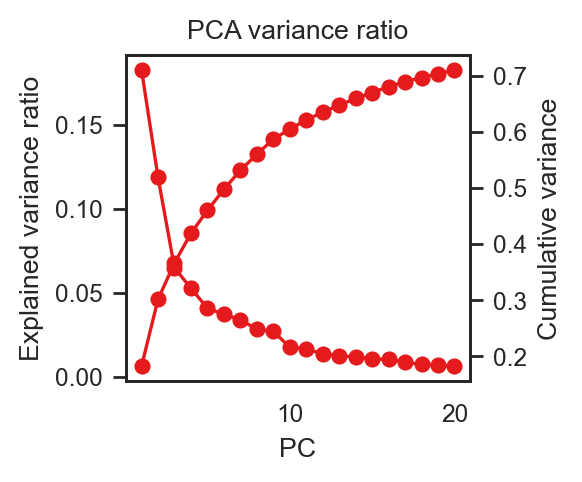

(<Figure size 600x500 with 2 Axes>,
 <Axes: title={'center': 'PCA variance ratio'}, xlabel='PC', ylabel='Explained variance ratio'>)

In [17]:
# 4) scree
bk.pl.pca_variance_ratio(adata, 
                         figsize=(3, 2.5),
                         #save="figs/pca_scree.png"
                        )


#If you ever call PCA with key_added="pca_hvg", then:
bk.pl.pca_variance_ratio(adata, key="pca_hvg")

## 4.2. PCA loadings

In [71]:
bk.tl.pca_loadings(adata, pcs=[1,2], n_top=10)

{'PC1_pos':         pc sign  rank       gene   loading
 50860  PC1  pos     1       BCAN  0.050191
 1837   PC1  pos     2     POU3F3  0.048378
 33110  PC1  pos     3       GFAP  0.046873
 28995  PC1  pos     4       PLP1  0.042937
 33065  PC1  pos     5      OLIG1  0.042259
 29112  PC1  pos     6  LINC01158  0.041495
 796    PC1  pos     7       BEX1  0.039875
 12805  PC1  pos     8     CTNNA2  0.038589
 11976  PC1  pos     9     ETNPPL  0.037962
 37756  PC1  pos    10       SCG3  0.037738,
 'PC1_neg':         pc sign  rank      gene   loading
 50438  PC1  neg     1   CEACAM6 -0.086779
 8052   PC1  neg     2     KRT6A -0.084907
 50435  PC1  neg     3   CEACAM5 -0.083953
 16858  PC1  neg     4      AGR2 -0.081556
 2256   PC1  neg     5  SERPINB5 -0.080948
 50128  PC1  neg     6   TMPRSS4 -0.079735
 15716  PC1  neg     7     KRT15 -0.077447
 29857  PC1  neg     8     RAB25 -0.076824
 14572  PC1  neg     9      KRT5 -0.076631
 15715  PC1  neg    10     KRT16 -0.075571,
 'PC2_pos':        

In [72]:
#Export
bk.tl.pca_loadings(
    adata,
    pcs=[1,2,3,4,5],
    n_top=100,
    export="results/TCGA_pca_loadings.tsv",
    export_gmt="results/TCGA_pca_loadings.gmt",
)

INFO: pca_loadings: exported results/TCGA_pca_loadings.tsv and results/TCGA_pca_loadings.wide.tsv
INFO: pca_loadings: exported GMT to results/TCGA_pca_loadings.gmt


{'PC1_pos':         pc sign  rank     gene   loading
 50860  PC1  pos     1     BCAN  0.050191
 1837   PC1  pos     2   POU3F3  0.048378
 33110  PC1  pos     3     GFAP  0.046873
 28995  PC1  pos     4     PLP1  0.042937
 33065  PC1  pos     5    OLIG1  0.042259
 ...    ...  ...   ...      ...       ...
 20633  PC1  pos    96   GABRG2  0.020344
 25643  PC1  pos    97  SLC22A7  0.020339
 21811  PC1  pos    98   ACSM2B  0.020221
 41790  PC1  pos    99   NKX2-2  0.020165
 33493  PC1  pos   100    KCNJ3  0.020014
 
 [100 rows x 5 columns],
 'PC1_neg':         pc sign  rank      gene   loading
 50438  PC1  neg     1   CEACAM6 -0.086779
 8052   PC1  neg     2     KRT6A -0.084907
 50435  PC1  neg     3   CEACAM5 -0.083953
 16858  PC1  neg     4      AGR2 -0.081556
 2256   PC1  neg     5  SERPINB5 -0.080948
 ...    ...  ...   ...       ...       ...
 46401  PC1  neg    96     ESRP2 -0.050246
 28140  PC1  neg    97    S100A2 -0.049962
 18737  PC1  neg    98   ANXA8L1 -0.049845
 24337  PC1  neg 

In [73]:
#Absolute loadings only (single list per PC)
bk.tl.pca_loadings(adata, pcs=[1,2,3], n_top=100, use_abs=True)

{'PC1_abs':         pc sign  rank      gene   loading
 50438  PC1  abs     1   CEACAM6 -0.086779
 8052   PC1  abs     2     KRT6A -0.084907
 50435  PC1  abs     3   CEACAM5 -0.083953
 16858  PC1  abs     4      AGR2 -0.081556
 2256   PC1  abs     5  SERPINB5 -0.080948
 ...    ...  ...   ...       ...       ...
 46401  PC1  abs    96     ESRP2 -0.050246
 50860  PC1  abs    97      BCAN  0.050191
 28140  PC1  abs    98    S100A2 -0.049962
 18737  PC1  abs    99   ANXA8L1 -0.049845
 24337  PC1  abs   100     IGHA2 -0.049593
 
 [100 rows x 5 columns],
 'PC2_abs':         pc sign  rank     gene   loading
 40168  PC2  abs     1    HNF4A -0.099591
 11245  PC2  abs     2    CDHR5 -0.089164
 52362  PC2  abs     3    ALDOB -0.088794
 20467  PC2  abs     4     A1CF -0.087727
 6005   PC2  abs     5      FGA -0.085978
 ...    ...  ...   ...      ...       ...
 5772   PC2  abs    96   CYP3A5 -0.055155
 10653  PC2  abs    97  UGT2B15 -0.055070
 15896  PC2  abs    98   UGT3A1 -0.055053
 32526  PC2  ab

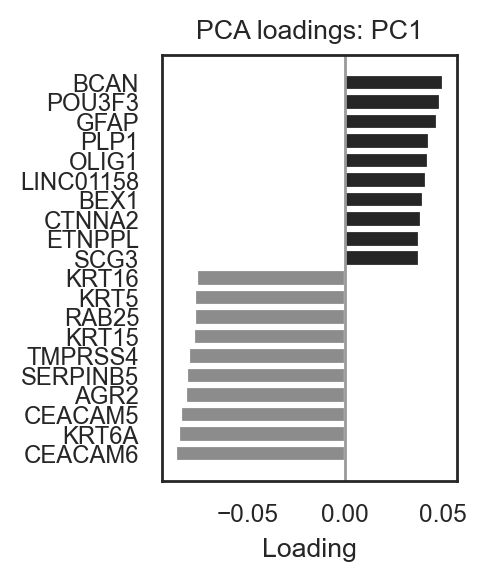

(<Figure size 500x600 with 1 Axes>,
 <Axes: title={'center': 'PCA loadings: PC1'}, xlabel='Loading'>)

In [14]:
# Barplot for PC1 (top pos/neg)
bk.pl.pca_loadings_bar(adata, pc=1, n_top=10, figsize=(2.5,3))   #save="figs/pc1_loadings_bar.png"

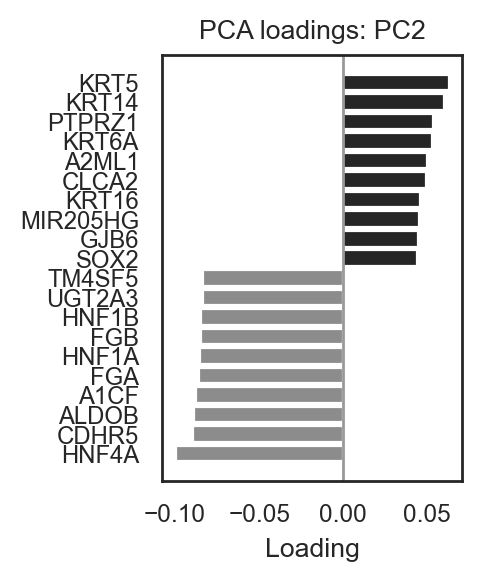

(<Figure size 500x600 with 1 Axes>,
 <Axes: title={'center': 'PCA loadings: PC2'}, xlabel='Loading'>)

In [15]:
# Barplot for PC2 (top pos/neg)
bk.pl.pca_loadings_bar(adata, pc=2, n_top=10, figsize=(2.5,3))   #save="figs/pc1_loadings_bar.png"

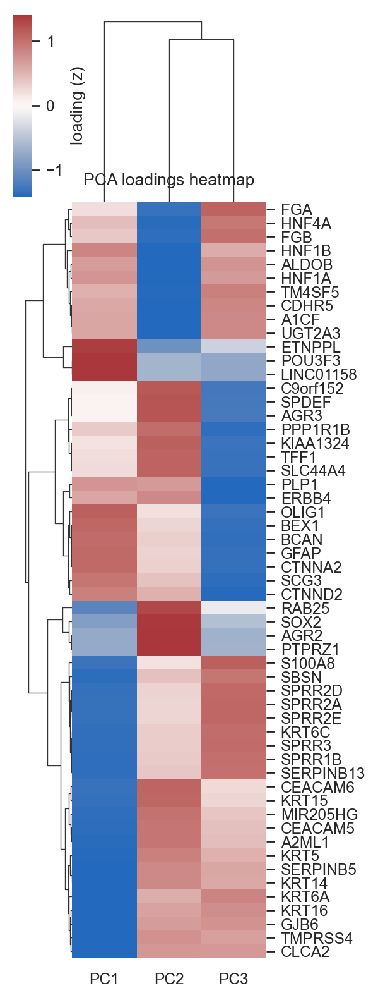

In [11]:
# Heatmap for PC1–PC5 (union of top genes)
bk.pl.pca_loadings_heatmap(
    adata,
    pcs=[1,2,3],
    n_top=10,
    cluster_genes=True,
    cluster_pcs=True,
    z_score=True,
    figsize=(3,8),
    #save="figs/pca_loadings_heatmap_TCGAall.png",
);

## 4.3. Neighbors & UMAP

Common bulk-friendly parameter ranges
	•	n_neighbors: 10–30 (for ~100 samples, 15 is a good start)
	•	resolution:
	•	0.3–0.8 for broader groups
	•	1.0–2.0 for finer subclusters

In [78]:
# Calculate neighbors - PCA should be already computed
bk.tl.neighbors(adata, n_neighbors=15, n_pcs=20, metric="euclidean")

INFO: Computing neighbors: k=15, rep=X_pca, n_pcs=20, metric=euclidean
INFO: Stored neighbors graph in adata.obsp['distances'] and adata.obsp['connectivities'].


In [79]:
bk.tl.umap(adata, n_neighbors=8, n_pcs=30, min_dist=0.3, random_state=0)    #0.3

INFO: Running UMAP (rep=X_pca, n_pcs=20, n_neighbors=8, min_dist=0.3, n_components=2)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


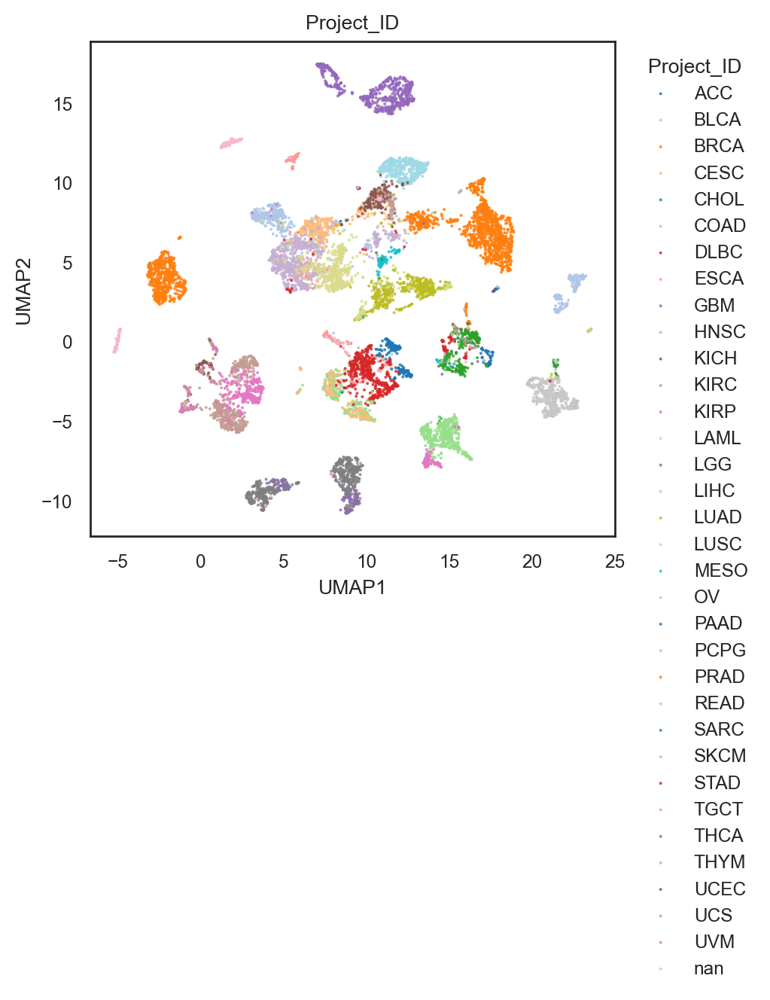

(<Figure size 1000x1180 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [57]:
# categorical (legend)
bk.pl.umap(adata, color="Project_ID", 
           figsize=(5,5.9),
           point_size=2, palette="tab20")

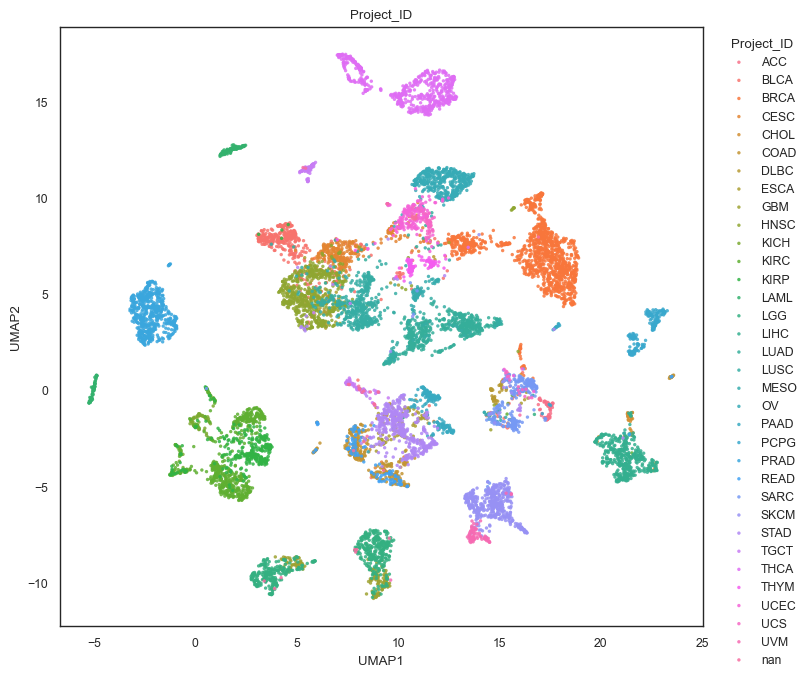

(<Figure size 800x700 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [81]:
# many categories → avoid repetition
bk.pl.umap(adata, color="Project_ID", palette="husl", 
           figsize=(8,7),
           point_size=6)

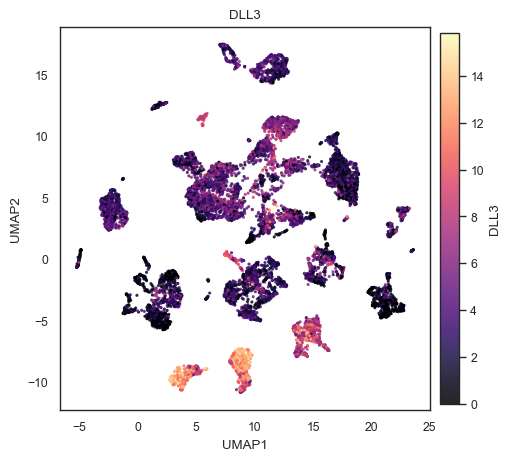

(<Figure size 500x450 with 2 Axes>,
 [<Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [85]:
# gene expression (continuous, from a layer)
bk.pl.umap(adata, color="DLL3", layer="log1p_cpm", figsize=(5,4.5), point_size=5)   #cmap="magma"

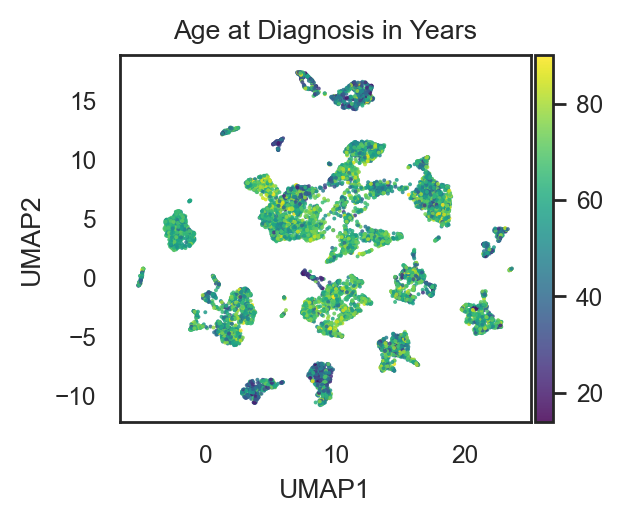

(<Figure size 600x500 with 2 Axes>,
 [<Axes: title={'center': 'Age at Diagnosis in Years'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [62]:
# continuous metadata
bk.pl.umap(adata, color="Age at Diagnosis in Years", 
           figsize=(3,2.5), point_size=2, 
           cmap="viridis")


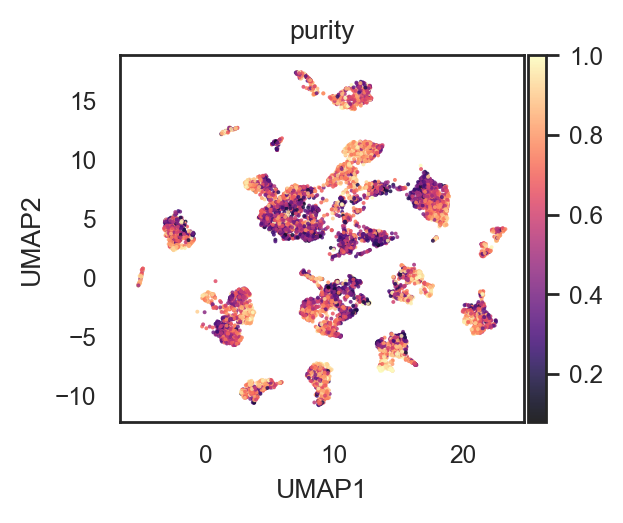

(<Figure size 600x500 with 2 Axes>,
 [<Axes: title={'center': 'purity'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [83]:
# continuous metadata
bk.pl.umap(adata, color="purity", 
           figsize=(3,2.5), point_size=2, 
           cmap="magma")

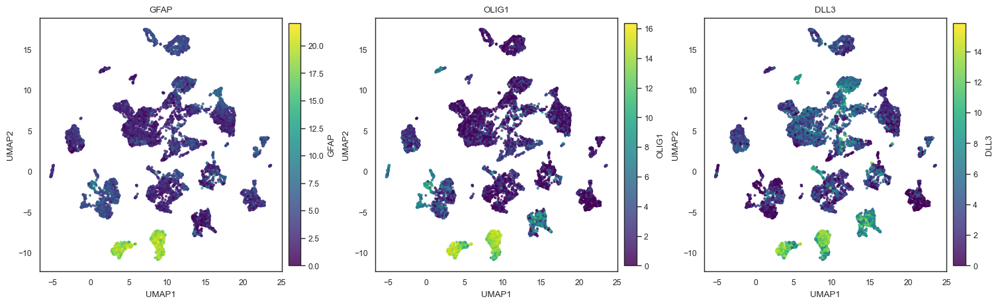

(<Figure size 1500x450 with 6 Axes>,
 array([<Axes: title={'center': 'GFAP'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'OLIG1'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [90]:
# multiple genes → 1 row of panels
bk.pl.umap(adata, color=["GFAP", "OLIG1", "DLL3"], layer="log1p_cpm", 
           figsize=(5,4.5),
           point_size=8, cmap="viridis")

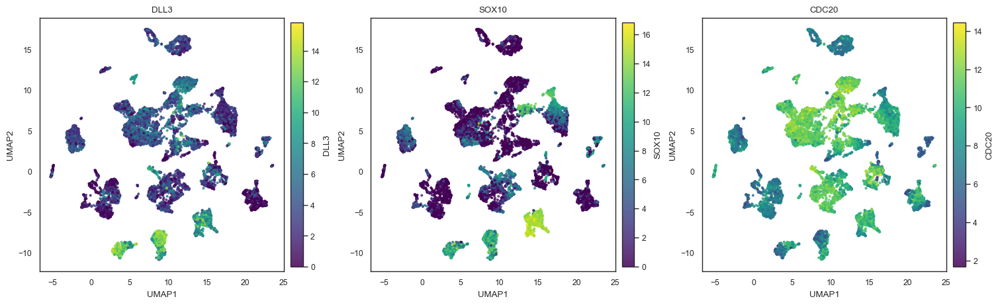

(<Figure size 1500x450 with 6 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'SOX10'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [91]:
# multiple genes → 1 row of panels
bk.pl.umap(adata, color=["DLL3", "SOX10", "CDC20"], layer="log1p_cpm", 
           figsize=(5,4.5),
           point_size=8, cmap="viridis")

### Compare umap & umap_graph:  
- umap: regular, representation-driven, standard
- umap_graph: “Graph-enforced UMAP reveals subtype separation”, topology-preserving, exploratory

Original:  
- min_dist=0.3,
- random_state=0,

In [73]:
bk.tl.umap_graph(
    adata,
    graph_key="connectivities",
    min_dist=0.5,
    random_state=0,
)

INFO: Running graph-based UMAP (graph=connectivities, init=spectral, n_pcs=20, min_dist=0.5, n_components=2)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


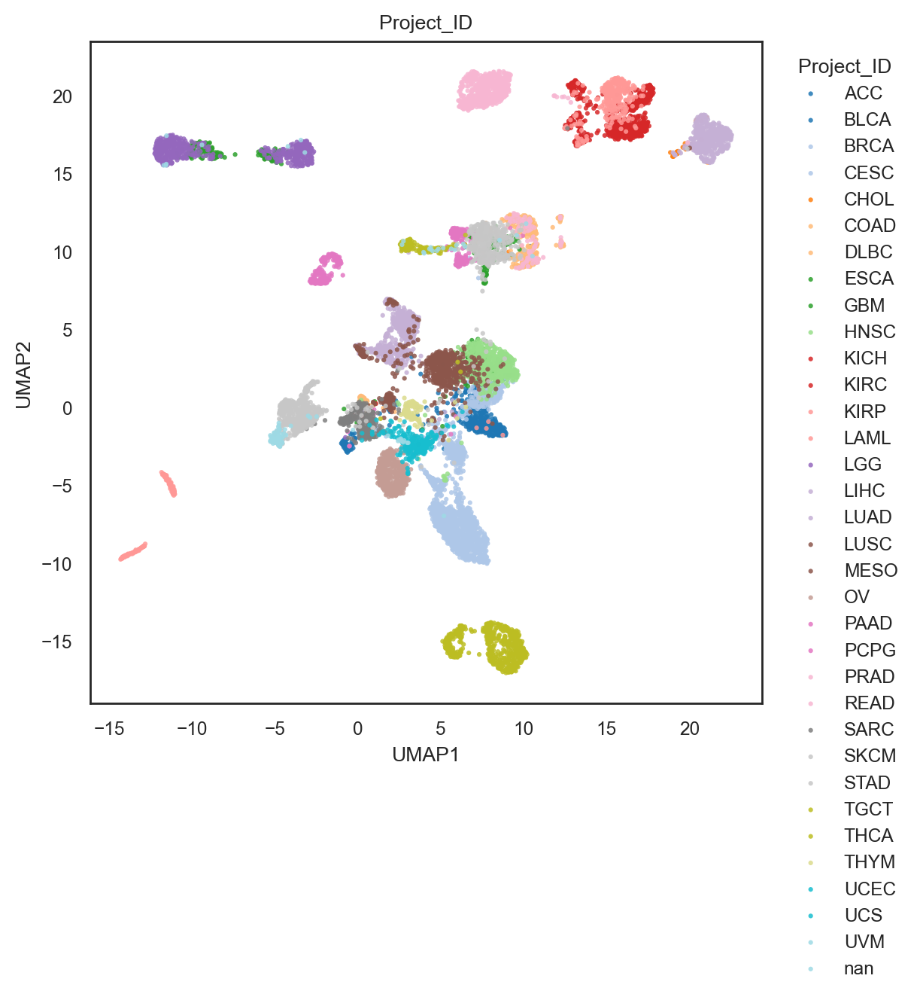

(<Figure size 1200x1260 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [97]:
bk.pl.umap(adata, basis="X_umap_graph", color="Project_ID", figsize=(6,6.3), point_size=5, palette="Set20") 

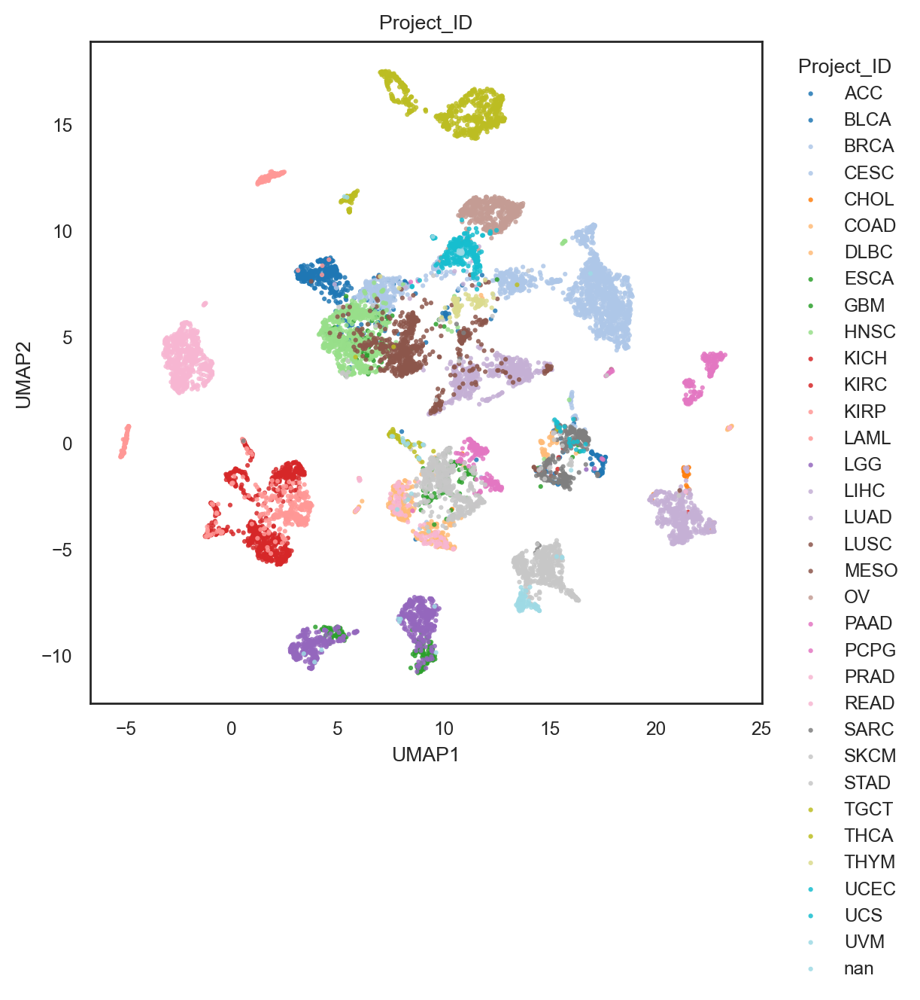

(<Figure size 1200x1260 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [82]:
bk.pl.umap(adata, basis="X_umap", color="Project_ID", figsize=(6,6.3), point_size=5, palette="Set20") 

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


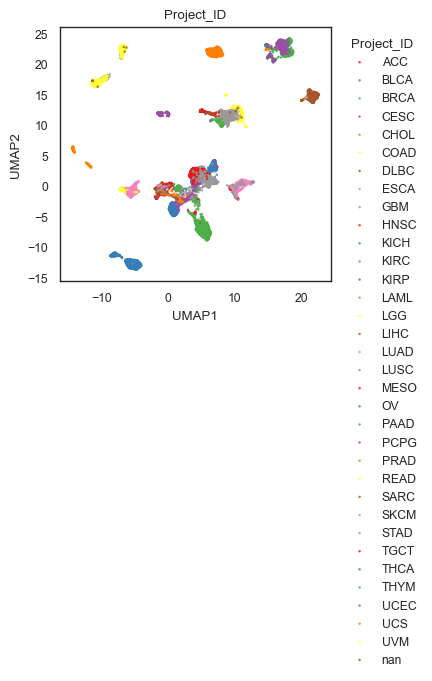

(<Figure size 350x330 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [101]:
bk.pl.umap(adata, basis="X_umap_graph", color="Project_ID", figsize=(3.5,3.3), point_size=3) 

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


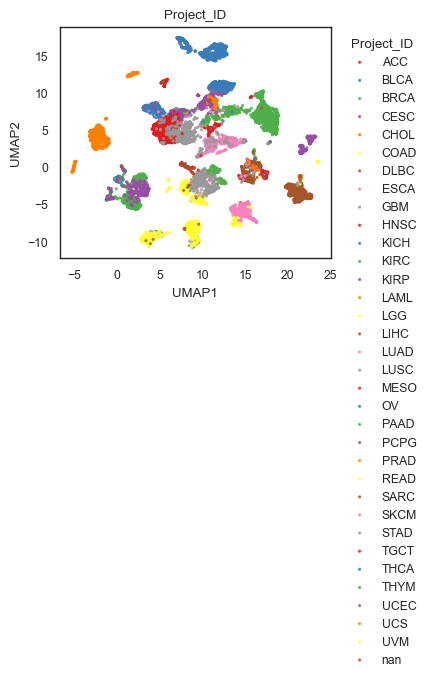

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


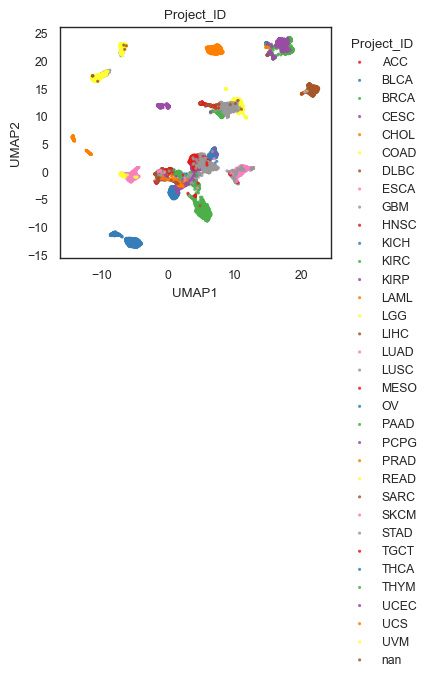

(<Figure size 350x300 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [95]:
bk.pl.umap(adata, basis="X_umap", color="Project_ID", figsize=(3.5,3), point_size=5)      #save="umap_standard.png"
bk.pl.umap(adata, basis="X_umap_graph", color="Project_ID", figsize=(3.5,3), point_size=5)   #save="umap_graph.png"

# 5. Clustering and define groups <a id="clusters"></a> 

Basic procedure: PCA → 2) neighbors graph on PCs → 3) Leiden (scan resolution)   
- Use `method=leiden` for computational of clusters. `resolution`: Higher resolution → more clusters // Lower resolution → fewer clusters. Leiden requires a graph, so run after `bk.tl.neighbors` (already computed for UMAP)  
- Use K-means when you want direct control over the number of clusters or a quick baseline.   
Try Leiden; if not installed it will fallback to kmeans automatically  


## 5.1. Leiden  
For complex structure and unknown number of clusters

In [85]:
# Initial test if true groups already known. Scan many Leiden resolutions
df = bk.tl.leiden_resolution_scan(
    adata,
    true_key="Project_ID",                                          # Biological true groups                    
    resolutions=[0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.5, 2.0],
    base_key="leiden",
    use_rep="X_pca",
    n_pcs=20,
    n_neighbors=15,
)
df

INFO: Leiden resolution=0.2
INFO: Clustering with Leiden (resolution=0.2)
INFO: Leiden produced 16 clusters stored in adata.obs['leiden_0.2'].
INFO: Leiden resolution=0.4
INFO: Clustering with Leiden (resolution=0.4)
INFO: Leiden produced 21 clusters stored in adata.obs['leiden_0.4'].
INFO: Leiden resolution=0.6
INFO: Clustering with Leiden (resolution=0.6)
INFO: Leiden produced 23 clusters stored in adata.obs['leiden_0.6'].
INFO: Leiden resolution=0.8
INFO: Clustering with Leiden (resolution=0.8)
INFO: Leiden produced 25 clusters stored in adata.obs['leiden_0.8'].
INFO: Leiden resolution=1
INFO: Clustering with Leiden (resolution=1.0)
INFO: Leiden produced 27 clusters stored in adata.obs['leiden_1'].
INFO: Leiden resolution=1.2
INFO: Clustering with Leiden (resolution=1.2)
INFO: Leiden produced 30 clusters stored in adata.obs['leiden_1.2'].
INFO: Leiden resolution=1.5
INFO: Clustering with Leiden (resolution=1.5)
INFO: Leiden produced 33 clusters stored in adata.obs['leiden_1.5'].
INF

,resolution,key,n_clusters,ARI,NMI,cramers_v,n_used,n_missing
0,0.2,leiden_0.2,16,0.550043,0.788988,0.889240,10495,39
1,0.4,leiden_0.4,21,0.527337,0.783418,0.802683,10495,39
2,0.6,leiden_0.6,23,0.578785,0.801896,0.810116,10495,39
3,0.8,leiden_0.8,25,0.605164,0.812923,0.806741,10495,39
4,1.0,leiden_1,27,0.630577,0.811779,0.796994,10495,39
5,1.2,leiden_1.2,30,0.637650,0.812469,0.769847,10495,39
6,1.5,leiden_1.5,33,0.654320,0.812014,0.752093,10495,39
7,2.0,leiden_2,37,0.670129,0.823322,0.807237,10495,39


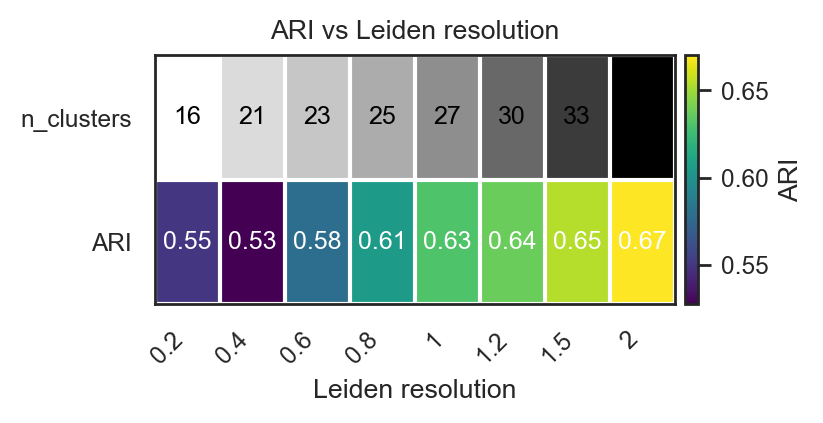

(<Figure size 800x400 with 2 Axes>,
 <Axes: title={'center': 'ARI vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [88]:
# Heatmap of ARI vs resolution in the previous calculations
bk.pl.ari_resolution_heatmap(
    adata,
    df=df,
    metric="ARI",
    show_n_clusters=True,
    figsize=(4,2)
    #save="figs/ari_vs_resolution.png",
)

In [96]:
# A single calculation with a specific resolution
bk.tl.cluster(adata, method="leiden", key_added="leiden_2.2", resolution=2.2)

INFO: Clustering with Leiden (resolution=2.2)
INFO: Leiden produced 39 clusters stored in adata.obs['leiden_2.2'].


In [90]:
# Ensure data are taken as categorical, not numeric
adata.obs["leiden_2.2"] = adata.obs["leiden_2.2"].astype("category")

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


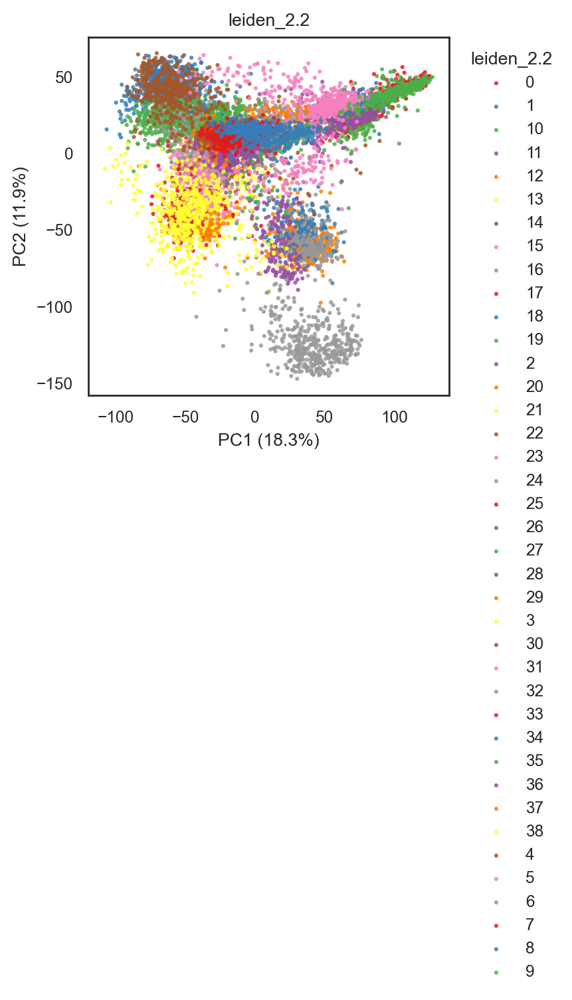

(<Figure size 700x700 with 1 Axes>,
 [<Axes: title={'center': 'leiden_2.2'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [95]:
bk.pl.pca_scatter(adata, color="leiden_2.2", 
                  figsize=(3.5,3.5),                           # figsize=(3.5,3.5)                         
                  point_size=5)    #save="pca_clusters.png"

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


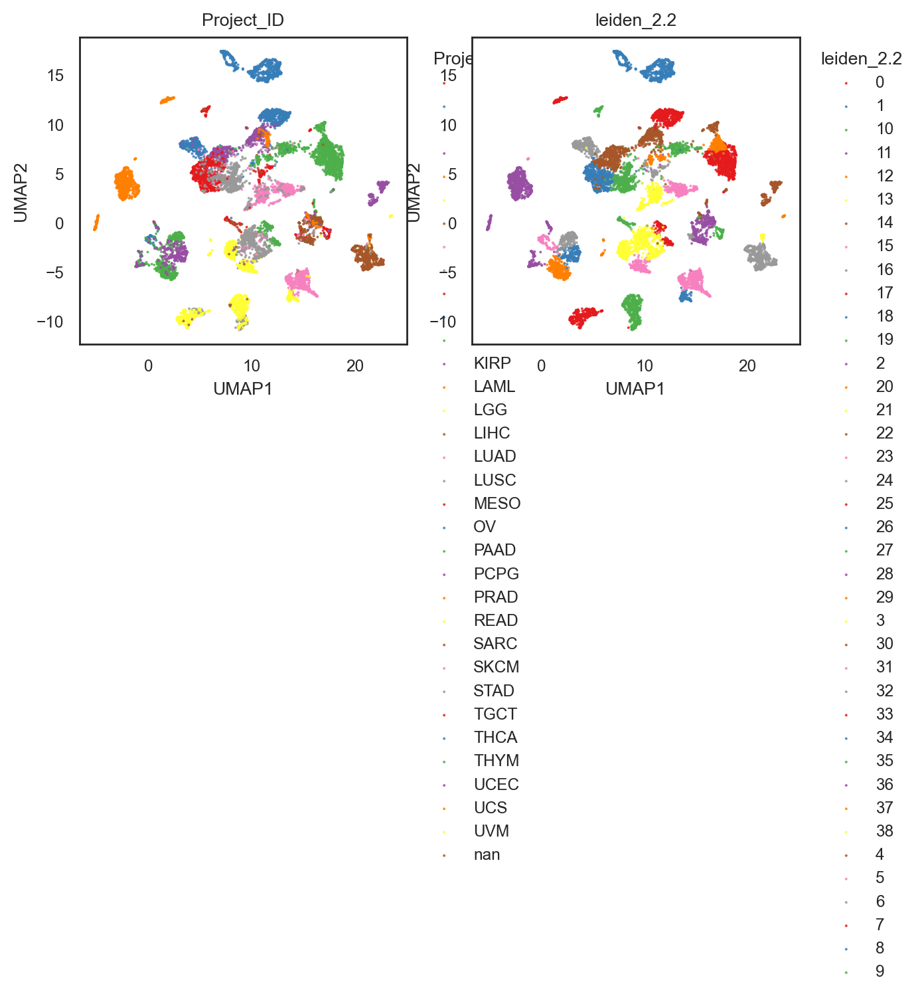

(<Figure size 1400x600 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'leiden_2.2'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [99]:
bk.pl.umap(adata, color=["Project_ID", "leiden_2.2"], 
                  figsize=(3.5,3),
                  point_size=2)    #save="pca_clusters.png"

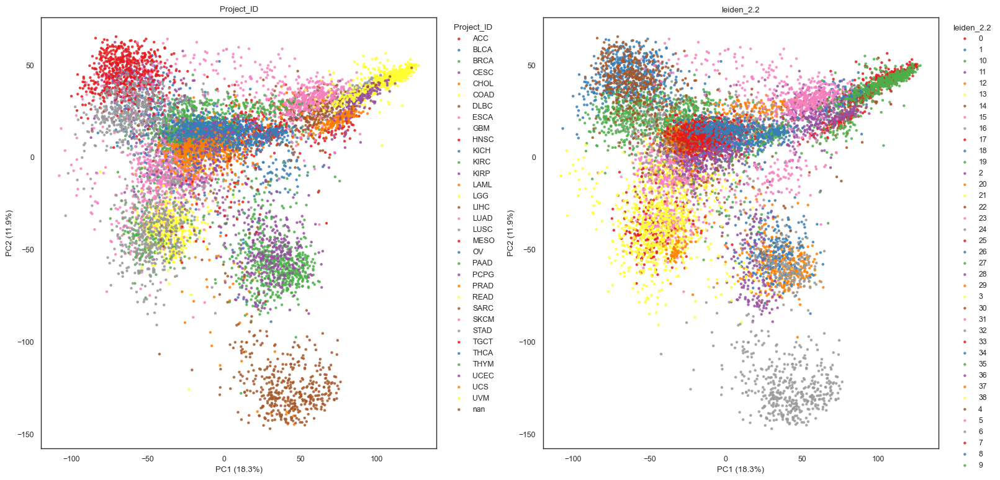

(<Figure size 1600x800 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'leiden_2.2'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [99]:
bk.pl.pca_scatter(adata, color=["Project_ID", "leiden_2.2"],  
                 figsize=(8,8),
                 point_size=10)   #save="pca_leiden.png"


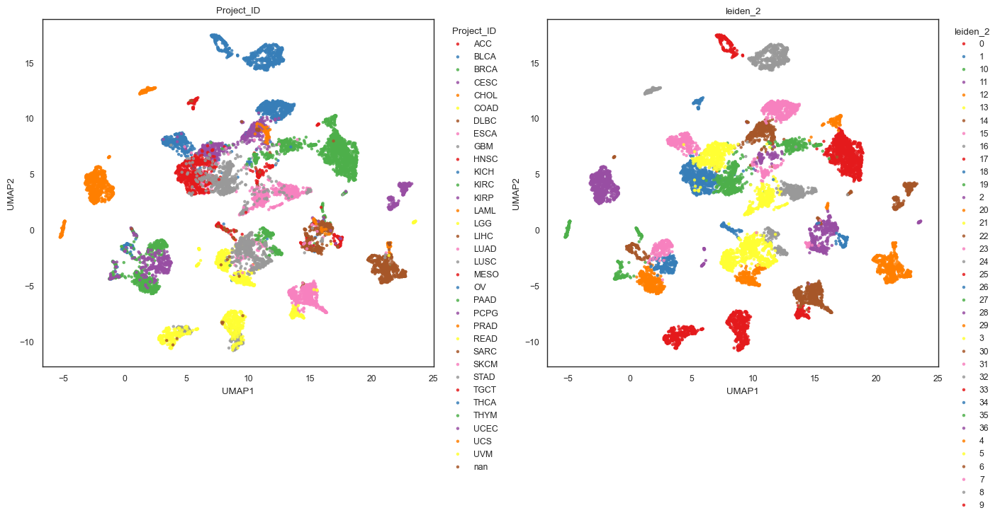

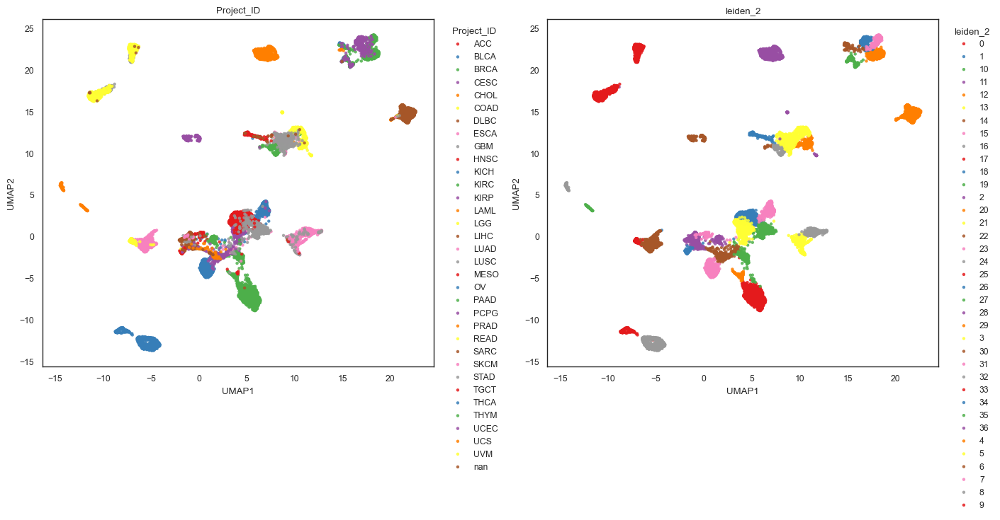

(<Figure size 1400x700 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'leiden_2'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [100]:
bk.pl.umap(adata, basis="X_umap", color=["Project_ID", "leiden_2"], figsize=(7,7), point_size=10)             #save="umap_leiden_standard.png"
bk.pl.umap(adata, basis="X_umap_graph", color=["Project_ID", "leiden_2"], figsize=(7,7), point_size=10)      #save="umap_leiden_standard.png"

In [101]:
# Compare results leiden vs. True biological
pd.crosstab(adata.obs["Project_ID"], adata.obs["leiden_2"])

leiden_2,0,1,10,11,12,13,14,15,16,17,...,33,34,35,36,4,5,6,7,8,9
Project_ID,,,,,,,,,,,,,,,,,,,,,
ACC,0,0,0,2,0,0,0,0,0,0,...,0,74,0,0,0,0,0,0,0,0
BLCA,0,47,5,9,0,2,3,305,0,0,...,0,0,0,0,0,37,0,0,0,0
BRCA,868,0,0,16,0,0,3,0,0,0,...,0,0,0,0,1,7,0,0,0,0
CESC,0,0,0,2,0,0,60,1,0,0,...,0,0,0,0,0,235,0,1,0,0
CHOL,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,41,0,0,0,0,0
COAD,0,0,0,0,0,0,0,0,0,0,...,0,0,0,41,0,0,0,0,0,0
DLBC,0,0,0,44,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
ESCA,0,75,6,2,0,0,1,1,0,0,...,0,0,0,0,0,11,0,0,0,0
GBM,0,0,0,4,0,0,0,0,0,57,...,0,0,0,0,0,0,0,0,0,104


In [104]:
# estimate how good is the correlation - Compute ARI - NMI - cramers_v, silhouette
# ARI: from sklearn.metrics import adjusted_rand_score
# NMI: from sklearn.metrics import normalized_mutual_info_score

# Test1. One clustering vs ground truth (plus silhouette on PCA)
#bk.tl.neighbors(adata, n_neighbors=15, n_pcs=20)  # if not done
#bk.tl.leiden(adata, resolution=1.0)

m = bk.tl.cluster_metrics(
    adata,
    true_key="Project_ID",
    cluster_key="leiden_2",
    use_rep="X_pca",
    n_pcs=20,
)
m

INFO: cluster_metrics: n_used=10495 ari=0.670 nmi=0.823 cramers_v=0.806 silhouette=0.23031431903604613


{'n_used': 10495.0,
 'ari': 0.6701289105340902,
 'nmi': 0.8233217047066449,
 'cramers_v': 0.8063399112300729,
 'silhouette': 0.23031431903604613}

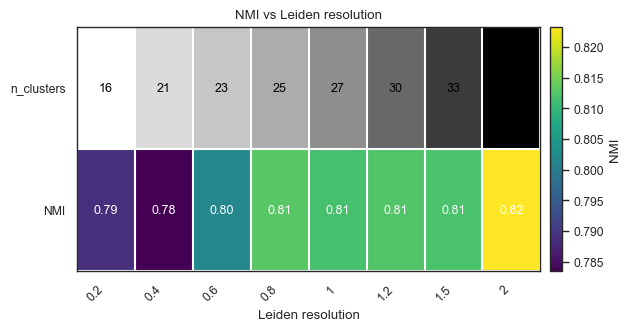

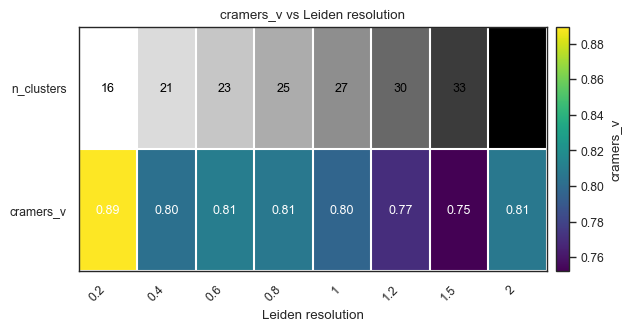

(<Figure size 620x320 with 2 Axes>,
 <Axes: title={'center': 'cramers_v vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [105]:
# Plot results
bk.pl.ari_resolution_heatmap(adata, df=df, metric="NMI")
bk.pl.ari_resolution_heatmap(adata, df=df, metric="cramers_v")
#bk.pl.ari_resolution_heatmap(adata, df=df, metric="silhouette", vmin=None, vmax=None)

## 5.2. K-means  
Fixed number of clusters

In [106]:
# try several k values
for k in [10, 15, 20, 25, 30]:
    bk.tl.cluster(
        adata,
        method="kmeans",
        n_clusters=k,
        use_rep="X_pca",
        n_pcs=20,
        key_added=f"kmeans_{k}",
    )

INFO: Clustering with kmeans (k=10, rep=X_pca, n_pcs=20)
INFO: KMeans produced 10 clusters stored in adata.obs['kmeans_10'].
INFO: Clustering with kmeans (k=15, rep=X_pca, n_pcs=20)
INFO: KMeans produced 15 clusters stored in adata.obs['kmeans_15'].
INFO: Clustering with kmeans (k=20, rep=X_pca, n_pcs=20)
INFO: KMeans produced 20 clusters stored in adata.obs['kmeans_20'].
INFO: Clustering with kmeans (k=25, rep=X_pca, n_pcs=20)
INFO: KMeans produced 25 clusters stored in adata.obs['kmeans_25'].
INFO: Clustering with kmeans (k=30, rep=X_pca, n_pcs=20)
INFO: KMeans produced 30 clusters stored in adata.obs['kmeans_30'].


In [109]:
# evaluate quantitively
bk.tl.cluster_metrics(
    adata,
    cluster_key="kmeans_25",
    true_key="Project_ID",
)

INFO: cluster_metrics: n_used=10495 ari=0.673 nmi=0.799 cramers_v=0.817 silhouette=0.3125603659482761


{'n_used': 10495.0,
 'ari': 0.6732428059451844,
 'nmi': 0.7988848404974632,
 'cramers_v': 0.8170361498370644,
 'silhouette': 0.3125603659482761}

In [110]:
# Calculate for a fixed number of clusters
bk.tl.cluster(
    adata,
    method="kmeans",
    n_clusters=25,
    use_rep="X_pca",
    n_pcs=20,
    key_added="kmeans_25",
    random_state=0,
)

INFO: Clustering with kmeans (k=25, rep=X_pca, n_pcs=20)
INFO: KMeans produced 25 clusters stored in adata.obs['kmeans_25'].


In [101]:
adata.obs["kmeans_25"] = adata.obs["kmeans_25"].astype("category")

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


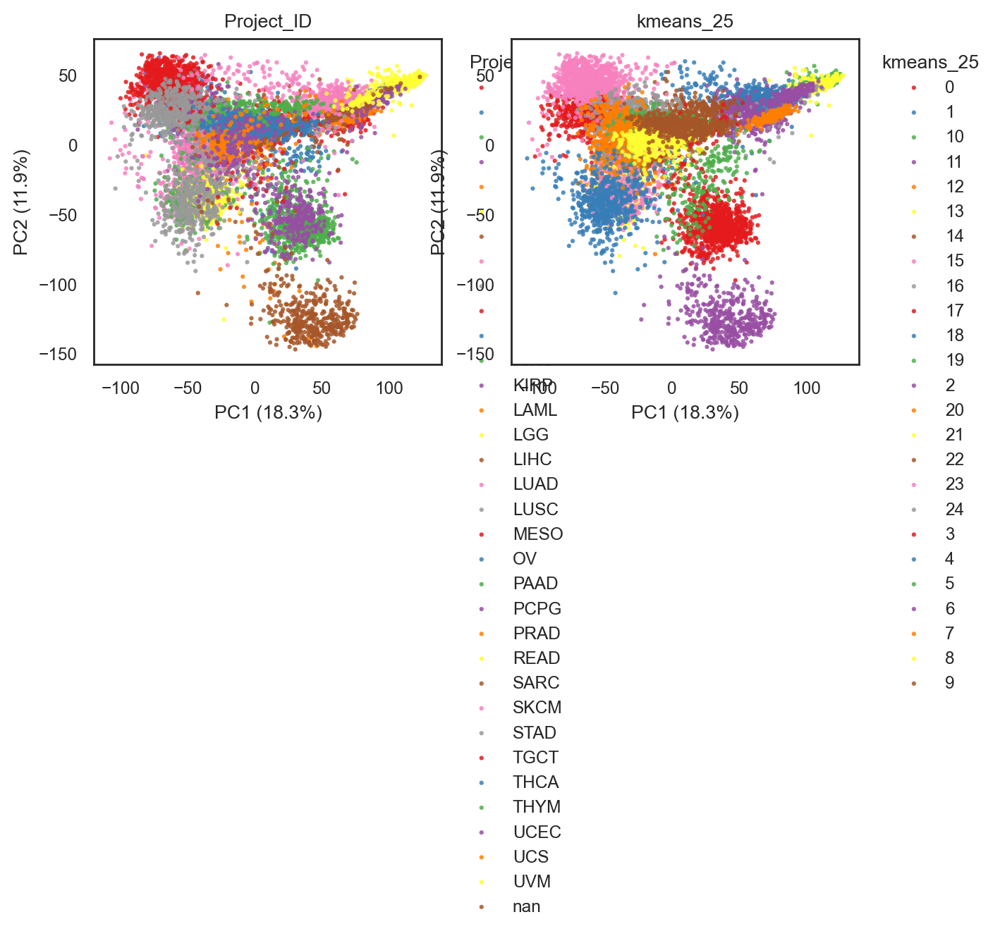

(<Figure size 1400x600 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'kmeans_25'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [102]:
bk.pl.pca_scatter(adata, color=["Project_ID", "kmeans_25"], figsize=(3.5,3), point_size=5)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


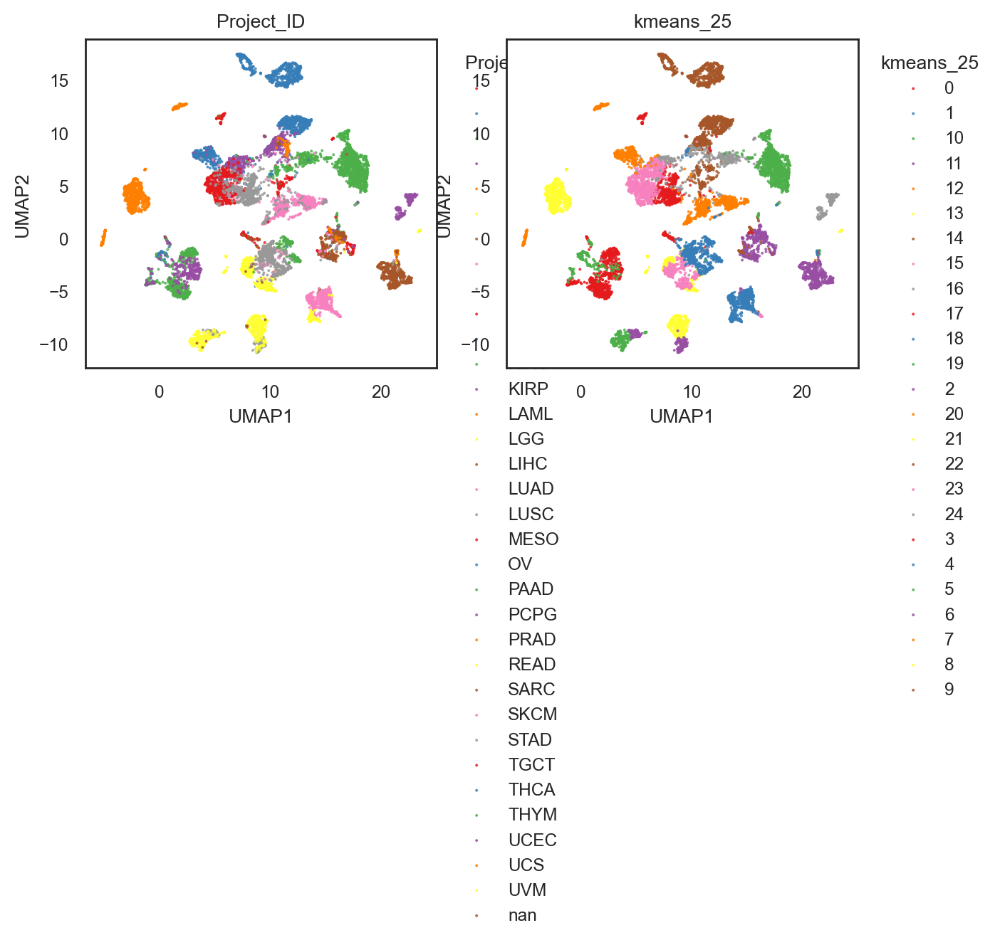

(<Figure size 1400x600 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'kmeans_25'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [104]:
bk.pl.umap(adata, color=["Project_ID", "kmeans_25"], figsize=(3.5,3), point_size=2)

In [ ]:
# save .h5ad file
adata.write("../data/h5ad/260125_BULLKpy_TCGA_RNAseq.h5ad")

# 6. Genes and Gene Signatures
<a id="genes"></a>

## 6.1. Gene plots

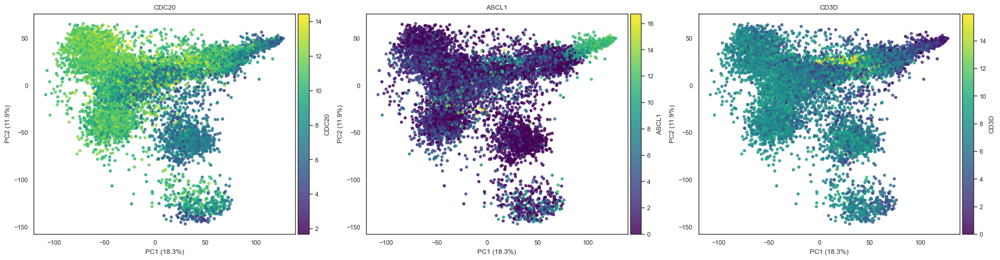

(<Figure size 1950x500 with 6 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CD3D'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [113]:
bk.pl.pca_scatter(adata, color=["CDC20", "ASCL1","CD3D"],)

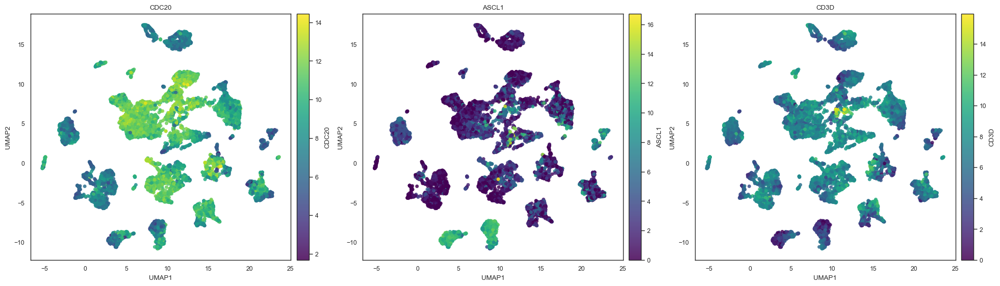

(<Figure size 1950x550 with 6 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CD3D'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [114]:
bk.pl.umap(adata, color=["CDC20", "ASCL1","CD3D"],)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

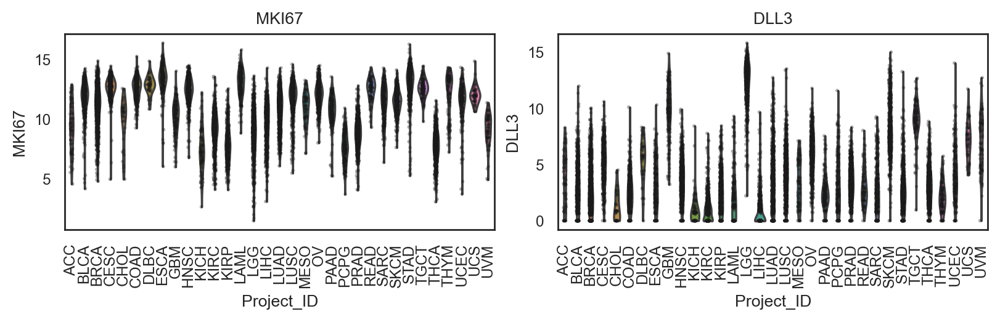

(<Figure size 1600x500 with 2 Axes>,
 array([<Axes: title={'center': 'MKI67'}, xlabel='Project_ID', ylabel='MKI67'>,
        <Axes: title={'center': 'DLL3'}, xlabel='Project_ID', ylabel='DLL3'>],
       dtype=object))

In [112]:
bk.pl.violin(
    adata,
    keys=["MKI67", "DLL3"],
    groupby="Project_ID",
    #layer="log1p_cpm",      # or "counts" / None
    rotate_xticks=90,
    figsize=(8, 2.5),
)  

## 6.2. Score gene signatures

### 6.2.1. A dictionary of signatures

In [116]:
# Define signatures
signatures = {
    "Proliferation": ["MKI67", "TOP2A", "CDC20", "CCNB1", "CCNDA2"],
    "T_cell": ["CD3D", "CD3E", "TRBC1"],
    "Neuroendocrine": ["ASCL1", "NEUROD1", "DLL3", "CHGA"],
}

In [117]:
# Compute signature scores
bk.tl.score_genes_dict(
    adata,
    signatures,
    layer="log1p_cpm",
    scale=True,
)

INFO: score_genes: stored 'Proliferation_score' in adata.obs (n_sig=4, n_ctrl=200, layer=log1p_cpm)
INFO: score_genes: stored 'T_cell_score' in adata.obs (n_sig=2, n_ctrl=100, layer=log1p_cpm)
INFO: score_genes: stored 'Neuroendocrine_score' in adata.obs (n_sig=4, n_ctrl=200, layer=log1p_cpm)


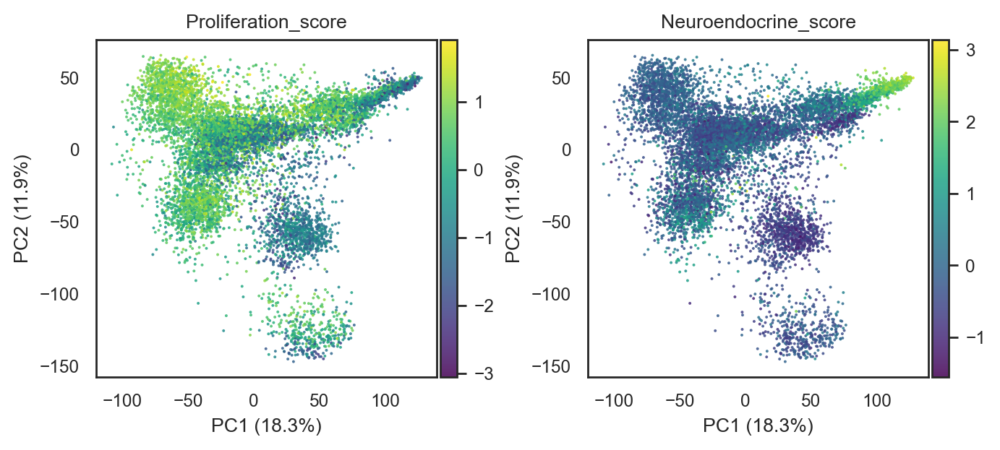

(<Figure size 1360x600 with 4 Axes>,
 array([<Axes: title={'center': 'Proliferation_score'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'Neuroendocrine_score'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [119]:
bk.pl.pca_scatter(
    adata,
    color=["Proliferation_score", "Neuroendocrine_score"],
    cmap="viridis",
    figsize=(3.4,3),
    point_size=2,
)

In [12]:
adata.obs

,Patient_ID,Project_ID,gender,race,ajcc_pathologic_tumor_stage,clinical_stage,histological_type,histological_grade,initial_pathologic_dx_year,menopause_status,...,SLIT2_mut,MYC_mut,MYCL_mut,MYCN_mut,SOX2_mut,ASCL1_mut,NEUROD1_mut,POU2F3_mut,YAP1_mut,NE25_score
Sample_ID,,,,,,,,,,,,,,,,,,,,,
TCGA-S9-A7J2-01,TCGA-S9-A7J2,LGG,MALE,WHITE,NaN,NaN,Oligodendroglioma,G3,2013.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.836809
TCGA-G3-A3CH-11,TCGA-G3-A3CH,LIHC,MALE,ASIAN,Stage IIIA,NaN,Hepatocellular Carcinoma,G2,2010.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.849212
TCGA-EK-A2RE-01,TCGA-EK-A2RE,CESC,FEMALE,WHITE,NaN,Stage IIA,Cervical Squamous Cell Carcinoma,G2,2010.0,Pre (<6 months since LMP AND no prior bilatera...,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-2.038225
TCGA-44-6778-01,TCGA-44-6778,LUAD,MALE,BLACK OR AFRICAN AMERICAN,Stage IA,NaN,Lung Adenocarcinoma,NaN,2007.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.073787
TCGA-F4-6854-01,TCGA-F4-6854,COAD,FEMALE,WHITE,Stage IIA,NaN,Colon Adenocarcinoma,NaN,2011.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069260
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCGA-VQ-AA6F-01,TCGA-VQ-AA6F,STAD,MALE,WHITE,Stage IIB,NaN,"Stomach, Intestinal Adenocarcinoma, Not Otherw...",G2,2010.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.395676
TCGA-BR-8588-01,TCGA-BR-8588,STAD,FEMALE,WHITE,Stage IIB,NaN,"Stomach, Adenocarcinoma, Not Otherwise Specifi...",G3,2012.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.154447
TCGA-24-2254-01,TCGA-24-2254,OV,FEMALE,WHITE,NaN,Stage IIIC,Serous Cystadenocarcinoma,G3,2003.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.347908


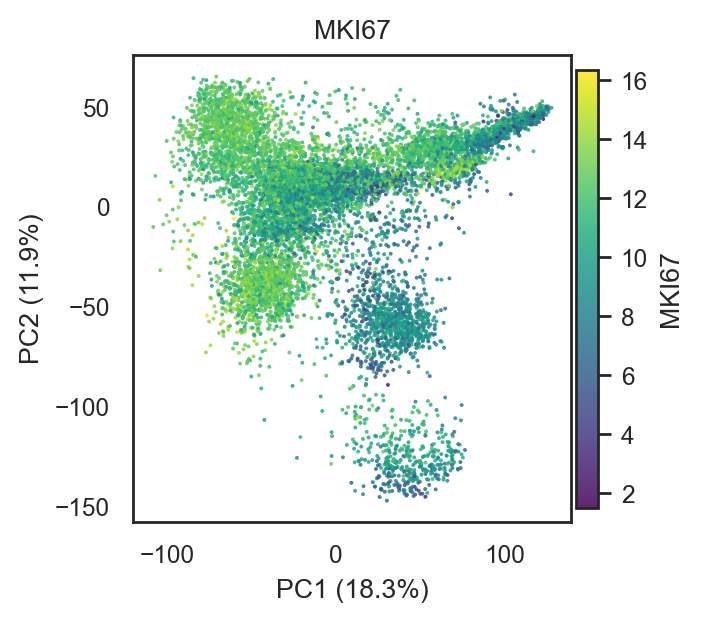

(<Figure size 680x600 with 2 Axes>,
 [<Axes: title={'center': 'MKI67'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [11]:
bk.pl.pca_scatter(
    adata,
    color=["MKI67"],
    cmap="viridis",
    figsize=(3.4,3),
    point_size=2,
)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

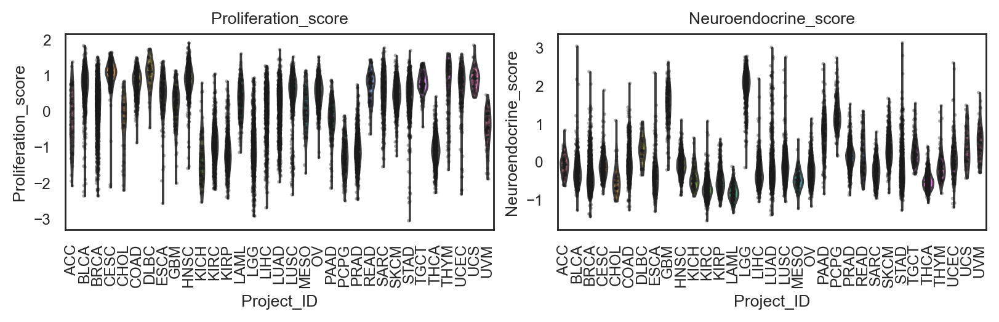

(<Figure size 1600x500 with 2 Axes>,
 array([<Axes: title={'center': 'Proliferation_score'}, xlabel='Project_ID', ylabel='Proliferation_score'>,
        <Axes: title={'center': 'Neuroendocrine_score'}, xlabel='Project_ID', ylabel='Neuroendocrine_score'>],
       dtype=object))

In [120]:
bk.pl.violin(
    adata,
    keys=["Proliferation_score", "Neuroendocrine_score"],
    groupby="Project_ID",
    figsize=(8,2.5),
    rotate_xticks=90,
)

### 6.2.2. A single signature

In [7]:
ne_score_25 = ['BEX1', 'ASCL1', 'INSM1', 'CHGA', 'TAGLN3', 'KIF5C', 'CRMP1', 'SCG3', 'SYT4', 'RTN1',
               'MYT1', 'SYP', 'KIF1A', 'TMSB15a', 'SYN1', 'SYT11', 'RUNDC3A', 'TFF3', 'CHGB', 'TLCD3B',
               'SH3GL2', 'BSN', 'SEZ6', 'TMSB15B', 'CELF3']


INFO: score_genes: stored 'NE25_score' in adata.obs (n_sig=23, n_ctrl=1110, layer=log1p_cpm)


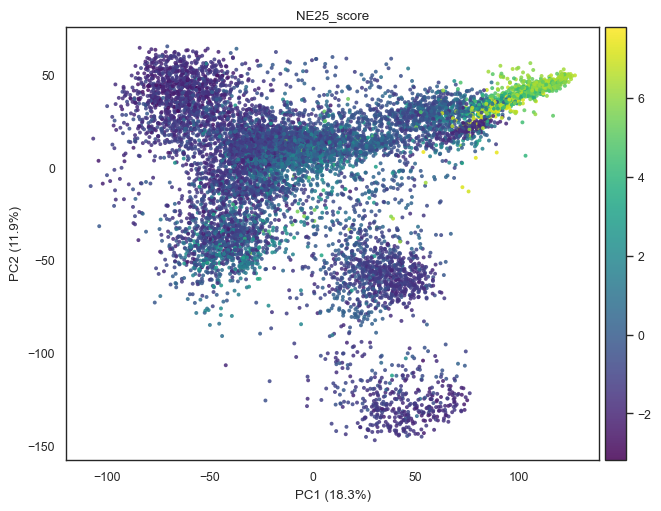

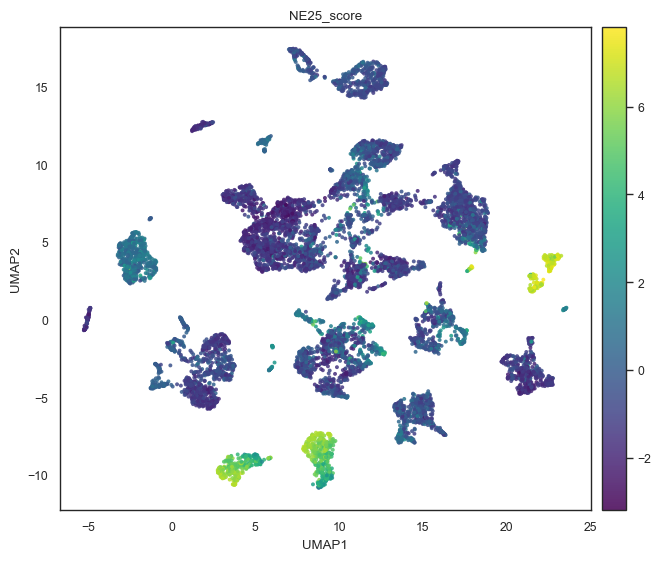

(<Figure size 650x550 with 2 Axes>,
 [<Axes: title={'center': 'NE25_score'}, xlabel='UMAP1', ylabel='UMAP2'>])

In [8]:
bk.tl.score_genes(adata, ne_score_25, score_name="NE25_score", layer="log1p_cpm")

# Plot on PCA/UMAP as continuous color (after your pca_scatter/umap changes)
bk.pl.pca_scatter(adata, color="NE25_score", cmap="viridis", point_size=8)
bk.pl.umap(adata, color="NE25_score", cmap="viridis", point_size=8)

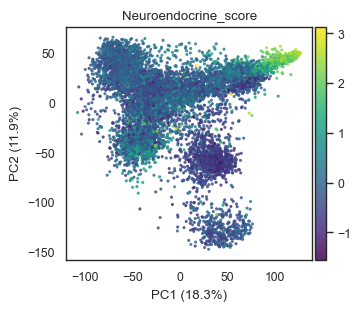

(<Figure size 350x300 with 2 Axes>,
 [<Axes: title={'center': 'Neuroendocrine_score'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [123]:
bk.pl.pca_scatter(adata, color="Neuroendocrine_score", cmap="viridis", figsize=(3.5,3), point_size=5)

### 6.2.3. Cell cycle status

This is not very informative in bulk RNAseq data and simply correlates with increased proliferation, but it may be useful to separate specific subgroups of proliferating vs. less proliferating samples in the same tumor type

In [9]:
# Example gene lists (use your preferred human cell-cycle sets)
cell_cycle_genes = {
"s_genes": ["MCM5", "PCNA", "TYMS", "MCM2", "MCM4", "RRM1", "UNG", "GINS2"],
"g2m_genes": ["HMGB2", "CDK1", "NUSAP1", "UBE2C", "BIRC5", "TPX2", "TOP2A"],
}

In [10]:
bk.tl.score_genes_cell_cycle(
    adata,
    s_genes=cell_cycle_genes["s_genes"],
    g2m_genes=cell_cycle_genes["g2m_genes"],
    layer="log1p_cpm",   # or whatever you use for expression scoring
    scale=True,          # optional; often helps if genes have different ranges
)

adata.obs[["S_score", "G2M_score", "phase"]].head()

INFO: score_genes: stored 'S_score' in adata.obs (n_sig=8, n_ctrl=387, layer=log1p_cpm)
INFO: score_genes: stored 'G2M_score' in adata.obs (n_sig=7, n_ctrl=347, layer=log1p_cpm)
INFO: score_genes_cell_cycle: stored obs['S_score'], obs['G2M_score'], obs['phase'] (layer=log1p_cpm, scale=True)


,S_score,G2M_score,phase
Sample_ID,,,
TCGA-S9-A7J2-01,-0.875463,-1.000690,G1
TCGA-G3-A3CH-11,-0.592084,-1.139442,G1
TCGA-EK-A2RE-01,1.561405,1.151602,S
TCGA-44-6778-01,0.326650,0.438212,G2M
TCGA-F4-6854-01,0.693691,0.848974,G2M


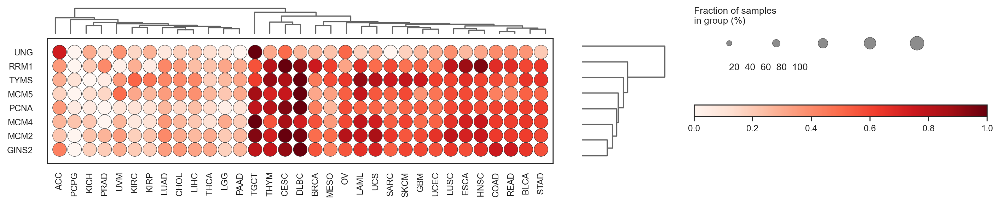

(<Figure size 5000x600 with 5 Axes>, <Axes: >)

In [43]:
bk.pl.dotplot(adata, var_names=cell_cycle_genes["s_genes"], groupby="Project_ID",
              swap_axes=True,
              dendrogram_top=True,
              dendrogram_rows=True,
              cluster_cols=True,
              cluster_rows=True,
              standard_scale="var",
              colorbar_title=None,
              figsize=(25,3),
              save=DESKTOP + "dotplot_example.png",
             )

In [22]:
cc_names = {
    "S-phase": ["MCM2", "PCNA", "TYMS"],
    "G2/M": ["CDC20", "AURKB", "PLK1"],
}

In [35]:
gene_names = {
    "Proliferation": ["MCM2", "CDC20", "PLK1"],
    "Neuroendocrine": ["ASCL1", "GFAP", "DLL3"],
}

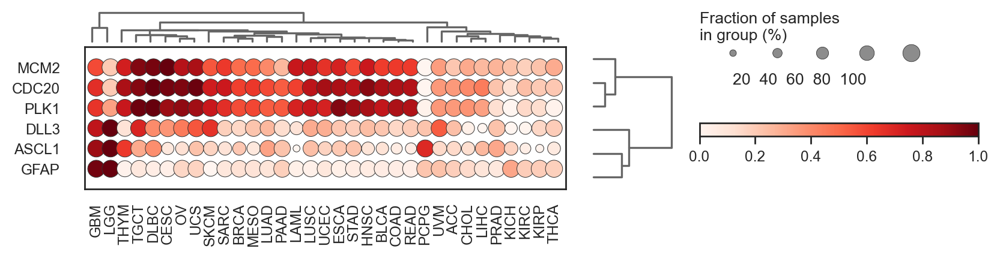

(<Figure size 2800x400 with 5 Axes>, <Axes: >)

In [52]:
bk.pl.dotplot(adata, var_groups=gene_names, groupby="Project_ID",
              swap_axes=True,
              dendrogram_top=True,
              dendrogram_rows=True,
              cluster_cols=True,
              cluster_rows=True,
              standard_scale="var",
              colorbar_title=None,
              figsize=(14,2),
              save=DESKTOP + "dotplot_example.png",
             )

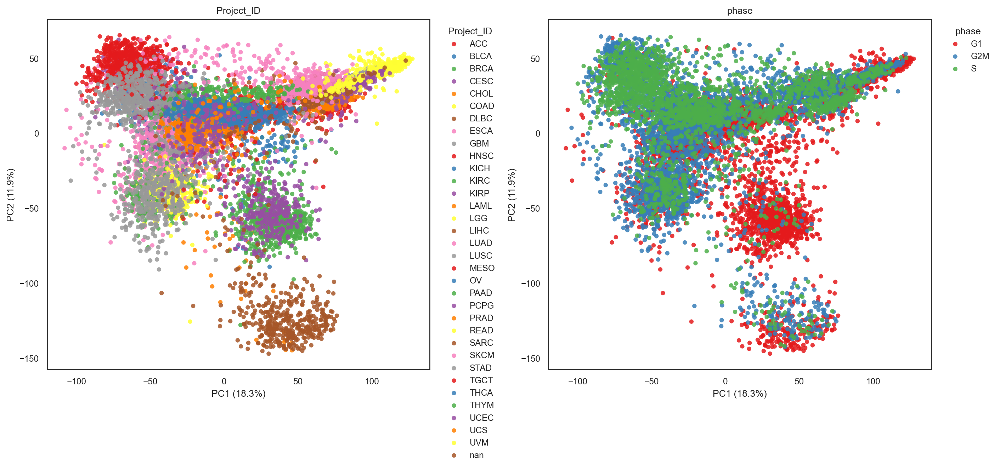

(<Figure size 2800x1300 with 2 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'phase'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [123]:
bk.pl.pca_scatter(adata, color=["Project_ID", "phase"], figsize=(7,6.5))

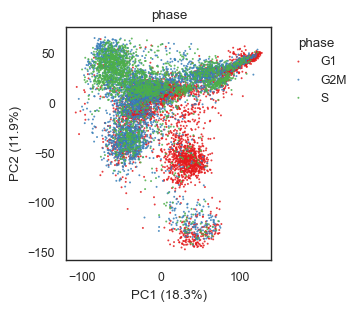

(<Figure size 350x300 with 1 Axes>,
 [<Axes: title={'center': 'phase'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [125]:
bk.pl.pca_scatter(adata, color=["phase"], figsize=(3.5,3), point_size=2)

In [ ]:
# save .h5ad file
adata.write("../data/h5ad/260125_BULLKpy_TCGA_RNAseq.h5ad")

# 7. Data Exploration
<a id="exploration"></a>

## 7.1. General bidimensional representation

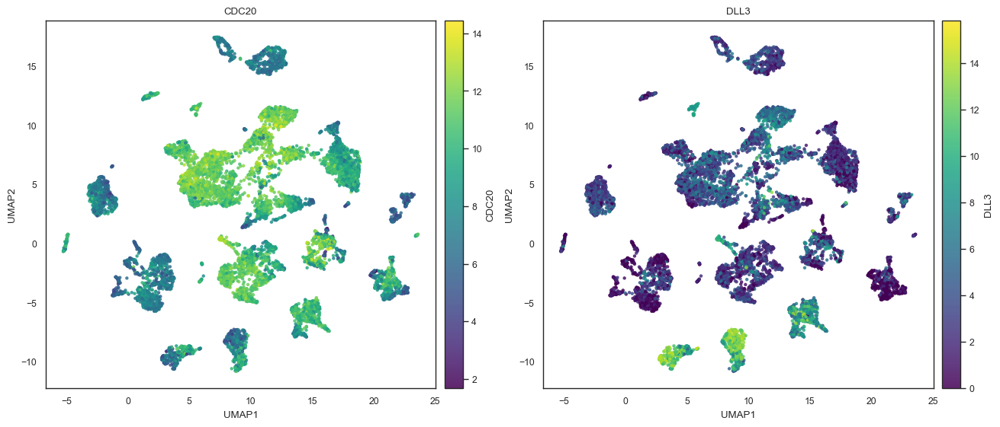

(<Figure size 1300x550 with 4 Axes>,
 array([<Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'DLL3'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [129]:
bk.pl.umap(adata, color=["CDC20", "DLL3"], point_size=10)

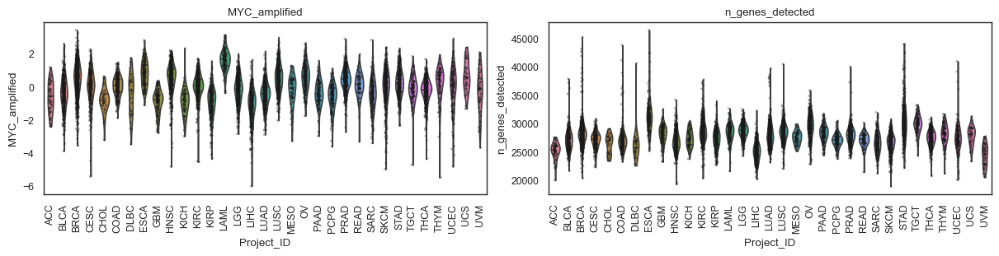

(<Figure size 1200x300 with 2 Axes>,
 array([<Axes: title={'center': 'MYC_amplified'}, xlabel='Project_ID', ylabel='MYC_amplified'>,
        <Axes: title={'center': 'n_genes_detected'}, xlabel='Project_ID', ylabel='n_genes_detected'>],
       dtype=object))

In [130]:
bk.pl.violin(
    adata,
    keys=["MYC_amplified", "n_genes_detected"],
    groupby="Project_ID",
    #order=["LumA", "LumB", "Her2", "Basal", "Normal"],
    figsize=(12, 3),
    rotate_xticks=90,
    #save="figs/violin_qc.png",
)

## 7.2. Select only one/a few categories

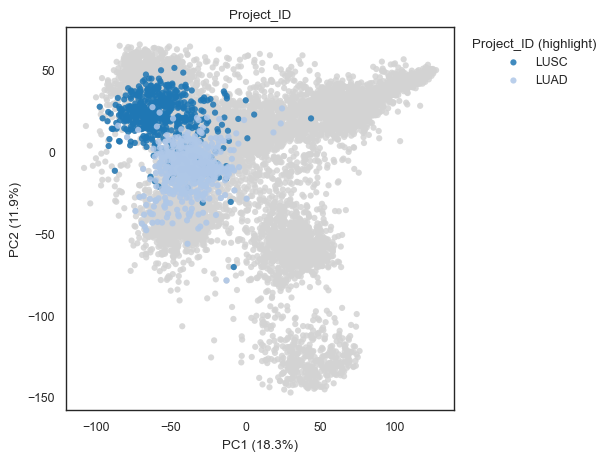

(<Figure size 600x450 with 1 Axes>,
 [<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>])

In [131]:
bk.pl.pca_scatter(
    adata,
    color="Project_ID",
    highlight=["LUSC", "LUAD"],
    palette="tab20",
    figsize=(6,4.5),
)

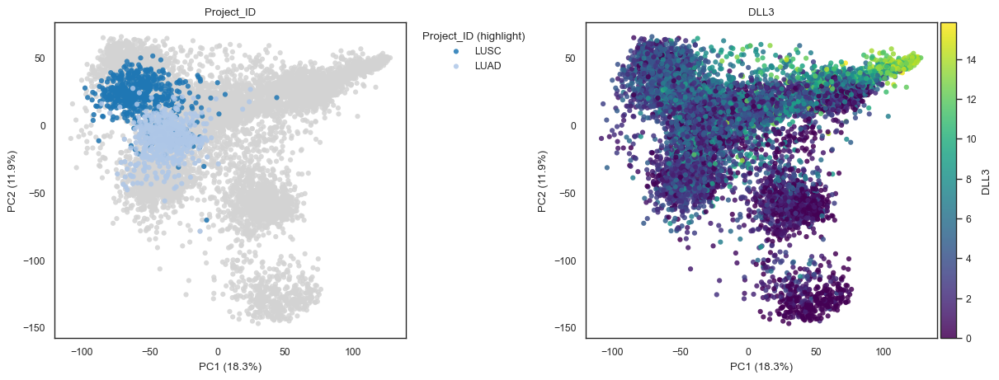

(<Figure size 1200x450 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'DLL3'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [132]:
bk.pl.pca_scatter(
    adata,
    color=["Project_ID", "DLL3"],
    highlight=["LUSC", "LUAD"],
    palette="tab20",
    figsize=(6,4.5),
)

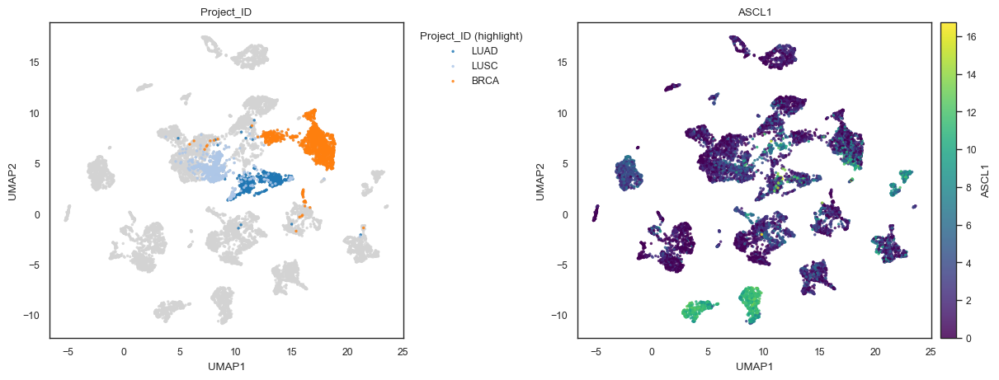

(<Figure size 1200x450 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [133]:
bk.pl.umap(
    adata,
    color=["Project_ID", "ASCL1"],
    highlight=["LUAD", "LUSC", "BRCA"],
    palette="tab20",
    figsize=(6,4.5),
    point_size=6,
)

## 7.3. Subfilters

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

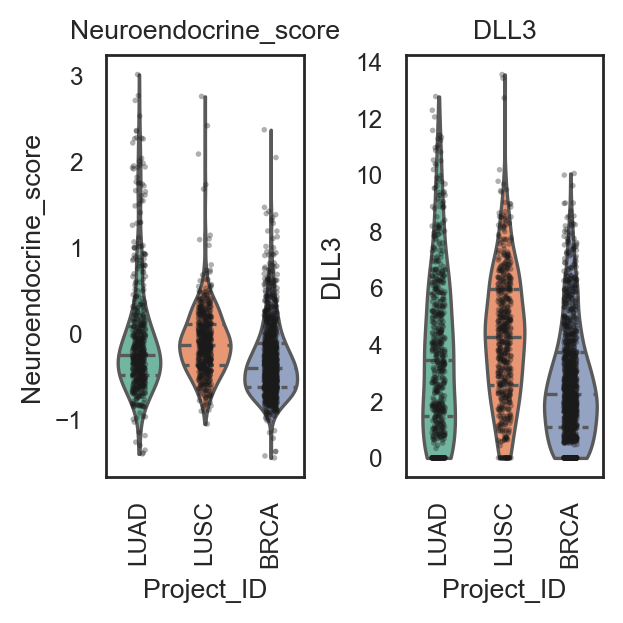

(<Figure size 600x600 with 2 Axes>,
 array([<Axes: title={'center': 'Neuroendocrine_score'}, xlabel='Project_ID', ylabel='Neuroendocrine_score'>,
        <Axes: title={'center': 'DLL3'}, xlabel='Project_ID', ylabel='DLL3'>],
       dtype=object))

In [126]:
bk.pl.violin(
    adata,
    keys=["Neuroendocrine_score", "DLL3"],
    groupby="Project_ID",
    order=["LUAD", "LUSC", "BRCA"],
    figsize=(3,3),
    rotate_xticks=90,
    #save="figs/violin_qc.png",
)

In [136]:
bk.pl.dotplot_association(adata, feature_col=["ASCL1"], groupby_col="Project_ID",
             figsize=(3,5))

AttributeError: 'AnnData' object has no attribute 'replace'

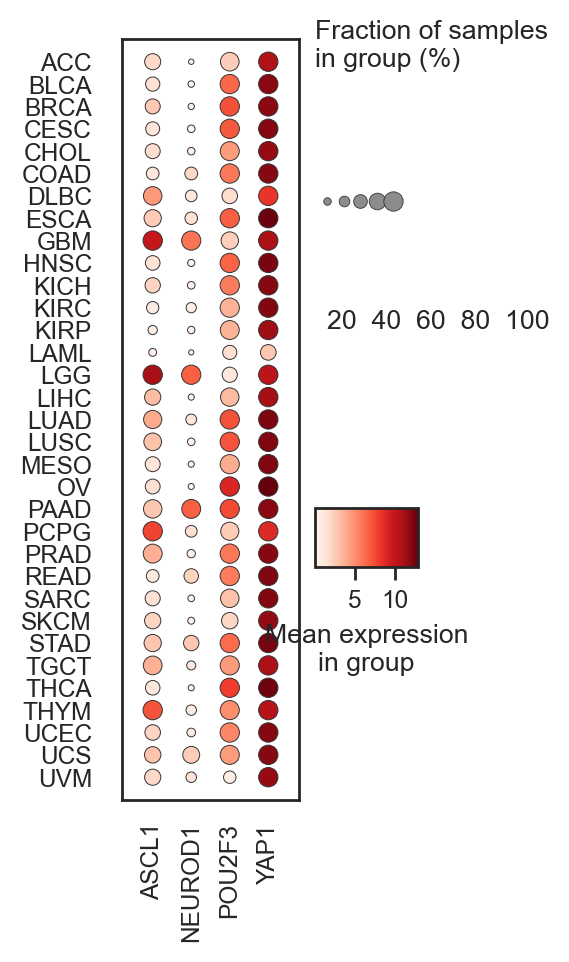

(<Figure size 400x1000 with 3 Axes>, <Axes: >)

In [54]:
bk.pl.dotplot(adata, var_names=["ASCL1","NEUROD1","POU2F3","YAP1"], groupby="Project_ID",
             figsize=(2,5))

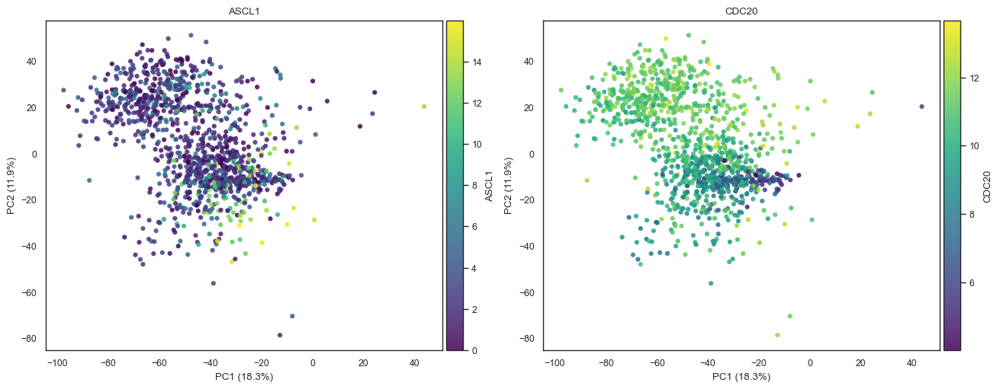

(<Figure size 1300x500 with 4 Axes>,
 array([<Axes: title={'center': 'ASCL1'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>,
        <Axes: title={'center': 'CDC20'}, xlabel='PC1 (18.3%)', ylabel='PC2 (11.9%)'>],
       dtype=object))

In [136]:
bk.pl.pca_scatter(adata_lung, color=["ASCL1", "CDC20"])

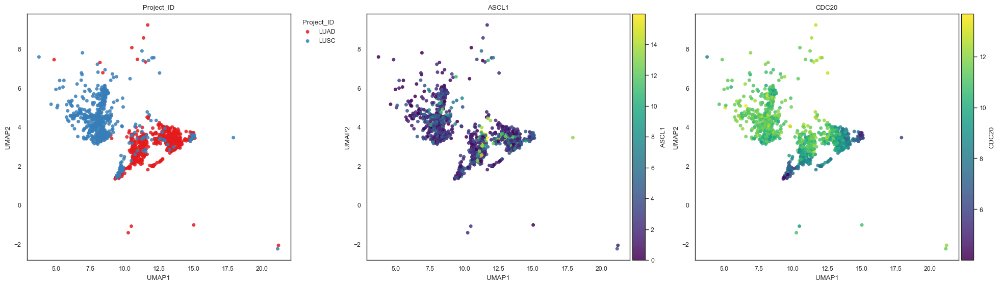

(<Figure size 1950x550 with 5 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='UMAP1', ylabel='UMAP2'>,
        <Axes: title={'center': 'CDC20'}, xlabel='UMAP1', ylabel='UMAP2'>],
       dtype=object))

In [137]:
bk.pl.umap(adata_lung, color=["Project_ID", "ASCL1", "CDC20"])

# 8. Correlations & Associations
<a id="correlations"></a>

## 8.1. Correlation heatmap

In [140]:
adata2 = adata[(adata.obs.Project_ID == "BRCA") | (adata.obs.Project_ID == "LUAD")]
adata2.shape

(1785, 52603)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


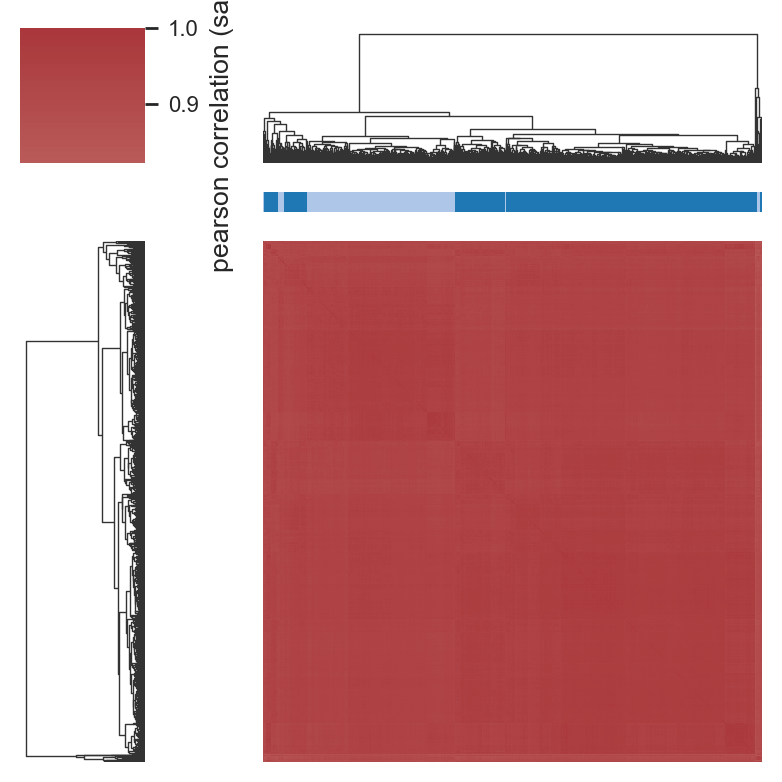

In [141]:
# 5) sample QC correlation heatmap
bk.pl.corr_heatmap(
    adata2,
    layer="log1p_cpm",
    method="pearson",
    groupby="Project_ID",
    col_colors="Project_ID",   
    figsize=(4,4),
    #save="figs/corr_heatmap.png",
)

## 8.2. Find strongest correlations with numerical data

### 8.2.1. Gene–gene correlations

In [142]:
# 1) One gene vs ALL genes
df = bk.tl.gene_gene_correlations(
    adata,
    gene="DLL3",
    top_n=50000,
)
df.head(3)

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
0,DLL3,GDF1,0.687070,0.0,10534,0.0,pearson,None,none
1,DLL3,DPF1,0.656359,0.0,10534,0.0,pearson,None,none
2,DLL3,LINC00634,0.653721,0.0,10534,0.0,pearson,None,none


In [8]:
df.tail(5)

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
49995,DLL3,RPSAP64,-0.004006,0.681003,10534,0.716500,pearson,None,none
49996,DLL3,CCR1,-0.004005,0.681052,10534,0.716537,pearson,None,none
49997,DLL3,FCF1P4,-0.004005,0.681101,10534,0.716562,pearson,None,none
49998,DLL3,RNU5F-1,-0.004005,0.681103,10534,0.716562,pearson,None,none
49999,DLL3,RP11-463M16.5,0.004004,0.681117,10534,0.716562,pearson,None,none


<Axes: ylabel='r'>

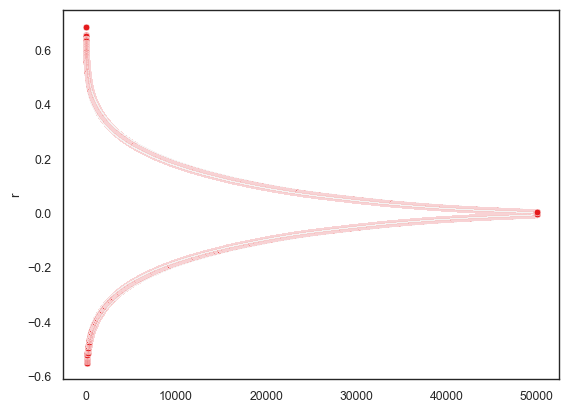

In [9]:
# Volcano-style plot
sns.scatterplot(x=df.index, y=df["r"],)

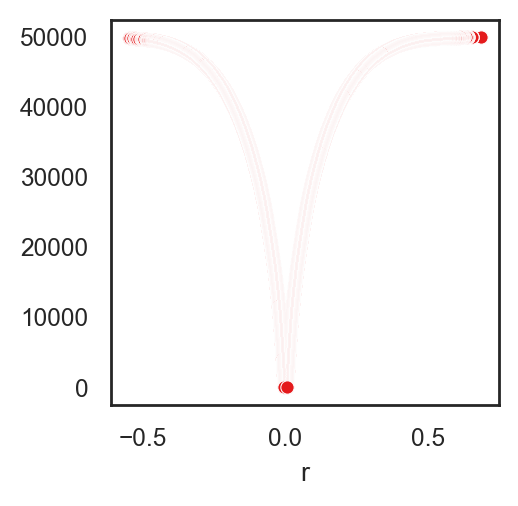

In [148]:
plt.figure(figsize=(2.5, 2.5))
sns.scatterplot(y=df.index[::-1], x=df["r"])
plt.show()

In [11]:
# 2) One gene vs a pathway / gene list

gene_list = ["DLL3", "SOX2", "NEUROD1", "MYCL", "RB1", "MYC", "YAP1"]

df = bk.tl.gene_gene_correlations(
    adata,
    gene="ASCL1",
    genes=gene_list,
)
df

,query_gene,gene,r,pval,n,qval,method,batch_key,batch_mode
0,ASCL1,NEUROD1,0.547992,0.000000e+00,10534,0.000000e+00,pearson,None,none
1,ASCL1,DLL3,0.479537,0.000000e+00,10534,0.000000e+00,pearson,None,none
2,ASCL1,SOX2,0.432899,0.000000e+00,10534,0.000000e+00,pearson,None,none
3,ASCL1,YAP1,-0.216790,2.894460e-112,10534,5.065305e-112,pearson,None,none
4,ASCL1,MYC,-0.164095,1.766614e-64,10534,2.473259e-64,pearson,None,none
5,ASCL1,MYCL,0.080813,9.828895e-17,10534,1.146704e-16,pearson,None,none
6,ASCL1,RB1,-0.026361,6.814782e-03,10534,6.814782e-03,pearson,None,none


#### Batch-aware correlation between genes and observations

In [ ]:
# 1) Residualize batch (+ optional covariates) then correlate
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1", layer="log1p_cpm",
    batch_key="Batch",                                 # if bactches present
    batch_mode="residualize",
)

In [ ]:
# 2) Z-score within each batch, then correlate pooled
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1",
    batch_key="Batch", batch_mode="within_batch",
)

In [ ]:
# 3) Meta-analyze correlations across batches
df = bk.tl.gene_gene_correlations(
    adata, gene="ASCL1",
    batch_key="Batch", batch_mode="meta",
)

#### Gene versus Observations Correlations

In [149]:
# One gene vs all numeric metadata

df_go = bk.tl.top_gene_obs_correlations(
    adata,
    gene="DLL3",
    layer="log1p_cpm",
    method="spearman",
    top_n=1000,
)
df_go.head()

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/correlations.py:140: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = spearmanr(x[m], y[m], nan_policy="omit")


,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
0,DLL3,asbestos_exposure_age_last,0.644357,0.061033,9,0.072829,spearman,None,none
1,DLL3,Neuroendocrine_score,0.603009,0.000000,10534,0.000000,spearman,None,none
2,DLL3,asbestos_exposure_age,0.446018,0.146136,12,0.166010,spearman,None,none
3,DLL3,RETINOL_METABOLISM,-0.388674,0.000000,10194,0.000000,spearman,None,none
4,DLL3,VEGF_PATHWAY,-0.386605,0.000000,10194,0.000000,spearman,None,none


In [13]:
df_go.tail()

,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
289,DLL3,MYC_mut,-0.001734,0.873265,8463,0.888373,spearman,None,none
290,DLL3,YAP1_mut,-0.001171,0.914255,8463,0.923672,spearman,None,none
291,DLL3,CCND1_mut,0.001154,0.915431,8463,0.923672,spearman,None,none
292,DLL3,kmeans_10,-0.001011,0.917388,10534,0.923672,spearman,None,none
293,DLL3,MYC_amplified,-0.000877,0.929460,10194,0.932632,spearman,None,none


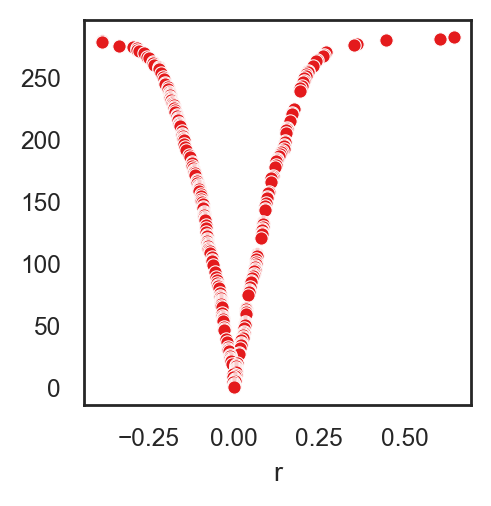

In [151]:
# Volcano-style plot
plt.figure(figsize=(2.5, 2.5))
sns.scatterplot(y=df_go.index[::-1], x=df_go["r"],)
plt.show()

In [28]:
df_go = bk.tl.top_gene_obs_correlations(
    adata,
    gene="RB1",
    layer="log1p_cpm",
    method="spearman",
    top_n=60000,
)
df_go = df_go.sort_values(by="r", ascending=False)
df_go.head(10)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/correlations.py:140: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = spearmanr(x[m], y[m], nan_policy="omit")


,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
0,RB1,MYC_amplified,0.398919,0.000000e+00,10194,0.000000e+00,spearman,None,none
2,RB1,GP3_Tumor_suppressing_miRNA_targets,0.382611,0.000000e+00,10194,0.000000e+00,spearman,None,none
3,RB1,RB_PATHWAY,0.347591,2.389882e-287,10194,2.342085e-285,spearman,None,none
4,RB1,13q,0.329098,4.264420e-196,7788,1.567174e-194,spearman,None,none
5,RB1,chr13,0.329098,4.264420e-196,7788,1.567174e-194,spearman,None,none
6,RB1,n_genes_detected,0.319131,5.445399e-248,10534,4.002368e-246,spearman,None,none
7,RB1,RAS_PATHWAY,0.308493,1.197690e-223,10194,7.042420e-222,spearman,None,none
8,RB1,ALK_PATHWAY,0.290023,9.555320e-197,10194,4.682107e-195,spearman,None,none
9,RB1,asbestos_exposure_age_last,0.266667,4.879223e-01,9,5.293327e-01,spearman,None,none
10,RB1,Immune_NSCLC_score,0.258981,6.801010e-156,10194,2.221663e-154,spearman,None,none


In [38]:
df_go.tail(15)

,gene,obs,r,pval,n,qval,method,batch_key,batch_mode
70,RB1,PD1_SIGNALING,-0.127876,1.990392e-38,10194,9.002697e-38,spearman,None,none
68,RB1,3p,-0.129386,2.602763e-31,8027,1.006858e-30,spearman,None,none
51,RB1,diagnoses.year_of_diagnosis,-0.150708,1.069503e-53,10362,6.835520e-53,spearman,None,none
50,RB1,initial_pathologic_dx_year,-0.150747,1.016900e-53,10361,6.643746e-53,spearman,None,none
47,RB1,NE25_score,-0.154030,6.131690e-57,10534,4.097084e-56,spearman,None,none
46,RB1,Neuroendocrine_score,-0.156832,5.478429e-59,10534,3.745716e-58,spearman,None,none
45,RB1,leiden_0.4,-0.162069,6.385504e-63,10534,4.469853e-62,spearman,None,none
42,RB1,RB1_mut,-0.166202,1.778777e-53,8463,1.111797e-52,spearman,None,none
35,RB1,IGF1R_PATHWAY,-0.174507,1.621550e-70,10194,1.444653e-69,spearman,None,none
32,RB1,GP5_MYC_targets/TERT,-0.180469,2.286266e-75,10194,2.240541e-74,spearman,None,none


<Axes: xlabel='r'>

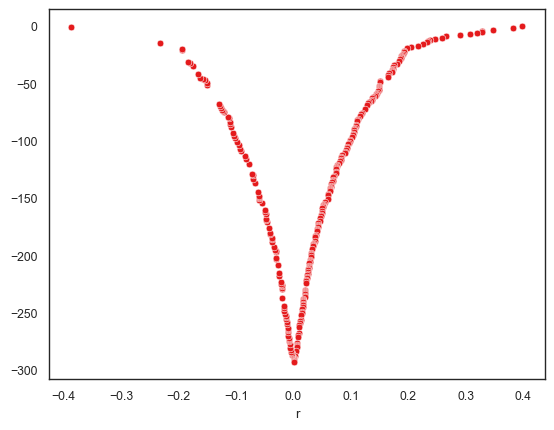

In [33]:
# Volcano-style plot
sns.scatterplot(y=-df_go.index, x=df_go["r"],)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


<Axes: xlabel='r', ylabel='qval'>

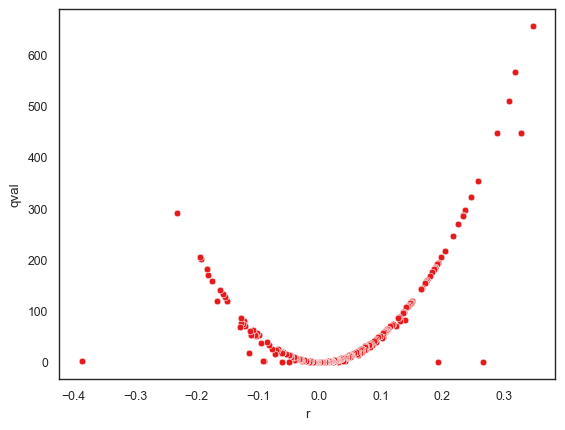

In [34]:
# Volcano-style plot
sns.scatterplot(y=-np.log(df_go["qval"]), x=df_go["r"],)

#### Wide matrix (focus × against) + p/q matrices

In [167]:
selected_obs = ["Neuroendocrine_score"]                         # One: "Purity" or several: ["Purity", "TMB"]
obs_list = ["OS.time", "DSS.time", "PFI.time", 
            "PFI.time.1", "PFI.time.2", "PFS.time", "DSS.time.cr", "DFI.time.cr", "PFI.time.1.cr",
            "PFI.time.2.cr",
            "mitotic_count", 
            "Interferon_19272155", "ai1", "lst1", "hrd-loh", "HRD", "S_score",
            "GP2_Immune-Tcell/Bcell", "Leuk", "Stroma", "purity", "ploidy",
            "exposures.cigarettes_per_day", "exposures.pack_years_smoked", "exposures.years_smoked",
            "number_pack_years_smoked", "age_began_smoking_in_years",
            "exposures.alcohol_history", "frequency_of_alcohol_consumption", "amount_of_alcohol_consumption_per_day",
            "amt_alcohol_consumption_per_day",
            "asbestos_exposure_age", "asbestos_exposure_years", "asbestos_exposure_age_last",
           ]

# If necessary:
#adata.obs[obs_list] = adata.obs[obs_list].apply(pd.to_numeric, errors="coerce")
#adata.obs[obs_list] = adata.obs[obs_list].astype(float)          # float, int, "category"

In [168]:
R, P, Q = bk.tl.obs_obs_corr_matrix(
    adata, focus=selected_obs, against=obs_list, return_p=True, return_q=True,)

res = pd.concat([R, P, Q], keys=["R", "p-val", "q-val"], #names=["source", "row"]
)
res.index = res.index.droplevel(1)
res = res.T.sort_values(by="R", ascending=False)
res

,R,p-val,q-val
asbestos_exposure_age,0.628357,2.865291e-02,4.111070e-02
amt_alcohol_consumption_per_day,0.333209,6.238112e-02,8.577405e-02
asbestos_exposure_age_last,0.173538,6.552228e-01,6.756985e-01
frequency_of_alcohol_consumption,0.146301,3.652404e-03,5.478605e-03
purity,0.121063,8.466077e-32,5.587611e-31
ploidy,0.058771,1.342107e-08,3.690794e-08
exposures.years_smoked,0.049152,1.985157e-01,2.620407e-01
age_began_smoking_in_years,0.030354,5.736351e-01,6.501518e-01
amount_of_alcohol_consumption_per_day,0.026720,6.250011e-01,6.653237e-01
exposures.cigarettes_per_day,0.015299,5.208989e-01,6.139166e-01


In [2]:
bk.tl.plot_corr_heatmap(R, title="Correlations", figsize=(7,1))

NameError: name 'bk' is not defined

#### Plot scatter with hue

In [1]:
adata.obs["GP2_Immune-Tcell/Bcell"] = adata.obs["GP2_Immune-Tcell/Bcell"].astype("float")
adata.obs["Neuroendocrine_score"] = adata.obs["Neuroendocrine_score"].astype("float")

NameError: name 'adata' is not defined

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


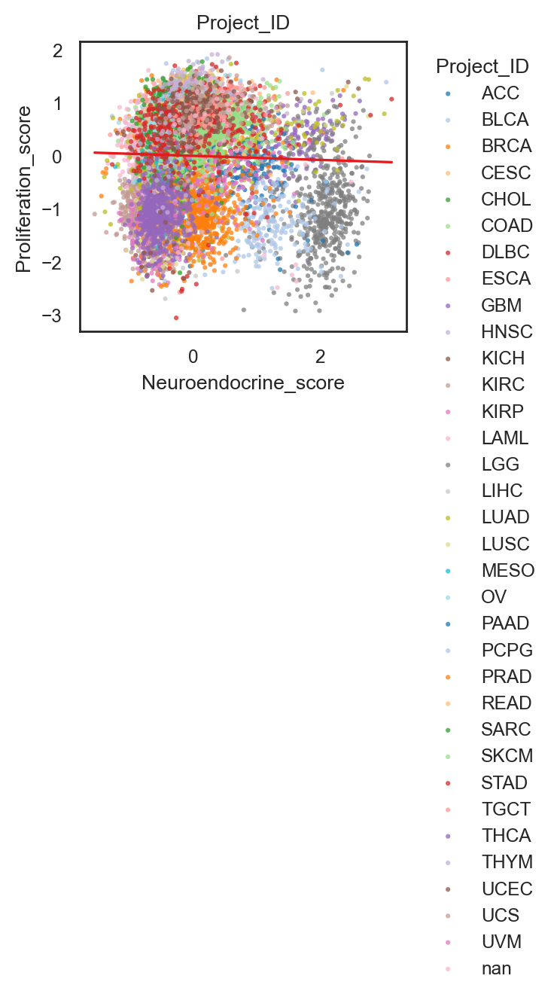

(<Figure size 560x500 with 1 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 10534,
   'pearson_r': -0.030601072082384627,
   'pearson_p': 0.0016830745623305488,
   'spearman_rho': 0.13850161995132865,
   'spearman_p': 2.8194609096773605e-46,
   'slope': -0.03839097267316887,
   'intercept': -6.559530646023928e-15}])

In [9]:
bk.pl.corrplot_obs(
    adata,
    x="Neuroendocrine_score",
    y="Proliferation_score",
    color="Project_ID",
    cmap="viridis",
    annotate=False,
    legend=True,
    point_size=5,
    figsize=(2.8,2.5)
)

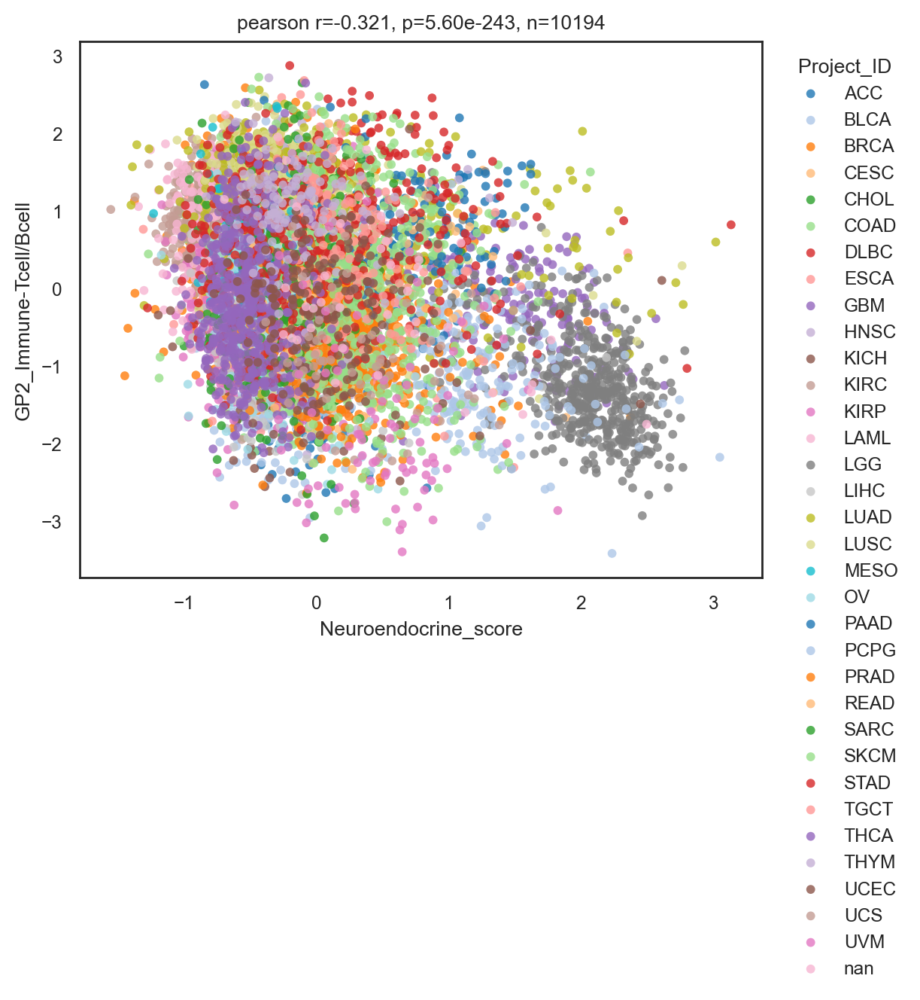

(<Figure size 1200x1200 with 1 Axes>,
 <Axes: title={'center': 'pearson r=-0.321, p=5.60e-243, n=10194'}, xlabel='Neuroendocrine_score', ylabel='GP2_Immune-Tcell/Bcell'>)

In [55]:
bk.tl.plot_corr_scatter(
    adata,
    x="Neuroendocrine_score",
    y="GP2_Immune-Tcell/Bcell",                      # asbestos_exposure_age
    hue="Project_ID",      # categorical
    kind="obs_obs",
    figsize=(6,6)
)

#### Quick correlations without statistics

In [16]:
# Numeric obs vs numeric obs (top pairs)

selected_obs = ["Proliferation_score", "Neuroendocrine_score"]                  # single: "purity" or list: ["NE25_score", "purity"]

mat = bk.tl.obs_obs_corr_matrix(adata, focus=selected_obs)
mat.T.sort_values(by=selected_obs, ascending=False)

,Proliferation_score,Neuroendocrine_score
score_prolif,0.980260,-0.043785
G2M_score,0.976832,-0.002540
Module11_Prolif_score,0.959979,-0.031954
GP1_Proliferation/DNA_repair,0.882310,-0.045499
S_score,0.870090,-0.032923
...,...,...
exposures.alcohol_history,NaN,NaN
exposures.created_datetime,NaN,NaN
days_to_last_known_alive,NaN,NaN
Unnamed: 1061,NaN,NaN


In [12]:
# Explicit focus × explicit against

focus=["NE25_score", "purity"]
against=["OS.time", "PFI.time", "DSS.time"]

mat = bk.tl.obs_obs_corr_matrix(adata, focus=focus, against=against,)
mat

,OS.time,PFI.time,DSS.time
NE25_score,-0.015300,-0.037279,-0.020918
purity,0.017287,-0.006304,0.021678


In [17]:
mat_first = mat.iloc[:,:20]

In [18]:
mat_first

,initial_pathologic_dx_year,birth_days_to,last_contact_days_to,death_days_to,new_tumor_event_dx_days_to,OS,OS.time,DSS,DSS.time,DFI,DFI.time,PFI,PFI.time,sample_type_id,ICS5_score,LIexpression_score,Chemokine12_score,NHI_5gene_score,CD68,CD8A
Proliferation_score,-0.047447,-0.123461,-0.025183,-0.101040,-0.073480,0.174930,-0.058851,0.159001,-0.057331,0.139910,-0.058643,0.149054,-0.089955,-0.293183,0.238639,0.213101,0.279863,0.314593,0.190346,0.139766
Neuroendocrine_score,0.060243,0.165593,-0.066454,0.005146,0.026405,0.006305,-0.035446,0.067023,-0.044433,-0.027886,-0.041231,0.068359,-0.068134,-0.054007,-0.287189,-0.328179,-0.251633,-0.257440,-0.126386,-0.299603


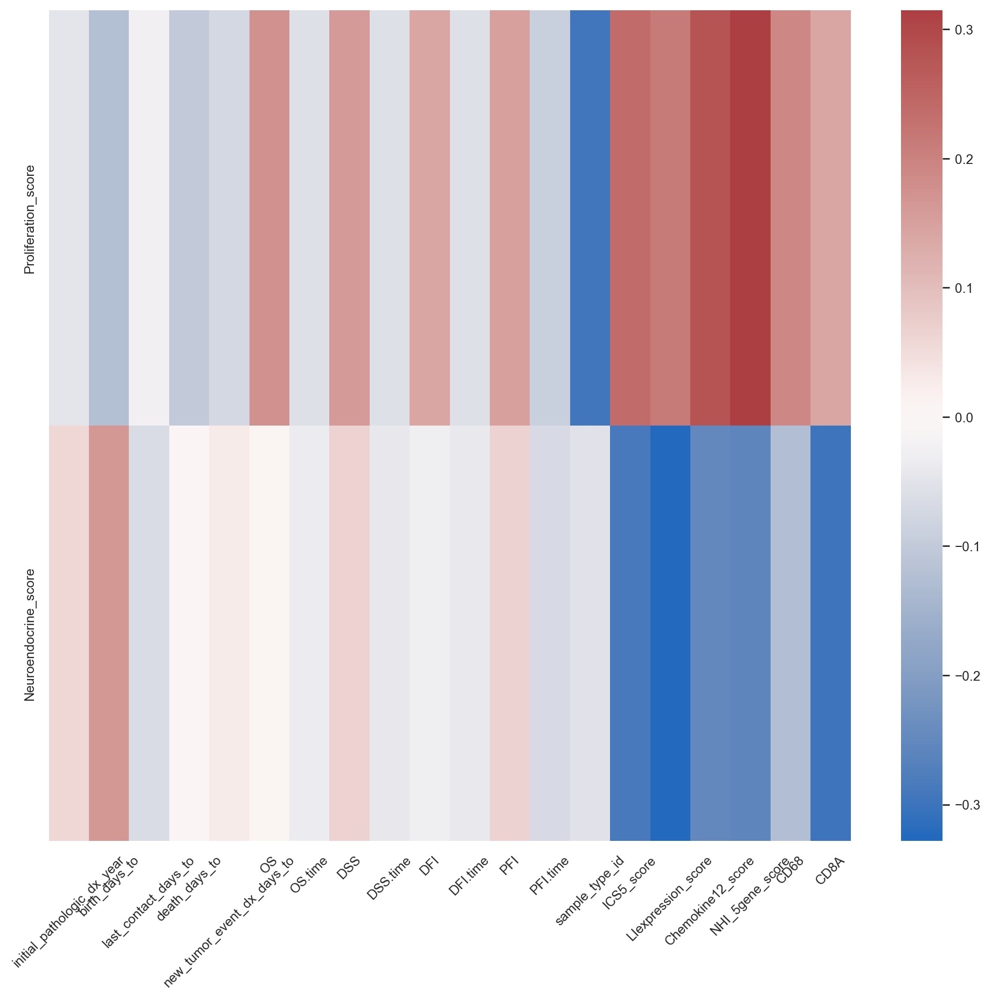

In [22]:
fig, ax = plt.subplots(figsize=(12,10))
sns.heatmap(mat_first, cmap="vlag", center=0,
           )
plt.xticks(rotation=45)
plt.show()

## 8.3. Correlation Plots

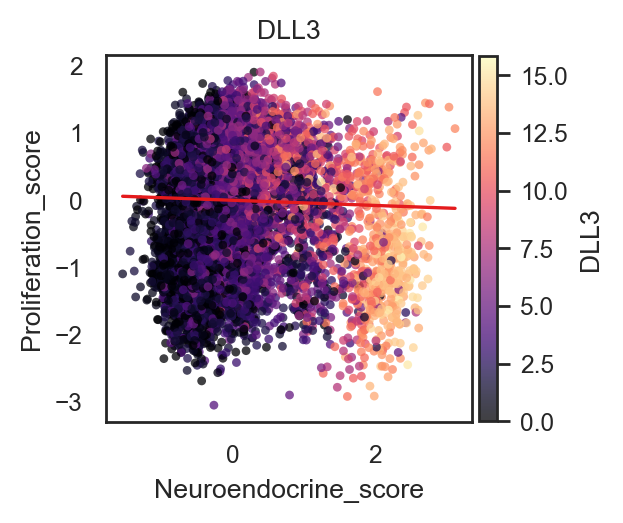

(<Figure size 600x500 with 2 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 10534,
   'pearson_r': -0.030601072082384627,
   'pearson_p': 0.0016830745623305488,
   'spearman_rho': 0.13850161995132865,
   'spearman_p': 2.8194609096773605e-46,
   'slope': -0.03839097267316887,
   'intercept': -6.559530646023928e-15}])

In [9]:
#Color by gene expression (continuous colormap)
bk.pl.corrplot_obs(
    adata,
    x="Neuroendocrine_score",              # "Neuroendocrine_score"
    y="Proliferation_score",
    color="DLL3",          # gene in adata.var_names
    layer="log1p_cpm",
    cmap="magma",
    point_size=10,
    annotate=False,
    figsize=(3,2.5),
)

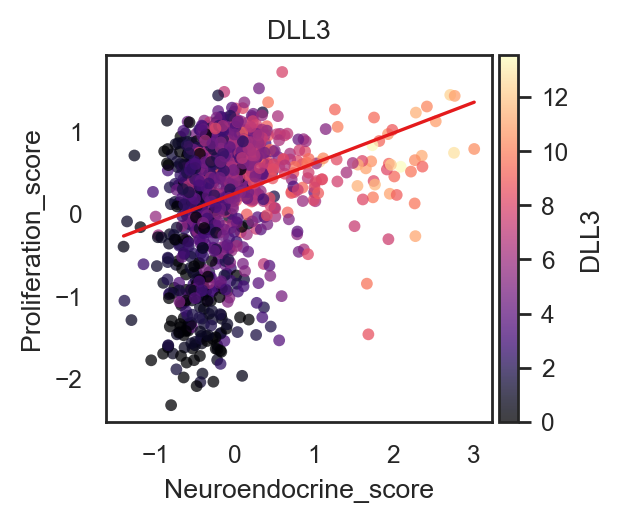

(<Figure size 600x500 with 2 Axes>,
 array([<Axes: title={'center': 'DLL3'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [40]:
#Color by gene expression (continuous colormap)
bk.pl.corrplot_obs(
    adata_lung,
    x="Neuroendocrine_score",              # "Neuroendocrine_score"
    y="Proliferation_score",
    color="DLL3",          # gene in adata.var_names
    layer="log1p_cpm",
    cmap="magma",
    annotate=False,
    figsize=(3,2.5),
)

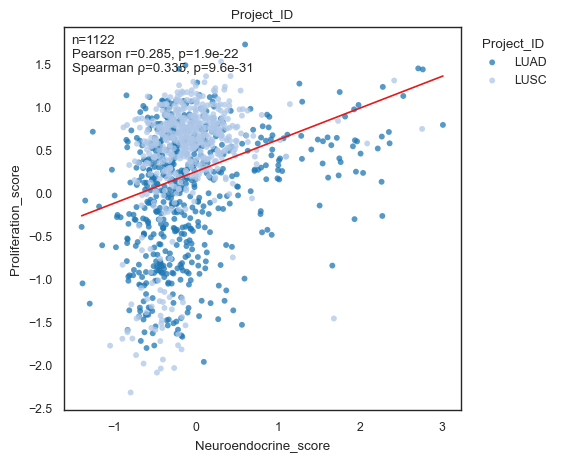

(<Figure size 550x450 with 1 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [53]:
#Color by categorical metadata
bk.pl.corrplot_obs(
    adata_lung,
    x="Neuroendocrine_score",
    y="Proliferation_score",
    color="Project_ID",
    palette="tab20",
)

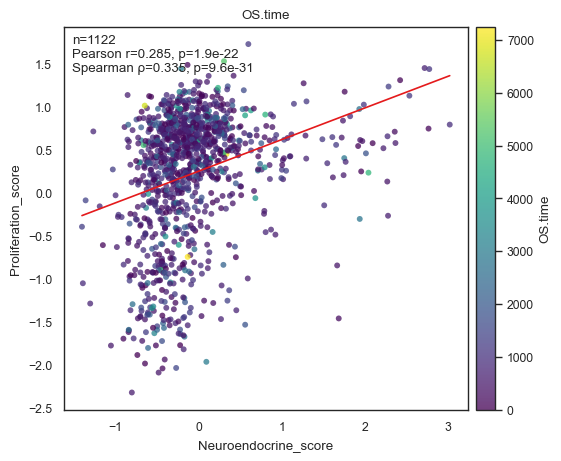

(<Figure size 550x450 with 2 Axes>,
 array([<Axes: title={'center': 'OS.time'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [54]:
#Color by numerical metadata
bk.pl.corrplot_obs(
    adata_lung,
    x="Neuroendocrine_score",
    y="Proliferation_score",
    color="OS.time",
    cmap="viridis",
)

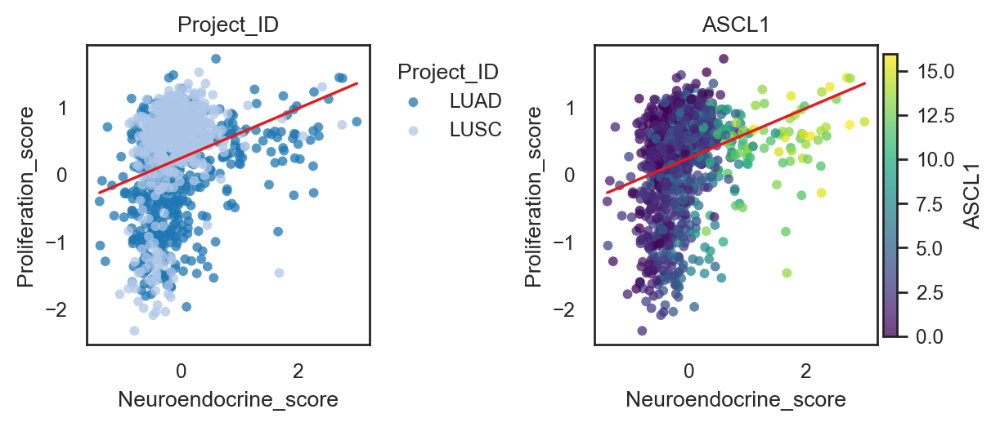

(<Figure size 1200x500 with 3 Axes>,
 array([<Axes: title={'center': 'Project_ID'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>,
        <Axes: title={'center': 'ASCL1'}, xlabel='Neuroendocrine_score', ylabel='Proliferation_score'>],
       dtype=object),
 [{'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168},
  {'n': 1122,
   'pearson_r': 0.28523160548334237,
   'pearson_p': 1.905213040533741e-22,
   'spearman_rho': 0.3345589990202715,
   'spearman_p': 9.555423767627166e-31,
   'slope': 0.3686198024643119,
   'intercept': 0.24858805823473168}])

In [43]:
# Using hue instead of color
bk.pl.corrplot_obs(adata_lung,     
                   x="Neuroendocrine_score",
                   y="Proliferation_score",
                   hue=["Project_ID", "ASCL1"],
                   annotate=False,
                   figsize=(3,2.5),
                  )

## 8.4. Statistics between categorical data

In [ ]:
one single function
Practical advice (bulk RNA-seq)
	•	Prefer Kruskal–Wallis over ANOVA (non-normal)
	•	Always report effect size, not only p-values
	•	For clusters: ARI + Cramér’s V together is ideal
	•	Avoid Pearson with categorical encodings

#### Gene ↔ categorical (screen genes associated with subtype)

In [56]:
dfg = bk.tl.gene_categorical_association(
    adata,
    genes=["DLL3", "SOX10", "CDC20"],
    groupby="Project_ID",
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)
dfg

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.0,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.0
1,Project_ID,SOX10,6122.513829,0.0,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.0
2,Project_ID,CDC20,6386.193160,0.0,0.605066,34,10534,"{'ACC': 7.902002597402596, 'BLCA': 11.04651675...",0.0


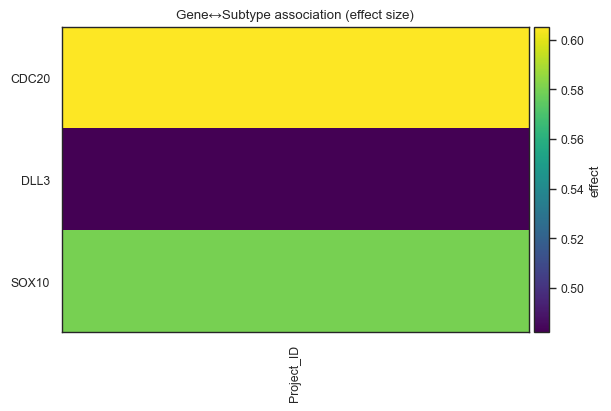

(<Figure size 600x400 with 2 Axes>,
 <Axes: title={'center': 'Gene↔Subtype association (effect size)'}>)

In [57]:
#Plot a heatmap of effects:
bk.pl.association_heatmap(
    dfg,
    index="gene",
    columns="groupby",
    values="effect",
    title="Gene↔Subtype association (effect size)",
)

#### Numeric obs ↔ categorical (which metadata differs across clusters)

In [46]:
dfo = bk.tl.categorical_association(
    adata,
    obs_keys=["Neuroendocrine_score"],                   # all numeric obs
    groupby="Project_ID",
    method="kruskal",
)
dfo.head(20)

TypeError: categorical_association() got an unexpected keyword argument 'obs_keys'

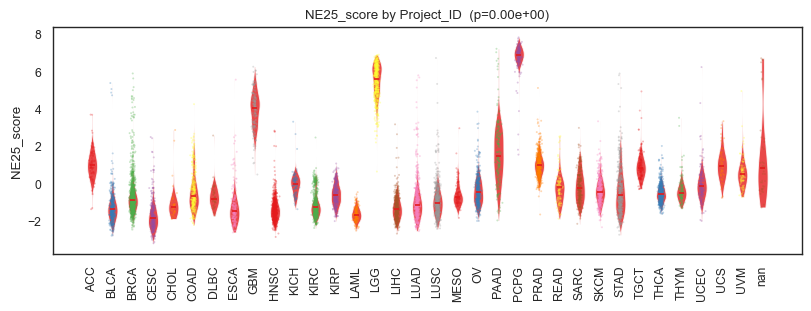

(<Figure size 800x300 with 1 Axes>,
 <Axes: title={'center': 'NE25_score by Project_ID  (p=0.00e+00)'}, ylabel='NE25_score'>)

In [59]:
#Plot one variable with a p-value:
bk.pl.boxplot_with_stats(
    adata,
    y="NE25_score",
    groupby="Project_ID",
    kind="violin",
    figsize=(8, 3),
)

In [60]:
dfo = bk.tl.obs_categorical_association(
    adata,
    obs_keys=["NE25_score"],                   # all numeric obs
    groupby="RB1_mut",
    method="kruskal",
)
dfo.head(20)

INFO: obs_categorical_association: 1 numeric obs vs RB1_mut (3 groups), method=kruskal


,groupby,obs,statistic,pval,effect,n_groups,n,group_means,qval
0,RB1_mut,NE25_score,18.260087,0.000108,0.001544,3,10534,"{'0.0': 0.04806304637641443, '1.0': -0.3658405...",0.000108


In [4]:
#Plot one variable with a p-value:
bk.pl.boxplot_with_stats(
    adata,
    y="NE25_score",
    groupby="RB1_mut",
    kind="violin",
    figsize=(8, 3),
)

NameError: name 'bk' is not defined

#### Categorical ↔ categorical (Project vs Leiden)

In [2]:
from typing import Literal, Sequence, Mapping, Any, Optional, Tuple
import numpy as np
import pandas as pd
import scipy.sparse as sp
import anndata as ad
from anndata import AnnData
from scipy.stats import spearmanr
from statsmodels.stats.multitest import multipletests

try:
    from scipy import stats
except Exception:  # pragma: no cover
    stats = None

def categorical_confusion(
    adata: ad.AnnData,
    *,
    key1: str,
    key2: str,
    normalize: Literal["none", "row", "col", "all"] = "row",
    cmap: str = "Blues",
    figsize: tuple[float, float] | None = None,
    title: str | None = None,
    save: str | Path | None = None,
    show: bool = True,
):
    """
    Confusion-style heatmap for two categorical obs columns + association metrics.

    Metrics (from categorical_association):
      - chi2
      - cramers_v
      - ari
      - nmi
    """
    #set_style()

    res = bk.tl.categorical_association(adata, key1=key1, key2=key2, ) #metrics=("chi2", "cramers_v", "ari", "nmi")
    tab: pd.DataFrame = res["table"].copy()

    mat = tab.to_numpy(dtype=float)

    if normalize == "row":
        mat = mat / np.maximum(mat.sum(axis=1, keepdims=True), 1.0)
    elif normalize == "col":
        mat = mat / np.maximum(mat.sum(axis=0, keepdims=True), 1.0)
    elif normalize == "all":
        mat = mat / np.maximum(mat.sum(), 1.0)

    if figsize is None:
        figsize = (max(6, 0.25 * tab.shape[1] + 3), max(4, 0.25 * tab.shape[0] + 2))

    fig, ax = plt.subplots(figsize=figsize, constrained_layout=True)
    im = ax.imshow(mat, aspect="auto", cmap=cmap, vmin=0, vmax=1 if normalize != "none" else None)

    ax.set_xticks(np.arange(tab.shape[1]))
    ax.set_xticklabels(tab.columns.tolist(), rotation=90)
    ax.set_yticks(np.arange(tab.shape[0]))
    ax.set_yticklabels(tab.index.tolist())

    crv = res.get("cramers_v", np.nan)
    ari = res.get("ari", np.nan)
    nmi = res.get("nmi", np.nan)

    ttl = title or f"{key1} vs {key2}"
    ttl += f" | Cramér’s V={crv:.3f}"
    if np.isfinite(ari):
        ttl += f" | ARI={ari:.3f}"
    if np.isfinite(nmi):
        ttl += f" | NMI={nmi:.3f}"
    ax.set_title(ttl)

    cbar = fig.colorbar(im, ax=ax, pad=0.01)
    cbar.set_label("fraction" if normalize != "none" else "count")

    if save is not None:
        _savefig(fig, save)
    if show:
        plt.show()
    return fig, ax

In [3]:
categorical_confusion(
    adata,
    key1="Project_ID",
    key2="leiden_0.8",
    normalize="row",
    figsize=(4.5, 4),
)

NameError: name 'adata' is not defined

In [63]:
# Run leiden to df
df = bk.tl.leiden_resolution_scan(
    adata,
    true_key="Project_ID",
    resolutions=[0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.5, 2.0],
    base_key="leiden",
)

INFO: Leiden resolution=0.2
INFO: Clustering with Leiden (resolution=0.2)
INFO: Leiden produced 16 clusters stored in adata.obs['leiden_0.2'].
INFO: Leiden resolution=0.4
INFO: Clustering with Leiden (resolution=0.4)
INFO: Leiden produced 21 clusters stored in adata.obs['leiden_0.4'].
INFO: Leiden resolution=0.6
INFO: Clustering with Leiden (resolution=0.6)
INFO: Leiden produced 23 clusters stored in adata.obs['leiden_0.6'].
INFO: Leiden resolution=0.8
INFO: Clustering with Leiden (resolution=0.8)
INFO: Leiden produced 25 clusters stored in adata.obs['leiden_0.8'].
INFO: Leiden resolution=1
INFO: Clustering with Leiden (resolution=1.0)
INFO: Leiden produced 27 clusters stored in adata.obs['leiden_1'].
INFO: Leiden resolution=1.2
INFO: Clustering with Leiden (resolution=1.2)
INFO: Leiden produced 30 clusters stored in adata.obs['leiden_1.2'].
INFO: Leiden resolution=1.5
INFO: Clustering with Leiden (resolution=1.5)
INFO: Leiden produced 33 clusters stored in adata.obs['leiden_1.5'].
INF

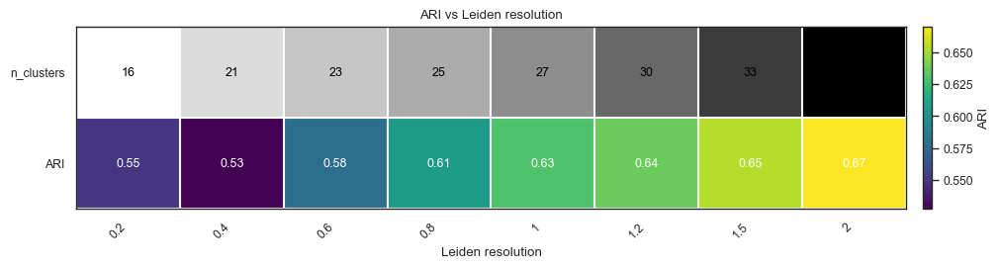

(<Figure size 1000x260 with 2 Axes>,
 <Axes: title={'center': 'ARI vs Leiden resolution'}, xlabel='Leiden resolution'>)

In [65]:
bk.pl.ari_resolution_heatmap(adata,
    df=df,
    metric="ARI",
    show_n_clusters=True,
    figsize=(10, 2.6),
    save="figs/ari_vs_resolution.png",
)

In [ ]:
Visualization:
You already have most pieces; add:
	•	bk.pl.association_heatmap() (genes × categories)
	•	bk.pl.boxplot_with_stats()
	•	bk.pl.categorical_confusion()


### 8.5. Associations

Association functions answer a broader statistical question: “Is variable X statistically associated with variable Y?”  

They are:  
- Symmetric (not inherently DE)
- Exploratory
- Model-light
- Often non-parametric  

Association functions generalize beyond genes. They work for:  
- gene ↔ category
- numeric obs ↔ category
- gene ↔ gene
- numeric obs ↔ numeric obs
- category ↔ category  

They are closer to EDA / statistics than DE.

#### bk.pl.gene_association()  
- automatic post-hoc (MWU + BH) and bracket annotation
- new effect-size aware volcano for categorical associations

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


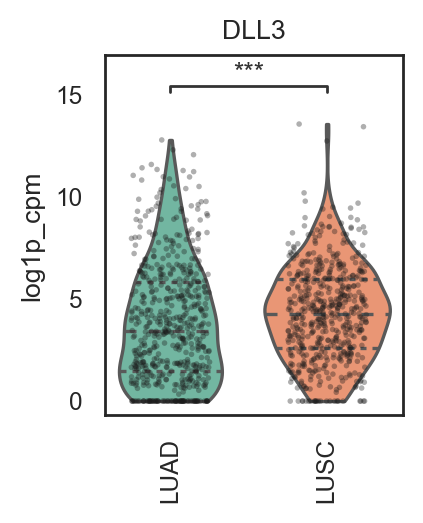

(<Figure size 400x500 with 1 Axes>,
 array([<Axes: title={'center': 'DLL3'}, ylabel='log1p_cpm'>], dtype=object))

In [61]:
bk.pl.gene_association(
    adata_lung,
    gene=["DLL3"],
    groupby="Project_ID",
    layer="log1p_cpm",
    rotate_xticklabels=90,
    annotate_posthoc=True,
    figsize=(2,2.5),
    #save="figs/gene_association.png",
)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)


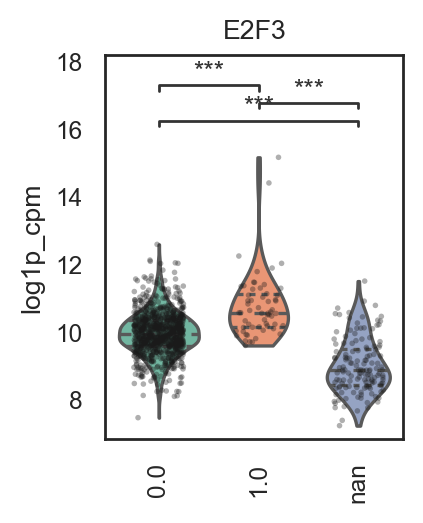

(<Figure size 400x500 with 1 Axes>,
 array([<Axes: title={'center': 'E2F3'}, ylabel='log1p_cpm'>], dtype=object))

In [47]:
bk.pl.gene_association(
    adata_lung,
    gene=["E2F3"],
    groupby="RB1_mut",
    layer="log1p_cpm",
    rotate_xticklabels=90,
    annotate_posthoc=True,
    figsize=(2,2.5),
    #save="figs/gene_association.png",
)

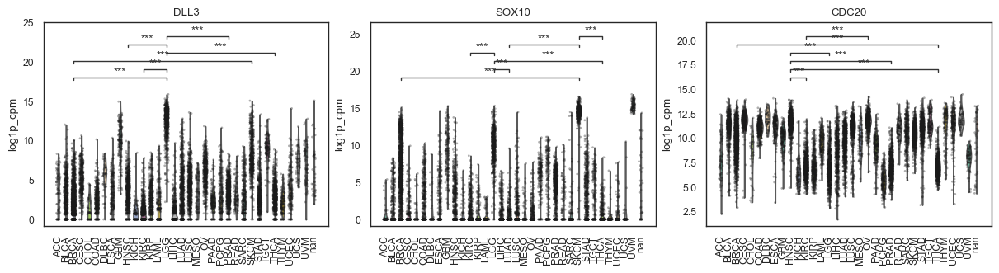

(<Figure size 1200x320 with 3 Axes>,
 array([<Axes: title={'center': 'DLL3'}, ylabel='log1p_cpm'>,
        <Axes: title={'center': 'SOX10'}, ylabel='log1p_cpm'>,
        <Axes: title={'center': 'CDC20'}, ylabel='log1p_cpm'>],
       dtype=object))

In [21]:
# Multiple genes (row of panels)
bk.pl.gene_association(
    adata,
    gene=["DLL3", "SOX10", "CDC20"],
    groupby="Project_ID",
    layer="log1p_cpm",
    rotate_xticklabels=90,
    figsize=(12.0, 3.2),  # per-panel size; total width = 3*4.0
    #save="figs/genes_by_ProjectID.png",
)

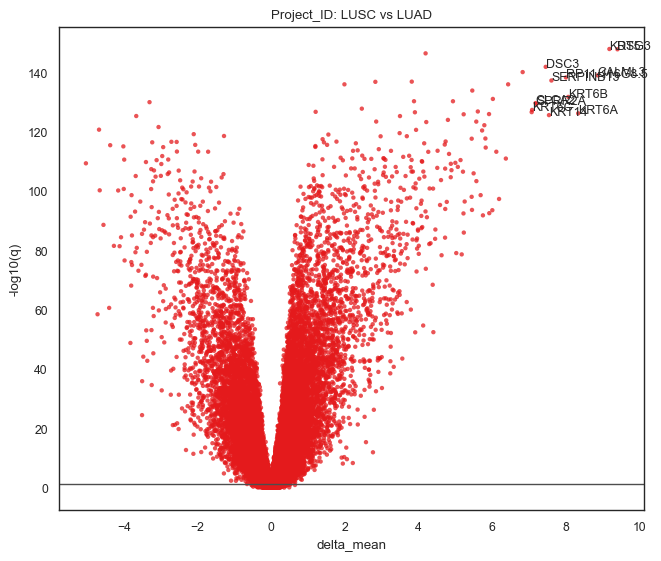

In [23]:
fig, ax, df = bk.pl.gene_association_volcano(
    adata,
    groupby="Project_ID",
    group="LUSC",
    reference="LUAD",   # or None for "rest"
    layer="log1p_cpm",
    alpha=0.05,
    #save="figs/assoc_volcano_SCLC_vs_LUAD.png",
)

In [24]:
df

,gene,effect,pval,qval,neglog10q
0,KRT5,9.191601,1.822702e-153,9.587959e-149,148.018274
1,DSG3,9.411068,4.580272e-153,1.204680e-148,147.919128
2,KRT74,4.195866,1.617996e-151,2.837049e-147,146.547133
3,DSC3,7.460600,7.749401e-147,1.019104e-142,141.991781
4,CERS3,6.834289,5.639659e-145,5.933259e-141,140.226707
...,...,...,...,...,...
52598,RP11-803A13.1,0.021460,9.906374e-01,1.000000e+00,-0.000000
52599,RPPH1-2P,0.000000,1.000000e+00,1.000000e+00,-0.000000
52600,RP11-656A10.1,0.000000,1.000000e+00,1.000000e+00,-0.000000
52601,LY6G6F,0.029988,9.885628e-01,1.000000e+00,-0.000000


#### Numerical - Categorical associations

In [35]:
# for numeric obs
y = pd.DataFrame({"y": adata.obs["purity"], "grp": adata.obs["Project_ID"]})
post = bk.tl.pairwise_posthoc(y, method="mwu")

In [27]:
post

,group1,group2,n1,n2,pval,effect,delta_mean,delta_median,qval
0,LUAD,OV,502,407,9.646718e-96,0.799891,-0.312945,-0.360,5.093467e-93
1,HNSC,OV,507,407,9.907419e-82,0.736117,-0.266157,-0.310,2.615558e-79
2,KIRC,OV,495,407,3.319469e-75,0.709180,-0.224717,-0.250,5.842265e-73
3,LGG,LUAD,511,502,7.938732e-75,-0.664294,0.251965,0.310,1.047913e-72
4,LUSC,OV,490,407,1.232161e-74,0.708068,-0.262391,-0.310,1.301162e-72
...,...,...,...,...,...,...,...,...,...
523,GBM,SARC,152,245,9.451089e-01,0.004135,0.016170,0.010,9.523235e-01
524,ACC,KICH,75,66,9.521921e-01,0.006061,-0.002412,-0.005,9.576332e-01
525,MESO,PRAD,81,471,9.750282e-01,0.002202,-0.000010,0.030,9.783327e-01
526,COAD,READ,282,89,9.764798e-01,0.002112,-0.005677,0.015,9.783327e-01


### Categorical - Categorical associations

In [32]:
cc = bk.tl.cat_cat_association(adata, key1="NE25_score", key2="Neuroendocrine_score")
cc

,key1,key2,chi2,dof,pval,cramers_v,n,qval
0,NE25_score,Neuroendocrine_score,1.109546e+08,110944089,0.239743,1.0,10534,NaN


#### A. Gene ↔ categorical, then rankplot

In [42]:
df = bk.tl.gene_categorical_association(
    adata,
    genes=["RB1", "TP53", "CCND1"],                 # All genes if None. Select one gene or a list of genes
    groupby="Project_ID",
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)
df

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,RB1,3969.506481,0.0,0.374905,34,10534,"{'ACC': 10.68782077922078, 'BLCA': 10.34634444...",0.0
1,Project_ID,TP53,2616.633303,0.0,0.246060,34,10534,"{'ACC': 10.217851948051948, 'BLCA': 11.1615268...",0.0
2,Project_ID,CCND1,3885.406876,0.0,0.366896,34,10534,"{'ACC': 12.109411688311692, 'BLCA': 12.6106368...",0.0


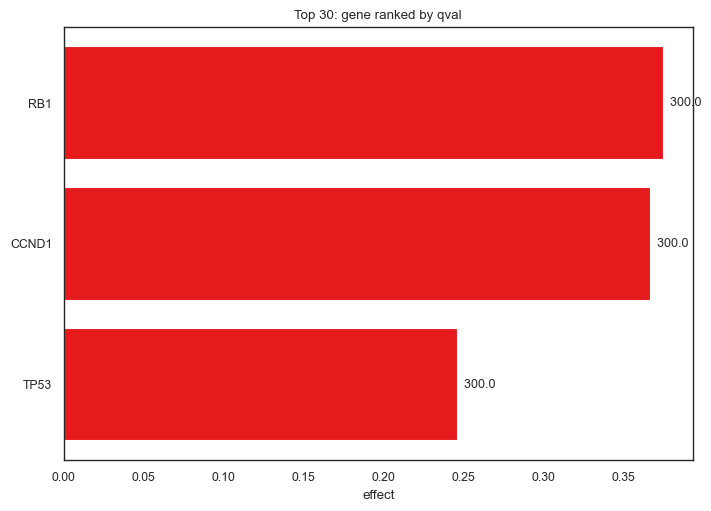

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 30: gene ranked by qval'}, xlabel='effect'>)

In [43]:
bk.pl.rankplot_association(df, feature_col="gene", score_col="effect", p_col="qval", top_n=30)

#### B) Numeric obs ↔ categorical + posthoc

In [44]:
dfo = bk.tl.obs_categorical_association(
    adata,
    obs_keys=["purity", "age_at_diagnosis"],
    groupby="Project_ID",
    method="kruskal",
)

INFO: obs_categorical_association: 1 numeric obs vs Project_ID (34 groups), method=kruskal


In [45]:
# pick one obs and do pairwise
tmp = pd.DataFrame({"y": adata.obs["purity"], "grp": adata.obs["Project_ID"]})
post = bk.tl.pairwise_posthoc(tmp, method="mwu")
post.head(10)

,group1,group2,n1,n2,pval,effect,delta_mean,delta_median,qval
0,LUAD,OV,502,407,9.646718e-96,0.799891,-0.312945,-0.36,5.093467e-93
1,HNSC,OV,507,407,9.907419e-82,0.736117,-0.266157,-0.31,2.615558e-79
2,KIRC,OV,495,407,3.319469e-75,0.709180,-0.224717,-0.25,5.842265e-73
3,LGG,LUAD,511,502,7.938732e-75,-0.664294,0.251965,0.31,1.047913e-72
4,LUSC,OV,490,407,1.232161e-74,0.708068,-0.262391,-0.31,1.301162e-72
5,LUAD,THCA,502,469,9.531360e-68,0.645083,-0.233131,-0.23,8.387597e-66
6,OV,STAD,407,402,3.597096e-65,-0.692477,0.261110,0.29,2.713238e-63
7,BRCA,OV,1049,407,1.749028e-63,0.567221,-0.186443,-0.21,1.154359e-61
8,KIRP,LUAD,283,502,5.257696e-62,-0.713535,0.269181,0.32,3.084515e-60
9,HNSC,LGG,507,511,1.681618e-58,0.583834,-0.205178,-0.26,8.878945e-57


#### C) Dotplot/heatmap across multiple “groupby” runs

In [47]:
df1 = bk.tl.gene_categorical_association(adata, genes=["DLL3","SOX10"], groupby="Project_ID")
df2 = bk.tl.gene_categorical_association(adata, genes=["DLL3","SOX10"], groupby="Gender")

df_all = pd.concat([df1, df2], ignore_index=True)
df_all

INFO: gene_categorical_association: 2 genes vs Project_ID (34 groups), method=kruskal
INFO: gene_categorical_association: 2 genes vs Gender (3 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.000000,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.000000
1,Project_ID,SOX10,6122.513829,0.000000,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.000000
2,Gender,DLL3,3.436054,0.179420,0.000136,3,10534,"{'Female': 4.0029334938021375, 'Male': 4.08044...",0.358840
3,Gender,SOX10,0.520377,0.770906,0.000000,3,10534,"{'Female': 3.4830637846511987, 'Male': 3.41812...",0.770906


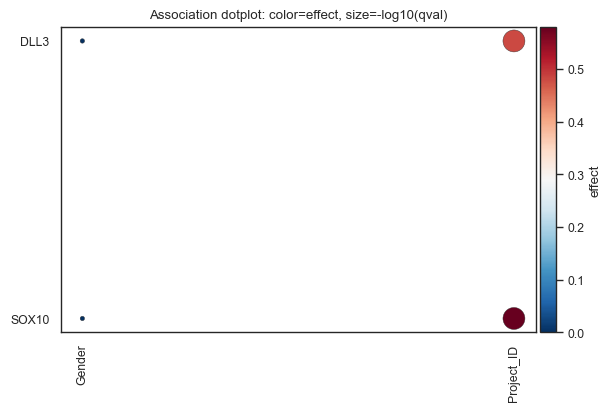

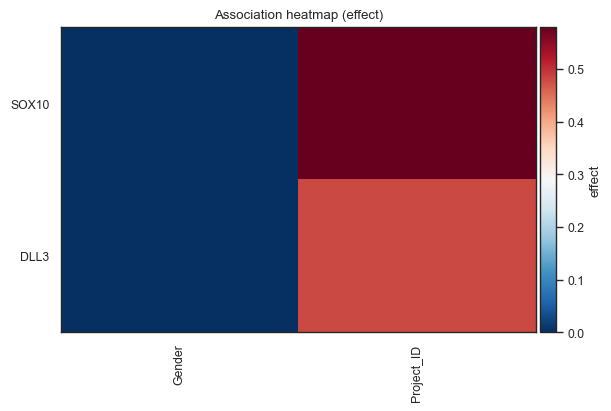

(<Figure size 600x400 with 2 Axes>,
 <Axes: title={'center': 'Association heatmap (effect)'}>)

In [48]:
bk.pl.dotplot_association(df_all, feature_col="gene", groupby_col="groupby", top_n=50)
bk.pl.heatmap_association(df_all, feature_col="gene", groupby_col="groupby", value_col="effect", top_n=40)

#### A) genes ↔ categorical obs (rank + plot)

In [49]:
df = bk.tl.gene_categorical_association(
    adata,
    groupby="Project_ID",
    genes=["DLL3", "SOX10", "CDC20"],
    layer="log1p_cpm",
    method="kruskal",
    effect_size="epsilon2",
)

df

INFO: gene_categorical_association: 3 genes vs Project_ID (34 groups), method=kruskal


,groupby,gene,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,DLL3,5096.269017,0.0,0.482216,34,10534,"{'ACC': 3.573218181818182, 'BLCA': 3.314960179...",0.0
1,Project_ID,SOX10,6122.513829,0.0,0.579954,34,10534,"{'ACC': 0.36864545454545455, 'BLCA': 1.5780221...",0.0
2,Project_ID,CDC20,6386.193160,0.0,0.605066,34,10534,"{'ACC': 7.902002597402596, 'BLCA': 11.04651675...",0.0


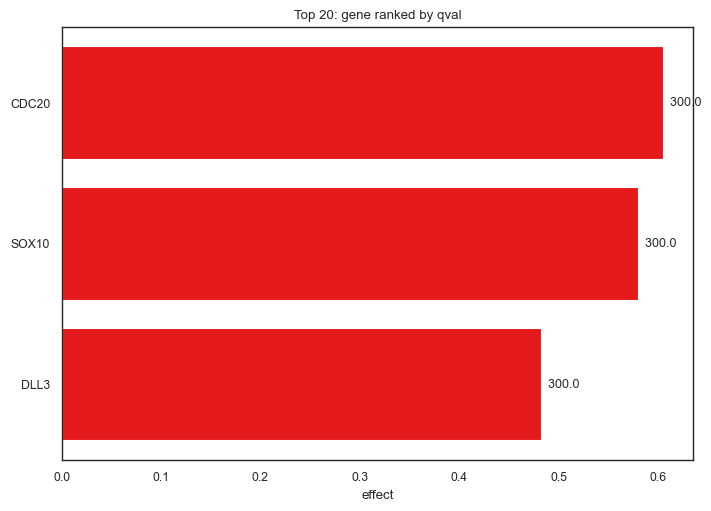

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 20: gene ranked by qval'}, xlabel='effect'>)

In [50]:
bk.pl.rankplot_association(df, feature_col="gene", score_col="effect", p_col="qval", top_n=20)

#### B) numeric obs ↔ categorical obs

In [51]:
dfo = bk.tl.obs_categorical_association(
    adata,
    groupby="Project_ID",
    obs_keys=["purity", "NE25_score"],
    method="kruskal",
)
dfo

INFO: obs_categorical_association: 2 numeric obs vs Project_ID (34 groups), method=kruskal


,groupby,obs,statistic,pval,effect,n_groups,n,group_means,qval
0,Project_ID,purity,2009.295595,0.0,0.212619,34,9329,"{'ACC': 0.8221333333333333, 'BLCA': 0.60684343...",0.0
1,Project_ID,NE25_score,5890.059108,0.0,0.557815,34,10534,"{'ACC': 1.0220554141041098, 'BLCA': -1.2558328...",0.0


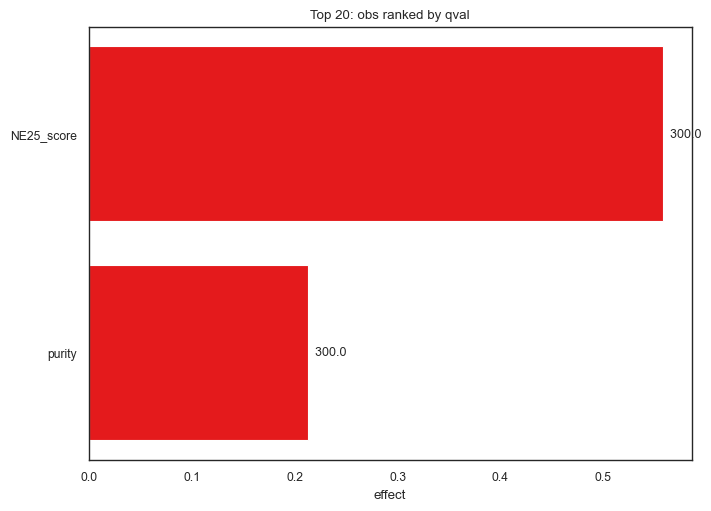

(<Figure size 700x500 with 1 Axes>,
 <Axes: title={'center': 'Top 20: obs ranked by qval'}, xlabel='effect'>)

In [52]:
bk.pl.rankplot_association(dfo, feature_col="obs", score_col="effect", p_col="qval", top_n=20)

# 9. Markers and Differential expression
<a id="de"></a>

## 9.1. Marker genes

Which genes are differentially expressed between groups?  
Based on Differential expression (DE). Similar to Scanpy rank_genes_groups (group vs rest, etc.)
#rank_genes_groups

### 9.1.1. Every groups versus the rest

In [23]:
#Everyone versus the rest
bk.tl.rank_genes_groups(
    adata,
    groupby="Project_ID",
    layer="log1p_cpm",
    method="t-test",
    n_genes=50,
)

INFO: rank_genes_groups: groupby='Project_ID', method='t-test', layer='log1p_cpm', reference='rest', n_genes=50
INFO: rank_genes_groups: stored results in adata.uns['rank_genes_groups']


In [24]:
# Get the results for a group
df_lumb = bk.get.rank_genes_groups_df(adata, group="LUAD", sort_by="scores")
df_lumb.head()

,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,SFTPB,104.414715,19.480293,0.0,0.0,16.881305,3.378595
1,NKX2-1,103.835826,13.934064,0.0,0.0,11.743011,2.084654
2,SFTA3,98.559444,14.346238,0.0,0.0,11.594436,1.650381
3,SFTA2,95.571088,12.737869,0.0,0.0,11.479025,2.649807
4,SLC34A2,85.073474,12.129740,0.0,0.0,15.283845,6.876150


In [25]:
# Get the results for all groups
df_all = bk.get.rank_genes_groups_df_all(adata)
df_all.head()

,group,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,ACC,STAR,51.271787,18.752414,1.671393e-61,3.663345e-59,16.582610,3.584427
1,ACC,NR5A1,48.126282,17.582484,2.449793e-59,4.956402e-57,13.742514,1.555265
2,ACC,SULT2A1,41.167587,18.032900,1.625689e-54,2.689186e-52,13.736112,1.236658
3,ACC,CYP11A1,40.627762,15.326728,6.047854e-54,9.728907e-52,14.978512,4.354833
4,ACC,SERPINA5,39.269236,12.498863,2.771207e-54,4.541240e-52,15.053103,6.389551


In [60]:
# export
df_all.to_csv(DESKTOP + "rank_genes_groups_all.tsv", sep="\t", index=False)

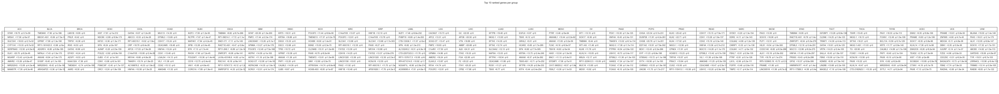

(<Figure size 11060x1060 with 1 Axes>,
 <Axes: title={'center': 'Top 10 ranked genes per group'}>)

In [65]:
# Quick table view
bk.pl.rank_genes_groups(adata, n_genes=10, save=DESKTOP + "rank_genes_groups_table.png")

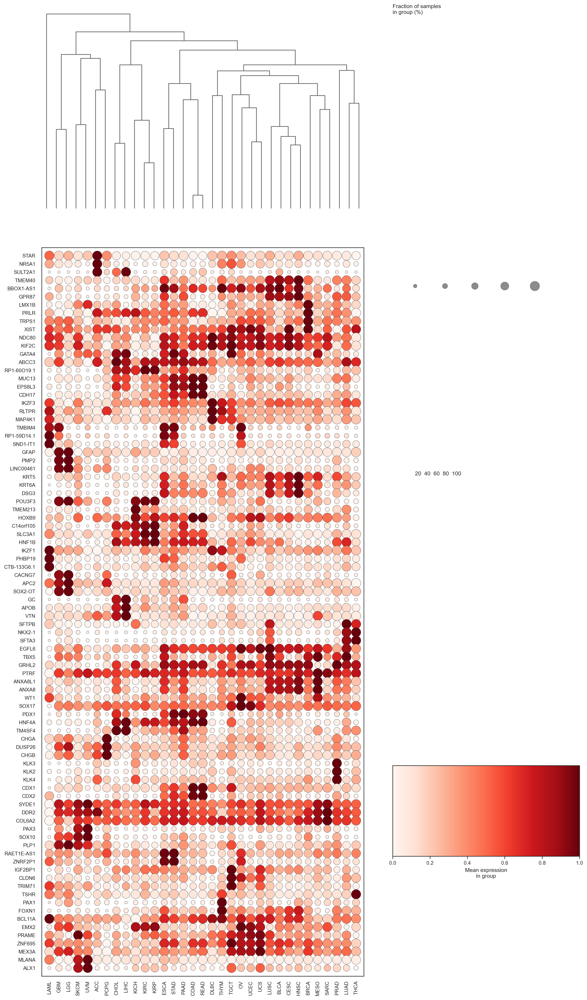

(<Figure size 4020x7912 with 4 Axes>, <Axes: >)

In [27]:
#3. Dotplot of top markers per group

bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=3,
    swap_axes=True,
    dendrogram_top=True,
    #figsize=(4,4),
    #save="figs/rank_genes_groups_dotplot.png",
)

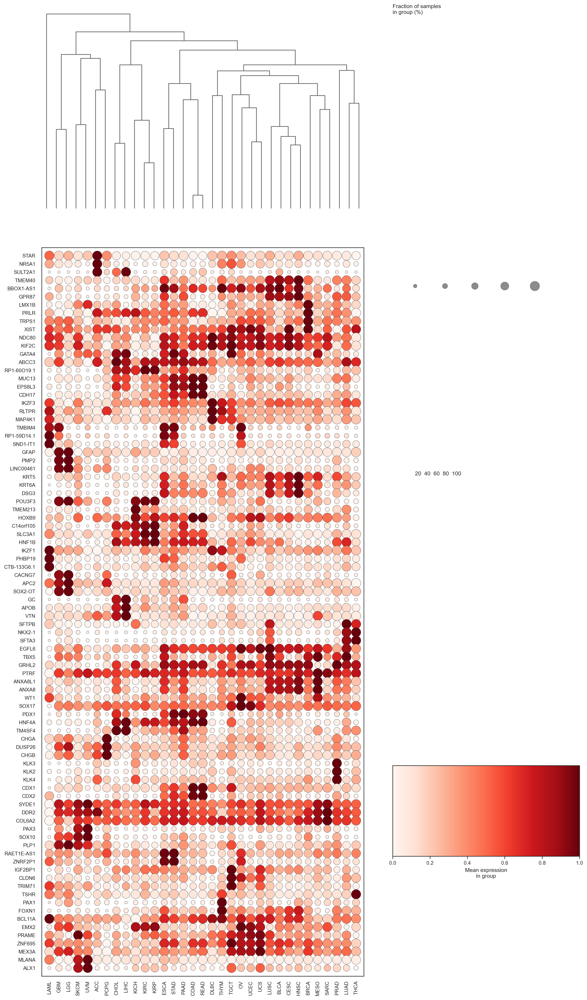

(<Figure size 4020x7912 with 4 Axes>, <Axes: >)

In [68]:
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=3,
    swap_axes=True,
    dendrogram_top=True,
    dendrogram_rows=False,
    #save="figs/rank_genes_groups_dotplot.png",
)

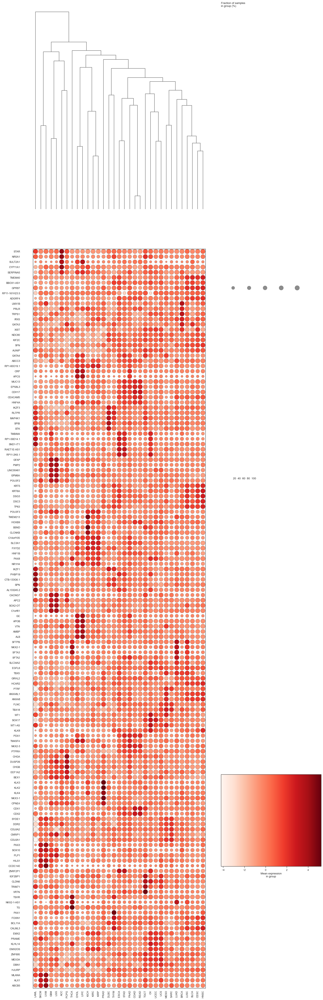

(<Figure size 2155x8010 with 4 Axes>, <Axes: >)

In [71]:
#A. Scanpy-like expression dotplot (auto standard_scale=“var”)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="expression",
    standard_scale="auto",
    #save="figs/rgg_dotplot_expression.png",
)

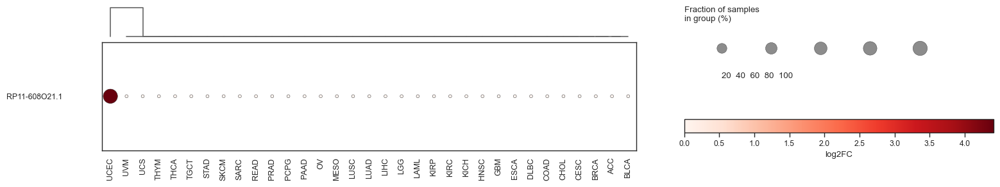

(<Figure size 2155x380 with 4 Axes>, <Axes: >)

In [73]:
#B. B) Color by log2FC (still sizes by fraction from counts)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="logfoldchanges",
    min_in_group_fraction=0.05,
    max_in_group_fraction=0.95,
    #save="figs/rgg_dotplot_logFC.png",
)

### 8.1.2. One group or a few groups versus other group

In [70]:
# Group versus specific reference
bk.tl.rank_genes_groups(
    adata,
    groupby="Project_ID",
    groups=["LUAD", "LUSC"],
    reference="BRCA",
    layer="log1p_cpm",
    method="wilcoxon",
    n_genes=50,
)

INFO: rank_genes_groups: groupby='Project_ID', method='wilcoxon', layer='log1p_cpm', reference='BRCA', n_genes=50
INFO: rank_genes_groups: stored results in adata.uns['rank_genes_groups']


Get the genes from `adata.uns['rank_genes_groups']` into a dataframe

In [75]:
df_lumb = bk.get.rank_genes_groups_df(adata, group="LUAD", sort_by="scores") 
df_lumb.head()

,gene,scores,log2FC,pval,qval,mean_group,mean_ref
0,SFTPB,34.073980,21.689591,6.864576e-255,1.504572e-251,16.881305,1.847226
1,SFTA3,34.066951,16.289189,7.163340e-302,5.383046e-298,11.594436,0.303630
2,NKX2-1,34.047337,16.410986,0.000000e+00,0.000000e+00,11.743011,0.367782
3,SFTA2,33.987364,14.910638,3.877076e-258,9.711707e-255,11.479025,1.143758
4,HNF1B,33.916282,12.553734,2.321304e-261,7.182798e-258,9.449643,0.748057


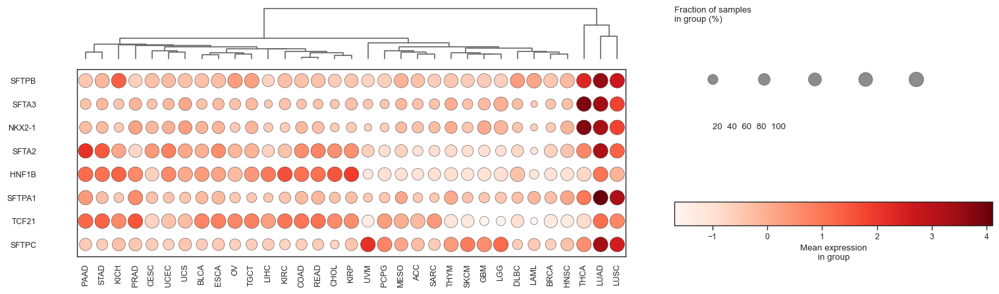

(<Figure size 2155x640 with 4 Axes>, <Axes: >)

In [76]:
#A. Scanpy-like expression dotplot (auto standard_scale=“var”)
bk.pl.rank_genes_groups_dotplot(
    adata,
    groupby="Project_ID",
    n_genes=5,
    values_to_plot="expression",
    
    standard_scale="auto",
    #save="figs/rgg_dotplot_expression.png",
)

## 9.2. Differential expression

For bulk RNA-seq, the two most useful layers are:  
	•	a fast exploratory DE (like Scanpy’s “rank genes” idea) → Welch t-test on log1p_cpm  
	•	a proper bulk model → Negative Binomial GLM (DESeq2/edgeR spirit) on raw counts with library-size offset. Important: requires raw counts

Quick best-practice recommendation. Use:  
- Welch_ttest for fast exploration and ranking  
- NB GLM only if we either (a) estimate alpha properly, or (b) accept that it’s an approximate baseline  

#### Define comparison

Select column to select groups from and groups

In [71]:
adata.obs.RB1_mut = adata.obs.RB1_mut.astype("category")
adata.obs.RB1_mut.value_counts()

RB1_mut
0.0    8127
1.0     336
Name: count, dtype: int64

In [72]:
dataset = adata                                    # adata, adata_lung
dataname = "TCGA"                                  # TCGA, TCGA_lung
column = "RB1_mut"                                 # e,g, "Project_ID", "RB1_mut"
groupA = "1.0"                                     # e.g. "LUAD", "1.0"
groupB = "0.0"                                     # e.g. "LUSC", "0.0"

comparison = f"{column}_{groupA}_vs_{groupB}"
comparison

'RB1_mut_1.0_vs_0.0'

In [28]:
dataset = adata_lung                                    # adata, adata_lung
dataname = "TCGA"                                  # TCGA, TCGA_lung
column = "Project_ID"                                 # e,g, "Project_ID", "RB1_mut"
groupA = "LUSC"                                     # e.g. "LUAD", "1.0"
groupB = "LUAD"                                     # e.g. "LUSC", "0.0"

comparison = f"{column}_{groupA}_vs_{groupB}"
comparison

'Project_ID_LUSC_vs_LUAD'

### 8.2.1. Non-count based, log data: t-test, wilcoxon o welch t-test

In [29]:
# Fast exploratory (recommended first)
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB,
    method="welch_ttest",         # wilcoxon  ---> explicitly non-count-based
    layer_expr="log1p_cpm",       # log
)

INFO: DE (welch_ttest) on layer='log1p_cpm'
INFO: Stored DE results (welch_ttest) in adata.uns['de']['Project_ID_LUSC_vs_LUAD'].


In [30]:
res = adata.uns["de"][comparison]["results"]
res.head(10)

,gene,log2FC,t,pval,qval,mean_group,mean_ref
14572,KRT5,9.191601,47.521890,9.800940e-263,5.155588e-258,15.743748,6.552147
33474,DSG3,9.411068,48.064286,1.036572e-251,2.726340e-247,11.688935,2.277868
48261,DSC3,7.460600,44.709548,1.774872e-245,3.112120e-241,12.023859,4.563259
51179,BNC1,6.439554,42.130864,1.786175e-220,2.348954e-216,8.997605,2.558050
16752,CALML3,8.876753,42.641936,8.358320e-220,8.793454e-216,11.281268,2.404515
39064,S1PR5,3.820233,40.410457,4.776334e-215,4.187492e-211,8.542018,4.721786
12836,CERS3,6.834289,43.685538,2.948562e-207,2.215760e-203,8.025992,1.191702
47756,RP11-116G8.5,8.010116,42.322445,3.307243e-203,2.174636e-199,9.047214,1.037098
8049,KRT6B,8.074337,38.288022,1.569461e-202,9.173148e-199,11.833138,3.758801
4817,TP63,5.615544,38.262135,2.993022e-201,1.574420e-197,12.883407,7.267863


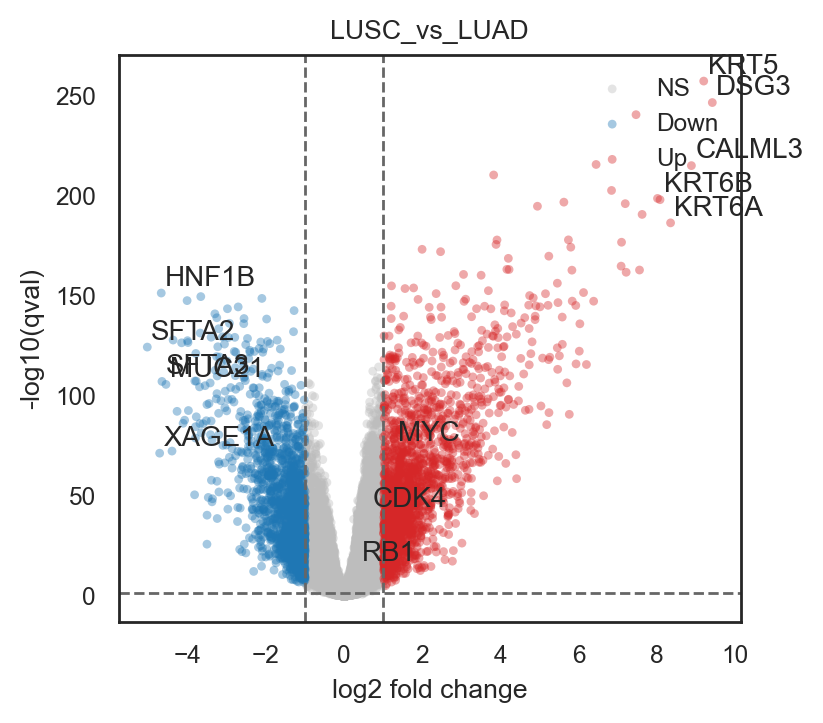

(<Figure size 800x700 with 1 Axes>,
 <Axes: title={'center': 'LUSC_vs_LUAD'}, xlabel='log2 fold change', ylabel='-log10(qval)'>)

In [31]:
bk.pl.volcano(res, title="LUSC_vs_LUAD", 
              alpha=0.4,
              top_n_labels = 5,                             # int
              bottom_n_labels = 5,
              label_genes = ["RB1", "MYC", "CDK4"],        #: Sequence[str] = (),
              label_offset=(0.1, 0.8),
              p_cutoff = 0.05,
              fc_cutoff = 1.0,              # optional, set >0 to require |log2FC| >= fc_cutoff
              point_size=10,
              figsize=(4,3.5),
              #save="volcano.png"
             )

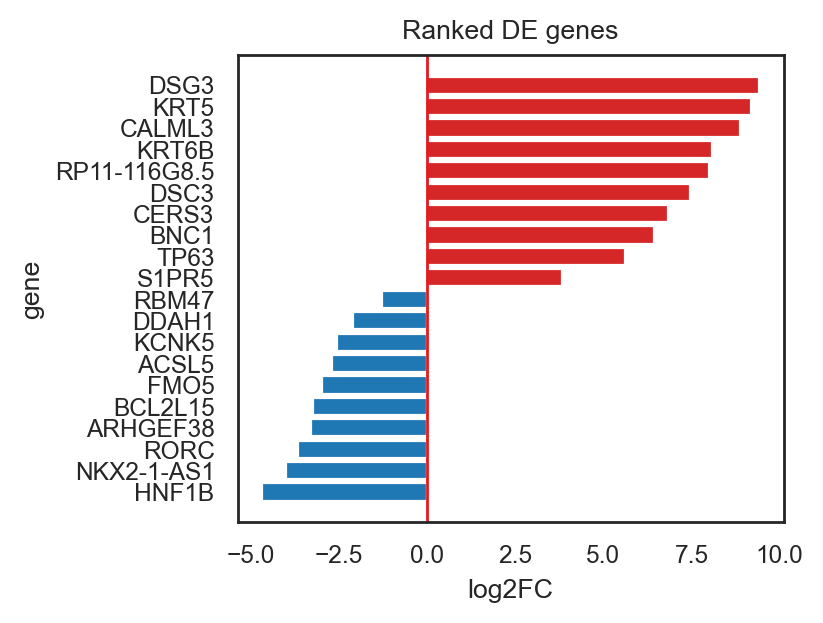

(<Figure size 800x600 with 1 Axes>,
 <Axes: title={'center': 'Ranked DE genes'}, xlabel='log2FC', ylabel='gene'>)

In [98]:
bk.pl.rankplot(res=res, n_genes=20, 
               direction="both", 
               sort_by="qval",               # or pval or log2FC
               figsize=(4, 3),
              )       #save="rankplot.png"

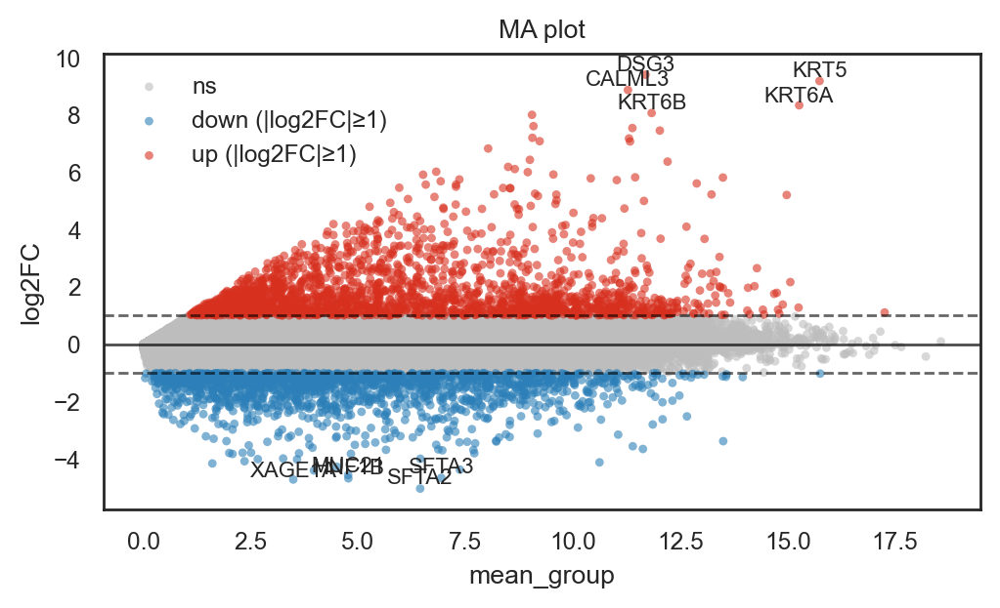

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'MA plot'}, xlabel='mean_group', ylabel='log2FC'>)

In [101]:
bk.pl.ma(
    result=res,
    mean_col="mean_group",
    fc_col="log2FC",
    top_n_labels=5,
    bottom_n_labels=5,
    min_abs_fc = 1.0,
    figsize=(5,3),
    #label_genes=["DLL3", "SOX10", "CDC20"],
)

### 8.2.2. NB Model (DESeq-like) requires raw counts

NB Model  
This is DESeq2-like, not a full DESeq2 reimplementation:  
	•	DESeq2 does more sophisticated dispersion fitting + shrinkage + outlier handling.  
	•	But for many cohorts, this is already a big leap from “alpha=1”.  

In [ ]:
# Proper NB model (bulk) --- Requires raw counts

bk.tl.de(
    adata,
    groupby="Project_ID",
    group="LUAD",
    reference="LUSC",
    method="nb_glm",
    #layer_counts="counts",
    layer_expr="log1p_cpm",
    shrink_dispersion=True,
    prior_df=10.0,
)

res = adata.uns["de"]["LUAD_vs_LUSC"]["results"]
res.head(20)

#### multi-factor DE with a design matrix + contrasts, bulk-style.  
We’ll implement:  
	•	bk.tl.de_glm(...) using NB GLM + DESeq2-like size factors + dispersion (the improved engine),  
	•	supports formulas like ~ Subtype + Batch (and later interactions),  
	•	and a contrast like ("Subtype", "Basal", "Luminal").  

This is the bulk equivalent of “design matrix + contrast” from DESeq2/edgeR/limma.  

In [ ]:
# Make sure covariates are categorical where appropriate
adata.obs["Subtype_PAM50"] = adata.obs["Subtype_PAM50"].astype("category")
adata.obs["Batch"] = adata.obs["Batch"].astype("category")   # if you have it

In [ ]:
# Run DE adjusted for Batch
bk.tl.de_glm(
    adata,
    formula="~ Subtype_PAM50 + Batch",
    contrast=("Subtype_PAM50", "LumB", "LumA"),
    layer_counts="counts",
    shrink_dispersion=True,
    prior_df=10.0,
)
res = adata.uns["de_glm"]["Subtype_PAM50:LumB_vs_LumA"]["results"]
res.head(25)

In [ ]:
# If you don’t have Batch, just:
bk.tl.de_glm(
    adata,
    formula="~ Subtype_PAM50",
    contrast=("Subtype_PAM50", "LumB", "LumA"),
)

In [ ]:
res.query("qval < 0.05").head(20)

This initial formula parser supports ~ A + B + C with:  
	•	categorical → dummy-coded (reference = first category)  
	•	numeric → included as-is  

No interactions yet (A:B) and no random effects. If you later want patient-paired designs, we’ll add that as a dedicated mode.  

If you tell me your typical covariates (Batch, sex, site, patient ID?), I’ll harden the defaults for your use case.  

If results are stored in adata.uns["de_glm"]

# 10. Pathway and Gene Set Enrichment Analysis
<a id="go"></a>

## 10.1. GSEA

In [32]:
# as define above:
print(dataname + "/" + comparison)

TCGA/Project_ID_LUSC_vs_LUAD


In [33]:
GENESETS = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/Public_Data/Signatures & GeneSets/GSEA_genesets/2024/"

In [34]:
df_gsea, pre_res = bk.tl.gsea_preranked(
    adata,
    res=res,
    comparison=comparison,
    score_col="t",                                       # # good default for preranked
    gene_sets=["hallmark"],                              # ["hallmark", "c2"] also as a list... convenience aliases
    #gene_sets=[GENESETS + "h.all.v2024.1.Hs.symbols.gmt"],        # if saved locally from MSigDB
    #gene_sets=[GENESETS + "h.all.v2024.1.Hs.symbols.gmt", GENESETS + "c2.cp.v2024.1.Hs.symbols.gmt",]   # list
    outdir="figs/gsea",
    return_pre_res=True,
)

# later: concatenate across comparisons
# all_gsea = pd.concat([df_gsea_1, df_gsea_2, ...])

INFO: Running GSEApy prerank: comparison=Project_ID_LUSC_vs_LUAD n_genes=51916 outdir=figs/gsea/Project_ID_LUSC_vs_LUAD
2026-01-25 22:03:44,669 [WARNING] Duplicated values found in preranked stats: 1.62% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


In [35]:
df_gsea.head(3)

,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,Project_ID_LUSC_vs_LUAD,0,prerank,MSigDB_Hallmark_2020__E2F Targets,0.801496,3.036075,0.0,0.0,0.0,151/195,12.34%,TFRC;TRA2B;MCM5;RPA1;PHF5A;MCM2;CSE1L;NCAPD2;G...
1,Project_ID_LUSC_vs_LUAD,1,prerank,MSigDB_Hallmark_2020__Myc Targets V1,0.779119,2.938326,0.0,0.0,0.0,149/194,15.48%,TRA2B;CNBP;NCBP2;RFC4;MCM5;TCP1;MCM2;FBL;RANBP...
2,Project_ID_LUSC_vs_LUAD,2,prerank,MSigDB_Hallmark_2020__G2-M Checkpoint,0.776187,2.922033,0.0,0.0,0.0,143/190,12.68%,TRA2B;MCM5;KATNA1;MCM2;UCK2;UBE2S;MYC;CHAF1A;P...


In [36]:
pre_res.res2d.head(3)

,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,prerank,MSigDB_Hallmark_2020__E2F Targets,0.801496,3.036075,0.0,0.0,0.0,151/195,12.34%,TFRC;TRA2B;MCM5;RPA1;PHF5A;MCM2;CSE1L;NCAPD2;G...
1,prerank,MSigDB_Hallmark_2020__Myc Targets V1,0.779119,2.938326,0.0,0.0,0.0,149/194,15.48%,TRA2B;CNBP;NCBP2;RFC4;MCM5;TCP1;MCM2;FBL;RANBP...
2,prerank,MSigDB_Hallmark_2020__G2-M Checkpoint,0.776187,2.922033,0.0,0.0,0.0,143/190,12.68%,TRA2B;MCM5;KATNA1;MCM2;UCK2;UBE2S;MYC;CHAF1A;P...


In [37]:
terms = pre_res.res2d.Term
terms

0                     MSigDB_Hallmark_2020__E2F Targets
1                  MSigDB_Hallmark_2020__Myc Targets V1
2                 MSigDB_Hallmark_2020__G2-M Checkpoint
3                  MSigDB_Hallmark_2020__Myc Targets V2
4                MSigDB_Hallmark_2020__mTORC1 Signaling
5                      MSigDB_Hallmark_2020__DNA Repair
6       MSigDB_Hallmark_2020__Interferon Alpha Response
7                 MSigDB_Hallmark_2020__Mitotic Spindle
8       MSigDB_Hallmark_2020__Interferon Gamma Response
9       MSigDB_Hallmark_2020__Unfolded Protein Response
10      MSigDB_Hallmark_2020__Oxidative Phosphorylation
11                    MSigDB_Hallmark_2020__p53 Pathway
12                    MSigDB_Hallmark_2020__Coagulation
13                     MSigDB_Hallmark_2020__Complement
14              MSigDB_Hallmark_2020__KRAS Signaling Dn
15     MSigDB_Hallmark_2020__Wnt-beta Catenin Signaling
16                        MSigDB_Hallmark_2020__Hypoxia
17              MSigDB_Hallmark_2020__KRAS Signa

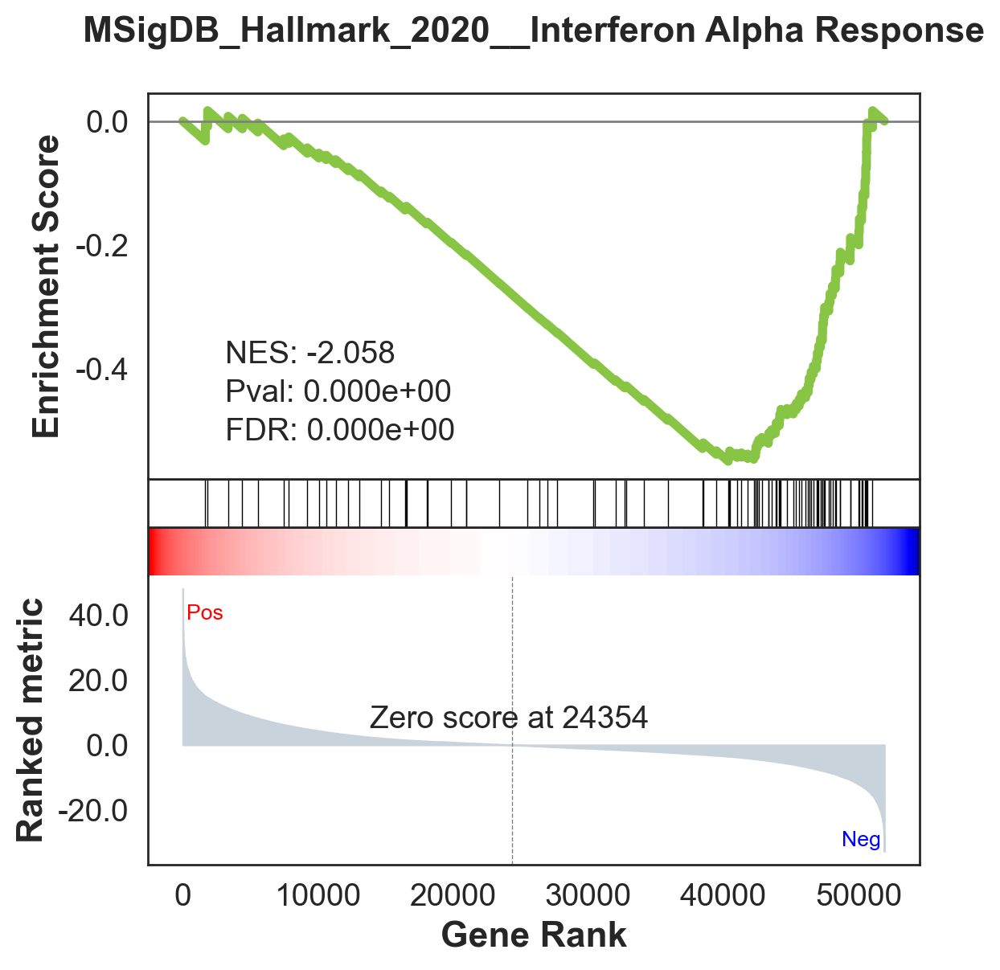

In [44]:
ax = pre_res.plot(terms=terms[6], figsize=(6, 6),) # v1.0.5

In [15]:
# plot to file
gseaplot(rank_metric=pre_res.ranking, term=terms[0], ofname=DESKTOP + 'your.plot.png', **pre_res.results[terms[0]])

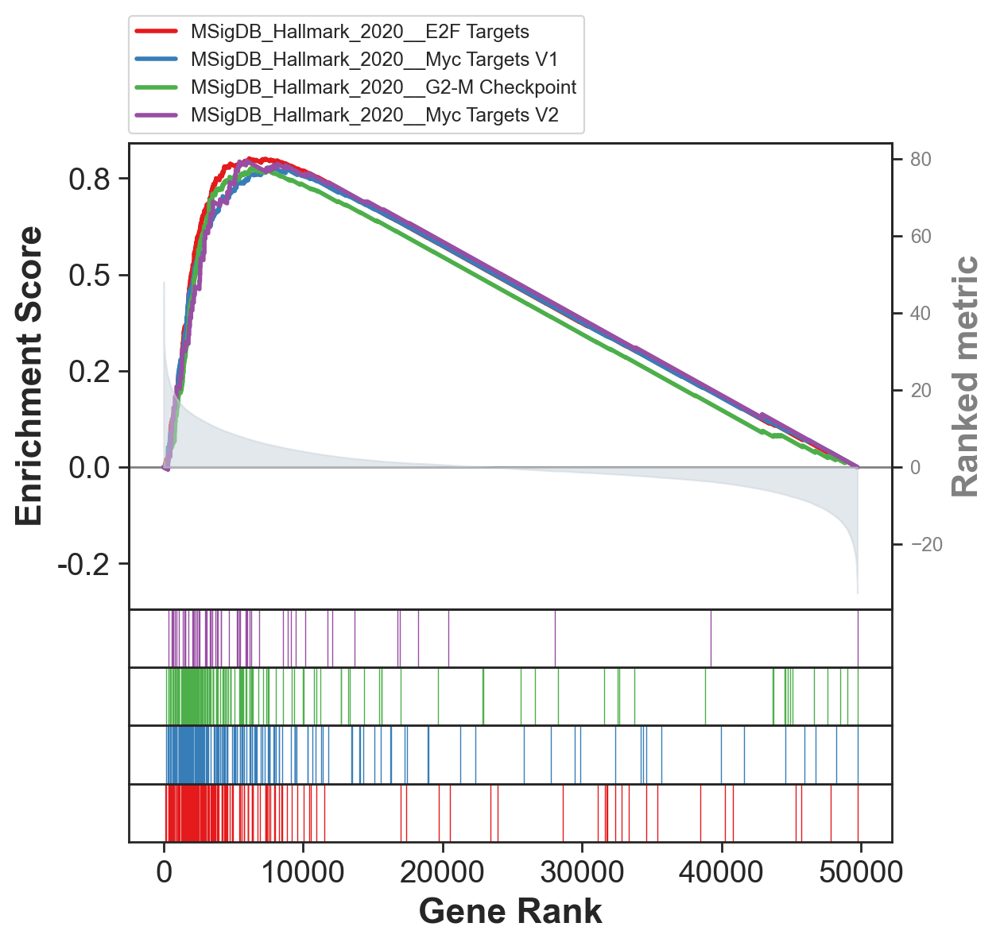

In [120]:
axs = pre_res.plot(terms=terms[0:4],
                   #legend_kws={'loc': (1.2, 0)}, # set the legend loc
                   show_ranking=True, # whether to show the second yaxis
                   figsize=(3,4)
                  )
# or use this to have more control on the plot
# from gseapy import gseaplot2
# terms = pre_res.res2d.Term[1:5]
# hits = [pre_res.results[t]['hits'] for t in terms]
# runes = [pre_res.results[t]['RES'] for t in terms]
# fig = gseaplot2(terms=terms, ress=runes, hits=hits,
#               rank_metric=gs_res.ranking,              # rank_metric=pre_res.ranking
#               legend_kws={'loc': (1.2, 0)},            # set the legend loc
#               figsize=(4,5))   

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


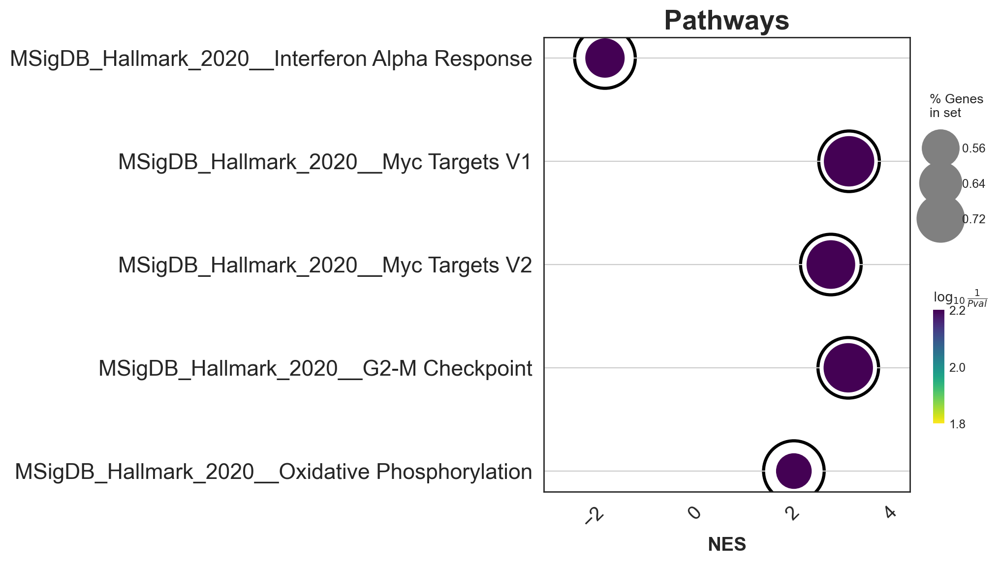

In [121]:
# categorical scatterplot
ax = gspy.dotplot(pre_res.res2d,
              column="NOM p-val",
              x='Gene_set', # set x axis, so you could do a multi-sample/library comparsion
              size=10,
              top_term=5,
              figsize=(6,6),
              title = "Pathways",
              xticklabels_rot=45, # rotate xtick labels
              show_ring=True, # set to False to revmove outer ring
              marker='o',
             )

In [22]:
# to save your figure, make sure that ``ofname`` is not None
ax = gspy.dotplot(pre_res.res2d,
             column="NOM p-val",                             #“Adjusted P-value”, “P-value”, “NOM p-val”, “FDR q-val”
             title='TEST',
             ofname=DESKTOP + "/mix_E3.5_KO_vs_WT.png",                                     # save to file
             cmap=plt.cm.viridis,
             top_term=12,
             size=6,                                          # adjust dot size
             figsize=(6,5), cutoff=0.25, show_ring=False)


/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


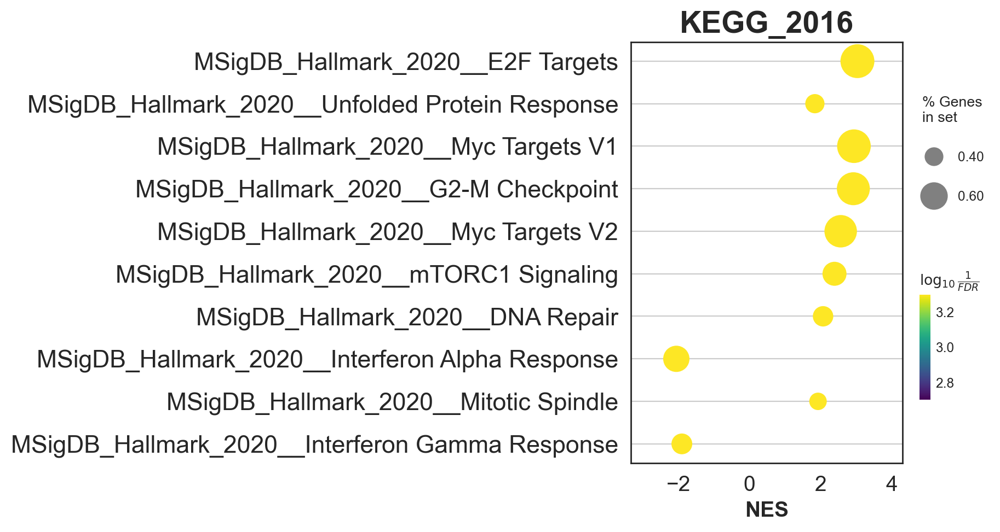

In [122]:
# to save your figure, make sure that ``ofname`` is not None
ax = gspy.dotplot(pre_res.res2d,
             column="FDR q-val",
             title='KEGG_2016',
             cmap=plt.cm.viridis,
             size=6, # adjust dot size
             figsize=(4,5), cutoff=0.25, show_ring=False)

#### Network Visualization

In [124]:
# return two dataframe
nodes, edges = enrichment_map(pre_res.res2d)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


In [125]:
import networkx as nx
# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

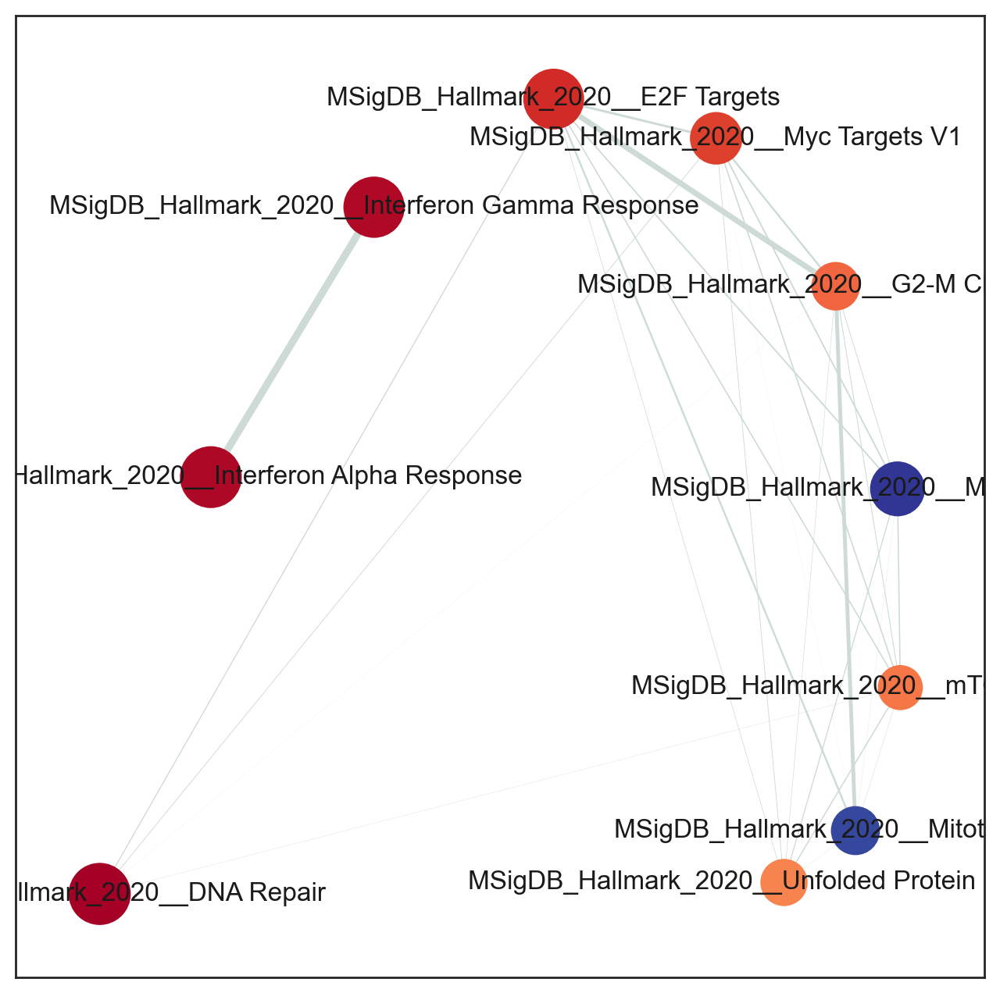

In [126]:
fig, ax = plt.subplots(figsize=(8, 8))

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu_r,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
plt.show()

### 9.1.2. Leading edge genes

In [134]:
i=0
genes = pre_res.res2d.Lead_genes[i].split(";")
genes[:10]

['TFRC',
 'TRA2B',
 'MCM5',
 'RPA1',
 'PHF5A',
 'MCM2',
 'CSE1L',
 'NCAPD2',
 'GINS3',
 'RANBP1']

#### Expression heatmap of frequent leading-edge genes

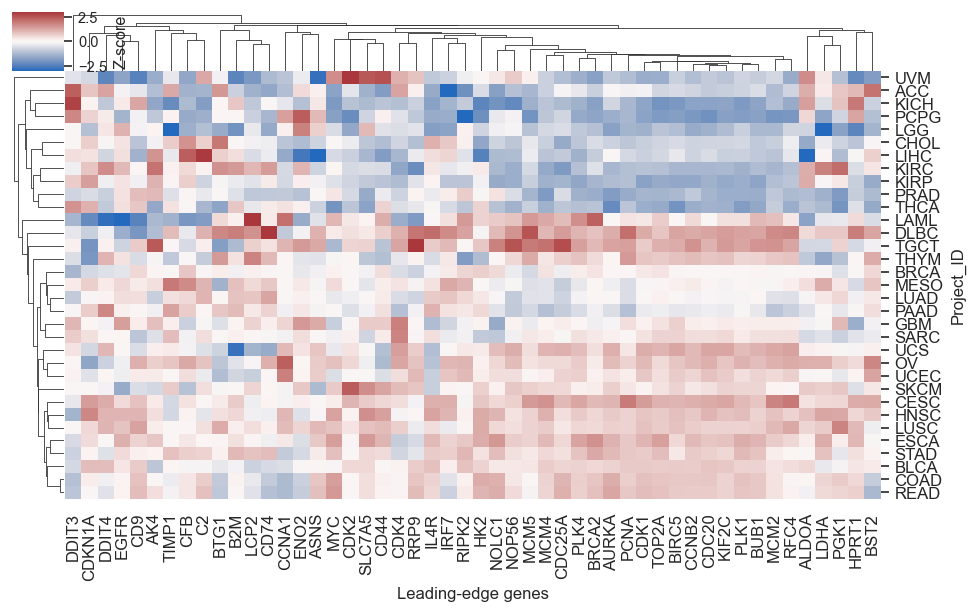

In [144]:
df_expr, g = bk.pl.gsea_leading_edge_heatmap(
    adata,
    pre_res,
    term_idx=slice(0, 30),
    use="group_mean",
    groupby="Project_ID",
    min_gene_freq=3,
    max_genes=50,
    show_labels=True,
    gene_label_fontsize=10.0,
    label_fontsize=10.0,
    title=None,
    show_title=False,
    figsize=(8,6),
    save=DESKTOP + "leading_edge_expr_heatmap.png",
)

#### Jaccard similarity between pathways

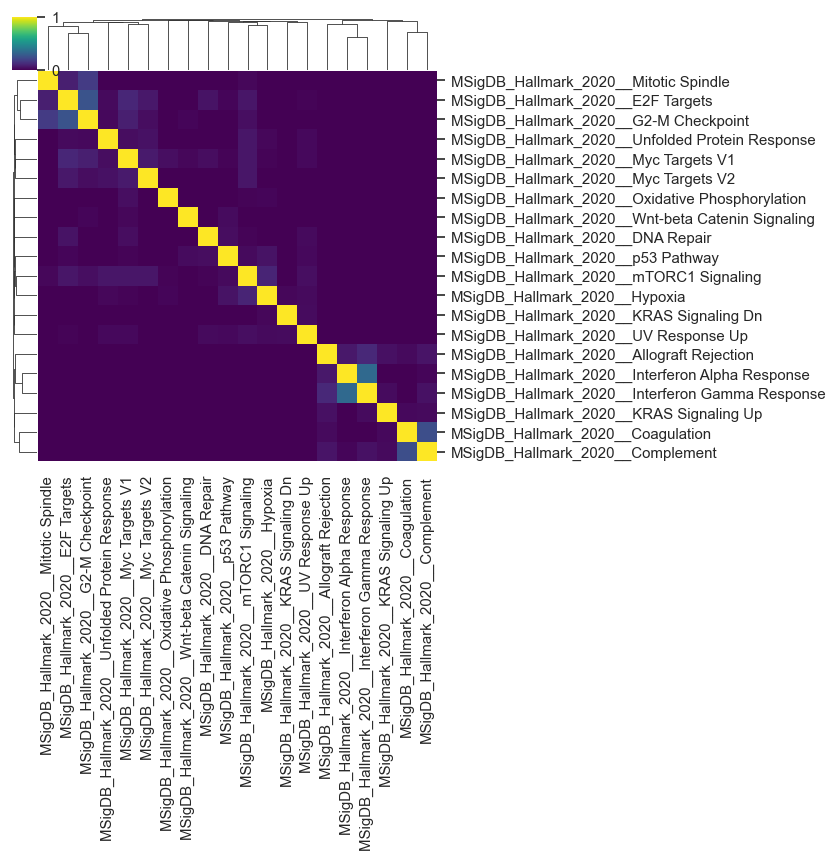

In [157]:
dfJ, g = bk.pl.leading_edge_jaccard_heatmap(
    pre_res,
    term_idx=slice(0, 20),
    min_shared_genes=2,
    row_cluster=True,
    col_cluster=True,
    show_title=False,
    #ymin=0.3,
    figsize=(7,5.5),
    save=DESKTOP + "leading_edge_jaccard.png",
)

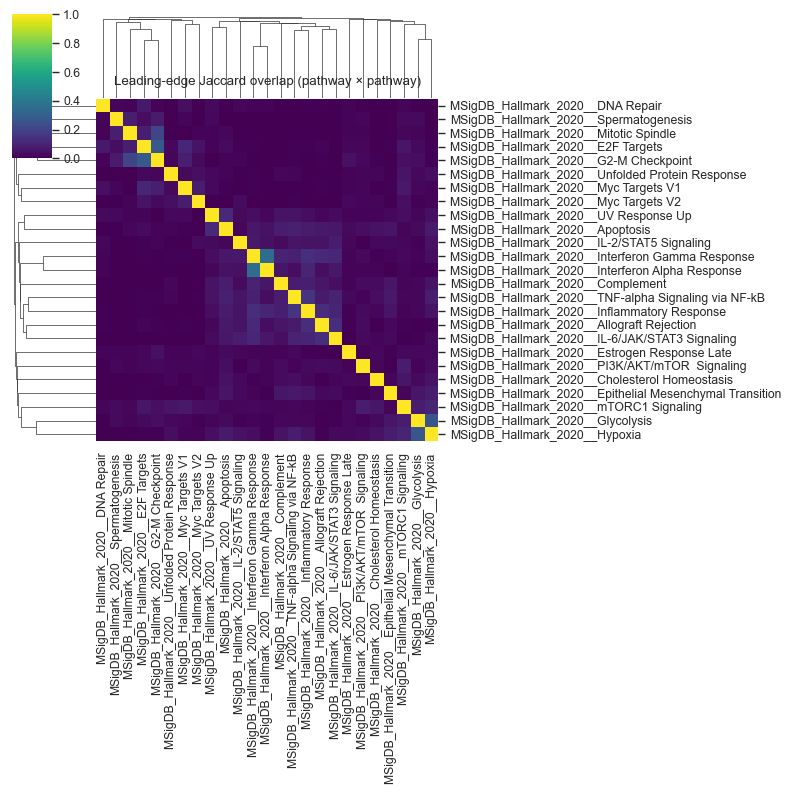

In [35]:
dfJ, gJ = leading_edge_jaccard_heatmap(
    pre_res, 
    term_idx=slice(0, 25),          # use only significant pathways (or top N by NES/FDR)
    cluster=True,
    figsize=(8,8))
plt.savefig("figs/gsea/leading_edge_jaccard.png", dpi=300, bbox_inches="tight")

#### Overlap matrix (pathways × genes) with gene names rotated 90°

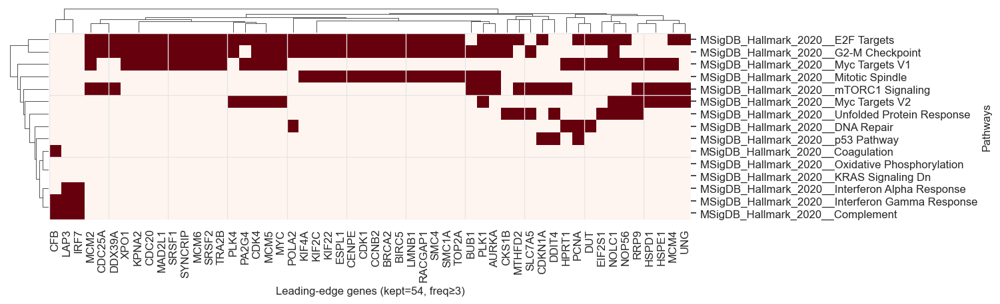

In [175]:
df_le, g = bk.pl.leading_edge_overlap_matrix(
    pre_res,
    term_idx=slice(0, 15),
    min_gene_freq=3,
    row_cluster=True,
    col_cluster=True,
    show_gene_labels=True,
    gene_label_fontsize=10,
    label_fontsize=10,
    show_title=False,
    cmap="Reds",
    figsize=(12,4),
    save=DESKTOP + "leading_edge_overlap.png",
)
# plt.savefig("figs/gsea/leading_edge_overlap.png", dpi=300, bbox_inches="tight")

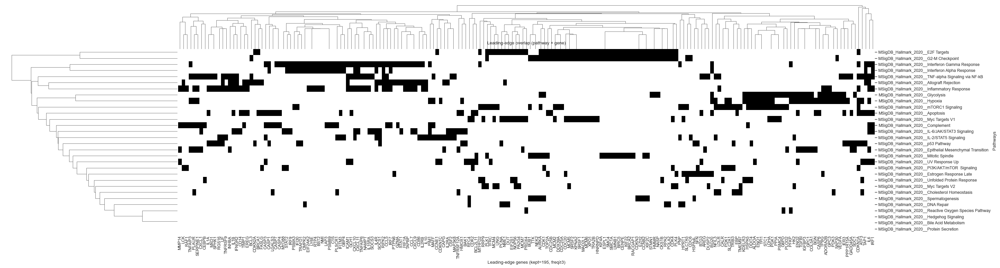

In [40]:
df_le, g = leading_edge_overlap_matrix(
    pre_res,
    term_idx=slice(0, 30),
    min_gene_freq=3,        # show only genes shared by >=3 pathways
    show_gene_labels=True,  # turn on if matrix is small
    figsize=(30,8)
)


## 10.2. Gene sets and enrichr

Enrichr libraries for selected UP- or DOWN-regulated genes (genelists)

In [176]:
res.head(3)

,gene,log2FC,t,pval,qval,mean_group,mean_ref
14572,KRT5,9.191601,47.521890,9.800940e-263,5.155588e-258,15.743748,6.552147
33474,DSG3,9.411068,48.064286,1.036572e-251,2.726340e-247,11.688935,2.277868
48261,DSC3,7.460600,44.709548,1.774872e-245,3.112120e-241,12.023859,4.563259


In [177]:
# subset up or down regulated genes
degs_sig = res[res.qval < 0.05]
degs_up = degs_sig[degs_sig.log2FC > 1]
degs_dw = degs_sig[degs_sig.log2FC < -1]
print(degs_up.shape, "UP")
print(degs_dw.shape, "DOWN")

(1943, 7) UP
(1576, 7) DOWN


In [178]:
# Over-representation analysis (Enrichr API)
enr_up = gspy.enrichr(degs_up.gene,                                # Genelist
                    gene_sets='GO_Biological_Process_2021',         # Geneset
                    outdir=None)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


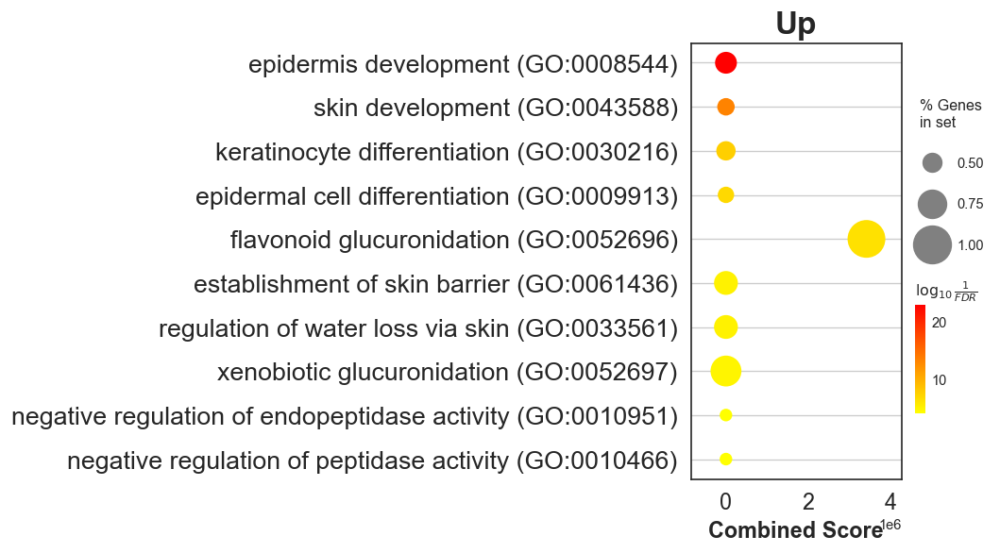

In [202]:
# dotplot
#UP
gspy.dotplot(enr_up.res2d, figsize=(3,5), title="Up", cmap = plt.cm.autumn_r)
plt.show()

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


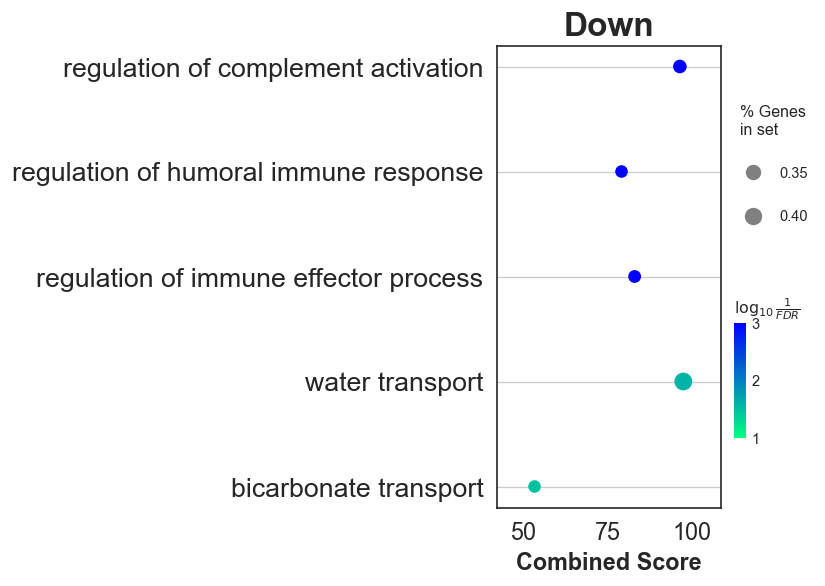

In [180]:
# DOWN
enr_dw = gspy.enrichr(degs_dw.gene,
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)

enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
gspy.dotplot(enr_dw.res2d,
           figsize=(3,5),
           title="Down",
           cmap = plt.cm.winter_r,
           size=5)
plt.show()

In [37]:
# concat results
enr_up.res2d['UP_DW'] = "UP"
enr_dw.res2d['UP_DW'] = "DOWN"
enr_res = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])
enr_res

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes,UP_DW
0,GO_Biological_Process_2021,microtubule cytoskeleton organization involved...,34/128,1.549010e-33,1.922321e-30,0,0,27.715426,2093.836437,ERCC6L;BUB1B;CDCA8;TTK;WDR62;KIF11;CENPA;SKA1;...,UP
1,GO_Biological_Process_2021,mitotic spindle organization (GO:0007052),35/157,1.342762e-31,8.331839e-29,0,0,22.037287,1566.529566,ERCC6L;BUB1B;CDCA8;TTK;WDR62;KIF11;CENPA;SKA1;...,UP
2,GO_Biological_Process_2021,mitotic sister chromatid segregation (GO:0000070),23/102,3.187767e-21,1.318673e-18,0,0,21.405822,1010.247041,SPAG5;CDCA5;PLK1;KIF14;CDCA8;NCAPG;KIF23;NCAPH...,UP
3,GO_Biological_Process_2021,DNA replication (GO:0006260),19/108,1.335048e-15,4.141987e-13,0,0,15.456652,529.387393,PIF1;FEN1;RMI2;RFC4;DONSON;CDC7;MCM10;CDC6;TIC...,UP
4,GO_Biological_Process_2021,sister chromatid segregation (GO:0000819),12/34,2.838688e-14,7.045623e-12,0,0,38.629169,1204.953867,TOP2A;KIF18A;KIF18B;SPAG5;ESPL1;KIFC1;PLK1;CEN...,UP
0,GO_Biological_Process_2021,nervous system development,18/447,2.081899e-07,2.569064e-04,0,0,4.841409,74.484175,GPM6A;TENM1;RBFOX1;CHRM1;ZBTB16;GFRA1;PCDHA11;...,DOWN
1,GO_Biological_Process_2021,central nervous system neuron differentiation,5/34,1.473603e-05,6.449331e-03,0,0,18.846447,209.670770,NTRK2;NPY;KNDC1;MAPT;CBLN1,DOWN
2,GO_Biological_Process_2021,membrane depolarization during cardiac muscle ...,4/17,1.567909e-05,6.449331e-03,0,0,33.475909,370.350098,ATP1A2;CACNA1D;SCN3B;SCN2B,DOWN
3,GO_Biological_Process_2021,chemical synaptic transmission,12/306,3.092587e-05,9.540631e-03,0,0,4.578935,47.547283,GABRB3;RIC3;GRIN2A;PTPRN2;CHRM1;GRID1;NPY;GRIK...,DOWN
4,GO_Biological_Process_2021,cell differentiation involved in metanephros d...,3/10,9.051690e-05,1.422930e-02,0,0,46.386417,431.856332,SALL1;PAX2;POU3F3,DOWN


In [38]:
from gseapy.scipalette import SciPalette
sci = SciPalette()
NbDr = sci.create_colormap()
# NbDr

In [201]:
# display multi-datasets
ax = gspy.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["DOWN", "UP"],
                title="GO_BP",
                cmap = NbDr,   # NbDr.reversed()
                size=3,
                show_ring=True)
ax.set_xlabel("")
plt.show()

NameError: name 'enr_res' is not defined

In [200]:
ax = gspy.barplot(enr_res, figsize=(3,5),
                group ='UP_DW',
                title ="GO_BP",
                color = ['b','r'])

NameError: name 'enr_res' is not defined

see available libraries: https://maayanlab.cloud/Enrichr/#libraries
- TRANSFAC_and_JASPAR_PWMs
- TRRUST_Transcription_Factors_2019
- ENCODE_and_ChEA_Consensus_TFs_from_ChIP-X

In [195]:
genes_up_list = degs_up["gene"].tolist()
print(len(genes_up_list))

1943


In [196]:
print(len(genes_up_list[:50]))

50


In [214]:
enr_tf = gspy.enrichr(gene_list=genes_up_list[:50],
                 gene_sets=['TRRUST_Transcription_Factors_2019'],
                 cutoff=0.1,
                 organism='Human',
                 outdir=DESKTOP,
                     )

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


In [203]:
enr_tf

## 10.3. Series of parallel comparisons

In [215]:
dataset = adata                                    # adata, adata_lung
dataname = "TCGA"                                  # TCGA, TCGA_lung
column = "Project_ID"                                 # e,g, "Project_ID", "RB1_mut"

In [216]:
GENESETS = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/Public_Data/Signatures & GeneSets/GSEA_genesets/2024/"

In [217]:
adata.obs.Project_ID.unique()

['LGG', 'LIHC', 'CESC', 'LUAD', 'COAD', ..., 'KICH', 'DLBC', NaN, 'ACC', 'CHOL']
Length: 34
Categories (33, object): ['ACC', 'BLCA', 'BRCA', 'CESC', ..., 'THYM', 'UCEC', 'UCS', 'UVM']

In [218]:
# Comparison 1 ---> save to df_gsea1, pre_res1
groupA = "LUAD"                                     # e.g. "LUAD", "1.0"
groupB = "BRCA"                                     # e.g. "LUSC", "0.0"
comparison = f"{column}_{groupA}_vs_{groupB}"
print("Comparison 01...")                   
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB, method="welch_ttest", layer_expr="log1p_cpm")
res = adata.uns["de"][comparison]["results"]
df_gsea_01, pre_res_01 = bk.tl.gsea_preranked(adata, res=res, comparison=comparison, score_col="t",
    gene_sets=["hallmark"], outdir="gsea", return_pre_res=True)

# Comparison 2 ---> save to df_gsea2, , pre_res2
groupA = "LUSC"                                     # e.g. "LUAD", "1.0"
groupB = "BRCA"                                     # e.g. "LUSC", "0.0"
comparison = f"{column}_{groupA}_vs_{groupB}"
print("Comparison 02...")                     
bk.tl.de(adata, groupby=column, group=groupA, reference=groupB, method="welch_ttest", layer_expr="log1p_cpm")
res = adata.uns["de"][comparison]["results"]
df_gsea_02, pre_res_02 = bk.tl.gsea_preranked(adata, res=res, comparison=comparison, score_col="t",
    gene_sets=["hallmark"], outdir="gsea", return_pre_res=True)

print("Merging data from all comparisons...")
# later: concatenate across comparisons
all_gsea = pd.concat([df_gsea_01, df_gsea_02])
all_gsea.head(3)

INFO: DE (welch_ttest) on layer='log1p_cpm'


Comparison 01...


INFO: Stored DE results (welch_ttest) in adata.uns['de']['Project_ID_LUAD_vs_BRCA'].
INFO: Running GSEApy prerank: comparison=Project_ID_LUAD_vs_BRCA n_genes=52328 outdir=gsea/Project_ID_LUAD_vs_BRCA
2026-01-25 14:19:40,600 [WARNING] Duplicated values found in preranked stats: 0.81% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
INFO: DE (welch_ttest) on layer='log1p_cpm'


Comparison 02...


INFO: Stored DE results (welch_ttest) in adata.uns['de']['Project_ID_LUSC_vs_BRCA'].
INFO: Running GSEApy prerank: comparison=Project_ID_LUSC_vs_BRCA n_genes=52277 outdir=gsea/Project_ID_LUSC_vs_BRCA
2026-01-25 14:19:45,423 [WARNING] Duplicated values found in preranked stats: 1.00% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


Merging data from all comparisons...


,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.55315,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...


In [219]:
all_gsea

,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.55315,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...
3,Project_ID_LUAD_vs_BRCA,3,prerank,MSigDB_Hallmark_2020__TNF-alpha Signaling via ...,0.639815,2.383453,0.0,0.0,0.0,112/198,14.73%,CXCL3;CSF2;ICAM1;CCL20;CXCL1;BMP2;CXCL2;PTGS2;...
4,Project_ID_LUAD_vs_BRCA,4,prerank,MSigDB_Hallmark_2020__IL-6/JAK/STAT3 Signaling,0.715757,2.371309,0.0,0.0,0.0,55/87,14.08%,CXCL3;CSF2;CXCL1;TNFRSF21;CD38;OSMR;IL7;SOCS1;...
...,...,...,...,...,...,...,...,...,...,...,...,...
45,Project_ID_LUSC_vs_BRCA,45,prerank,MSigDB_Hallmark_2020__Oxidative Phosphorylation,0.312852,1.154602,0.1376,0.17681,0.988,69/184,19.15%,LDHB;POR;SLC25A5;FDX1;BAX;TOMM22;POLR2F;SDHD;E...
46,Project_ID_LUSC_vs_BRCA,46,prerank,MSigDB_Hallmark_2020__Spermatogenesis,0.316611,1.122745,0.220367,0.219801,0.996,46/133,17.29%,CFTR;DCC;NOS1;POMC;GFI1;DMRT1;TLE4;PGS1;RFC4;G...
47,Project_ID_LUSC_vs_BRCA,47,prerank,MSigDB_Hallmark_2020__Androgen Response,0.327267,1.118344,0.227979,0.221384,0.997,19/96,6.20%,SGK1;NDRG1;ABCC4;SAT1;RPS6KA3;CDK6;FADS1;MERTK...
48,Project_ID_LUSC_vs_BRCA,48,prerank,MSigDB_Hallmark_2020__Pancreas Beta Cells,-0.321282,-0.994173,0.463942,0.456659,0.999,14/40,17.50%,ABCC8;DCX;SCGN;SPCS1;SRP9;SYT13;PAK3;SRP14;G6P...


In [220]:
savename = dataname + "_" + column + "_comparisons.tsv"
all_gsea.to_csv(DESKTOP + "gsea_" + savename, sep="\t")

## 10.4. Pathway bubble plot

In [5]:
# use all_gsea above 
#df_gsea = all_gsea.copy()
#or load a previously saved file
GSEA = "/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/figs/gsea/"
df_gsea = pd.read_csv(GSEA + "all_gsea_TCGA_Project_ID.tsv", sep="\t")
df_gsea.head(3)

,Unnamed: 0,comparison,term,Name,Term,ES,NES,NOM p-val,FDR q-val,FWER p-val,Tag %,Gene %,Lead_genes
0,0,Project_ID_LUAD_vs_BRCA,0,prerank,MSigDB_Hallmark_2020__Allograft Rejection,0.698233,2.557171,0.0,0.0,0.0,128/195,15.10%,LYN;ICAM1;CCL13;CTSS;ACHE;IL7;C2;SOCS1;IFNAR2;...
1,1,Project_ID_LUAD_vs_BRCA,1,prerank,MSigDB_Hallmark_2020__Inflammatory Response,0.697485,2.553150,0.0,0.0,0.0,121/199,14.28%,ROS1;FZD5;ICAM4;LYN;ICAM1;CCL20;SLC4A4;LAMP3;C...
2,2,Project_ID_LUAD_vs_BRCA,2,prerank,MSigDB_Hallmark_2020__Interferon Gamma Response,0.658335,2.445876,0.0,0.0,0.0,98/198,12.50%,UPP1;ICAM1;METTL7B;PTGS2;ST3GAL5;BANK1;CASP4;P...


In [221]:
# define pathways to represent
pathways = {
    "Immune": [
        "MSigDB_Hallmark_2020__IL-6/JAK/STAT3 Signaling",
        "MSigDB_Hallmark_2020__Interferon Alpha Response",
        "MSigDB_Hallmark_2020__Inflammatory Response",
        "MSigDB_Hallmark_2020__Interferon Gamma Response",
        "MSigDB_Hallmark_2020__Allograft Rejection",
    ],
    "Metabolism": [
        "MSigDB_Hallmark_2020__Oxidative Phosphorylation",
        "MSigDB_Hallmark_2020__Estrogen Response Early",
        "MSigDB_Hallmark_2020__Pancreas Beta Cells",
    ],
    "Cell Cycle": [
        "MSigDB_Hallmark_2020__G2-M Checkpoint",
        "MSigDB_Hallmark_2020__E2F Targets",
        "MSigDB_Hallmark_2020__Myc Targets V1",
        "MSigDB_Hallmark_2020__Myc Targets V2",
    ]
}

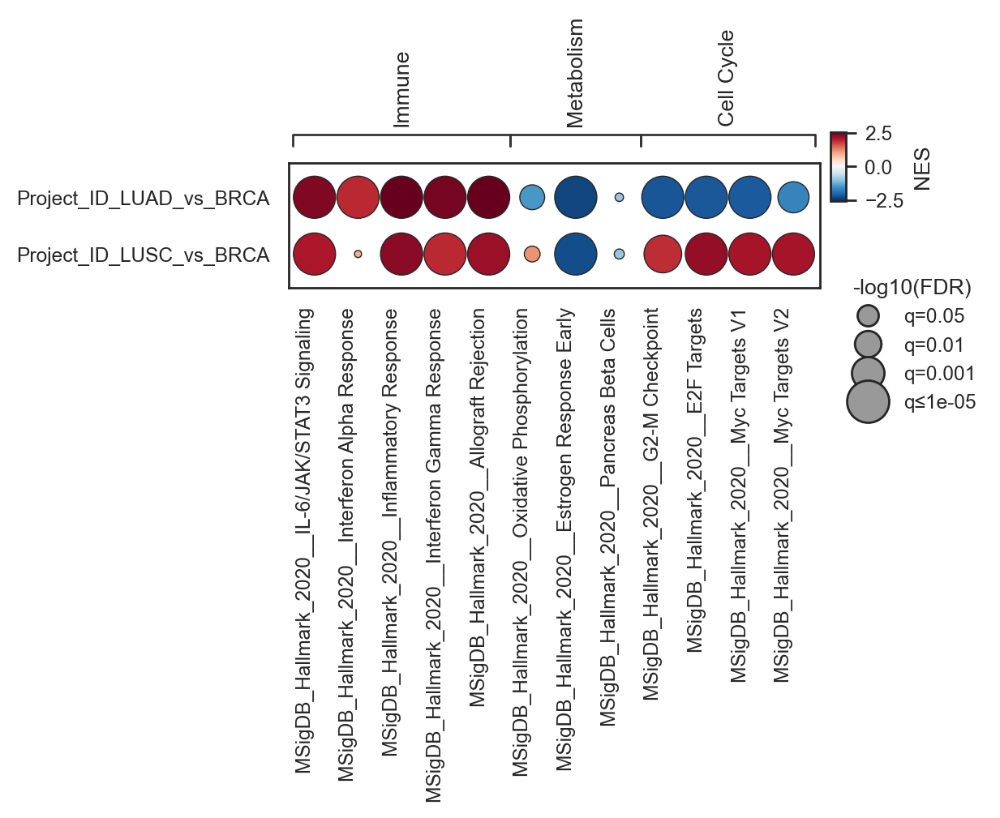

(<Figure size 1000x200 with 2 Axes>, <Axes: >)

In [222]:
bk.pl.gsea_bubbleplot(
    all_gsea,   
    pathways=pathways,
    fdr_floor=1e-5,             # <- YOU choose the floor
    size_clip_quantile=0.98,    # <- cap extremes so others don’t shrink
    dot_linewidth=0.5,
    row_height=0.1,          # tighter
    col_width=0.1,            # wider columns
    figsize=(5,1),
)

## 10.5. Genesets, GO and GSEA Utilities

### Rerun GSEApy from previously saved rnk file   
(res not needed) only for plotting later:

In [ ]:
rnk_path = "figs/gsea/RB1_mut_1.0_vs_0.0/RB1_mut_1.0_vs_0.0.rnk.tsv"
pre_res = gseapy.prerank(rnk=rnk_path, gene_sets="MSigDB_Hallmark_2020", outdir=None)

### Original genesets from GSEA - MSigDB

In [9]:
msig = Msigdb()
msig.list_category(dbver="2025.1.Hs") 

['c1.all',
 'c2.all',
 'c2.cgp',
 'c2.cp.biocarta',
 'c2.cp.kegg_legacy',
 'c2.cp.kegg_medicus',
 'c2.cp.pid',
 'c2.cp.reactome',
 'c2.cp',
 'c2.cp.wikipathways',
 'c3.all',
 'c3.mir.mir_legacy',
 'c3.mir.mirdb',
 'c3.mir',
 'c3.tft.gtrd',
 'c3.tft.tft_legacy',
 'c3.tft',
 'c4.3ca',
 'c4.all',
 'c4.cgn',
 'c4.cm',
 'c5.all',
 'c5.go.bp',
 'c5.go.cc',
 'c5.go.mf',
 'c5.go',
 'c5.hpo',
 'c6.all',
 'c7.all',
 'c7.immunesigdb',
 'c7.vax',
 'c8.all',
 'h.all',
 'msigdb']

In [ ]:
h_all = msig.get_gmt(category='h.all', dbver="2025.1.Hs")    # HALLMARKS
h_c2_all = msig.get_gmt(category='2.cp.reactome', dbver="2025.1.Hs")

In [ ]:
print(h_all['HALLMARK_WNT_BETA_CATENIN_SIGNALING'])

### Enrichr datasets

The authoritative list is the Enrichr dataset Statistics endpoint. To discover exact names installed in your environment:

In [7]:
bk.tl.list_enrichr_libraries()[:50]

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CM4AI_U2OS_Protein_Localization_Assemblies',
 'COMPARTMENTS_Curated_2025',
 'COMPARTMENTS_Experimental_2025',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'ClinVar_2025',
 'DGIdb_Drug_Targets_2024',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMa

# 11. Metaprograms and Tumor Heterogeneity
<a id="mp"></a>

## 11.1. Calculate and integrate metaprogram scores

Load the published MPs (no refitting):
- Gavish et al. *Nature* volume 618, pages598–606 (2023): https://www.nature.com/articles/s41586-023-06130-4
- NP gene tables in: https://www.weizmann.ac.il/sites/3CA/search-genes  

In [10]:
mp_dict = bk.tl.read_metaprograms_xlsx(
    "../data/mp/meta_programs_2025-01-29.xlsx",
    sheet_name="Malignant",
    min_genes=10
)
len(mp_dict), list(mp_dict)[:5]

(67,
 ['MP1 Cell Cycle - G2/M',
  'MP2 Cell Cycle - G1/S',
  'MP3 Cell Cylce HMG-rich',
  'MP4 Chromatin',
  'MP5 Cell cycle single-nucleus'])

Score MPs per sample (bulk)

In [11]:
df_mp_scores, df_mp_info = bk.tl.score_metaprograms(
    adata,
    mp_dict,
    layer="log1p_cpm",
    zscore_genes=True,
    min_genes_found=8,
    prefix="MP_",
    obsm_key="X_mp",
    add_obs=True,
)
df_mp_info.head(10)

,mp,n_genes_listed,n_genes_found,genes_found,kept,reason
0,MP1 Cell Cycle - G2/M,50,50,"[HMGB2, UBE2C, NUSAP1, PTTG1, CKS2, KPNA2, SMC...",True,
1,MP2 Cell Cycle - G1/S,50,50,"[PCNA, FEN1, MCM3, TYMS, GMNN, TK1, RRM1, RFC4...",True,
2,MP3 Cell Cylce HMG-rich,50,50,"[STMN1, TUBA1B, H2AFZ, RANBP1, NME1, RAN, PTTG...",True,
3,MP6 Stress 1,50,50,"[EGR1, FOS, JUN, IER2, DUSP1, FOSB, ATF3, PPP1...",True,
4,MP10 Proteasomal degradation,50,50,"[CCT5, CCT7, CCT8, MDH1, PRMT1, PSMC4, SSB, PS...",True,
5,MP12 Protein maturation,50,50,"[HSPA5, LGALS3BP, PDIA3, GRN, PDIA6, TMEM59, A...",True,
6,MP15 EMT-I,50,50,"[COL1A2, SPARC, COL1A1, FN1, COL3A1, COL6A2, I...",True,
7,MP16 EMT-II,50,50,"[LAMC2, LAMB3, KRT17, LAMA3, LGALS1, MT2A, PME...",True,
8,MP17 EMT-III,50,50,"[S100A6, ANXA2, LGALS1, S100A10, ANXA1, EMP3, ...",True,
9,MP22 Interferon/MHC-II (I),50,50,"[CD74, ISG15, HLA-DRB1, HLA-DRA, STAT1, IFI6, ...",True,


In [12]:
adata.obs.head(3)

,Patient_ID,Project_ID,gender,race,ajcc_pathologic_tumor_stage,clinical_stage,histological_type,histological_grade,initial_pathologic_dx_year,menopause_status,...,MP_MP58_Metal_response,MP_MP59_PDAC_related_1,MP_MP60_PDAC_related_2,MP_MP61_PDAC_related_3,MP_MP62_PDAC_related_4,MP_MP63_PDAC_related_5,MP_MP64_Adherens,MP_MP65_Cholesterol_Homeostasis,MP_MP66_Unassigned_1,MP_MP67_Unassigned_2
Sample_ID,,,,,,,,,,,,,,,,,,,,,
TCGA-S9-A7J2-01,TCGA-S9-A7J2,LGG,MALE,WHITE,NaN,NaN,Oligodendroglioma,G3,2013.0,NaN,...,-0.467893,-1.212706,-0.665682,-0.505248,-0.580963,-0.386989,-0.376297,0.075637,-0.135036,0.337450
TCGA-G3-A3CH-11,TCGA-G3-A3CH,LIHC,MALE,ASIAN,Stage IIIA,NaN,Hepatocellular Carcinoma,G2,2010.0,NaN,...,-0.150010,-0.171668,-0.462129,0.373682,-0.114546,-0.640391,-0.802499,0.414227,-0.338817,-0.516038
TCGA-EK-A2RE-01,TCGA-EK-A2RE,CESC,FEMALE,WHITE,NaN,Stage IIA,Cervical Squamous Cell Carcinoma,G2,2010.0,Pre (<6 months since LMP AND no prior bilatera...,...,0.131827,0.515806,0.583037,-0.447925,-0.729030,0.193594,0.968015,0.494608,-0.336855,-0.264538


QC / sanity checks

- check how many genes found per MP
- check score distributions
- check correlation among MPs (some will correlate strongly)

In [13]:
# genes found distribution
df_mp_info[df_mp_info["kept"]][["mp","n_genes_found"]].describe()

,n_genes_found
count,67.000000
mean,48.776119
std,1.422981
min,43.000000
25%,48.000000
50%,49.000000
75%,50.000000
max,50.000000


In [14]:
# MP score correlation
mp_corr = df_mp_scores.corr()
mp_corr.head(3)

,MP1 Cell Cycle - G2/M,MP2 Cell Cycle - G1/S,MP3 Cell Cylce HMG-rich,MP4 Chromatin,MP5 Cell cycle single-nucleus,MP6 Stress 1,MP7 Hypoxia,MP8 Stress (in vitro),MP9 Stress 2,MP10 Proteasomal degradation,...,MP58 Metal-response,MP59 PDAC-related 1,MP60 PDAC-related 2,MP61 PDAC-related 3,MP62 PDAC-related 4,MP63 PDAC-related 5,MP64 Adherens,MP65 Cholesterol Homeostasis,MP66 Unassigned 1,MP67 Unassigned 2
MP1 Cell Cycle - G2/M,1.000000,0.963519,0.788681,0.142573,0.910663,-0.036102,0.091020,0.283736,0.504685,0.586114,...,-0.119713,0.233277,0.139070,0.035847,-0.068644,0.195026,0.273557,0.292962,-0.016872,-0.032426
MP2 Cell Cycle - G1/S,0.963519,1.000000,0.787357,0.165466,0.928671,-0.062871,0.050651,0.271971,0.474063,0.574377,...,-0.165347,0.175966,0.082685,-0.017815,-0.121357,0.159132,0.257276,0.254432,-0.017673,0.012287
MP3 Cell Cylce HMG-rich,0.788681,0.787357,1.000000,-0.237498,0.597231,-0.048011,0.094787,0.459926,0.518897,0.876565,...,-0.004582,0.166834,0.026054,-0.008847,-0.128772,0.001081,0.028813,0.297179,-0.269764,0.074389


Heterogeneity per tumor group + downstream association

In [15]:
df_het = bk.tl.metaprogram_heterogeneity(
    adata,
    groupby="Project_ID",
    stat="sd",
)

In [16]:
df_het.head(3)

,group,mp,mean,heterogeneity_sd,n
0,ACC,MP1,-0.261250,0.698953,77
1,ACC,MP2,-0.350239,0.667997,77
2,ACC,MP3,-0.000855,0.429767,77


In [17]:
# Example: for each project, overall MP heterogeneity summary
df_project_summary = (
    df_het.groupby("group")["heterogeneity_sd"]
    .agg(["mean","median","max"])
    .reset_index()
)
df_project_summary.head()

,group,mean,median,max
0,ACC,0.308101,0.285822,0.698953
1,BLCA,0.371148,0.353514,0.808845
2,BRCA,0.324083,0.285832,0.669480
3,CESC,0.335568,0.313953,0.692099
4,CHOL,0.356370,0.320541,1.036171


Then you can correlate:  
- MP scores (sample-level) with therapy response / NR@6m
- MP heterogeneity (group-level) with prognosis metrics or resistance rates

Plots

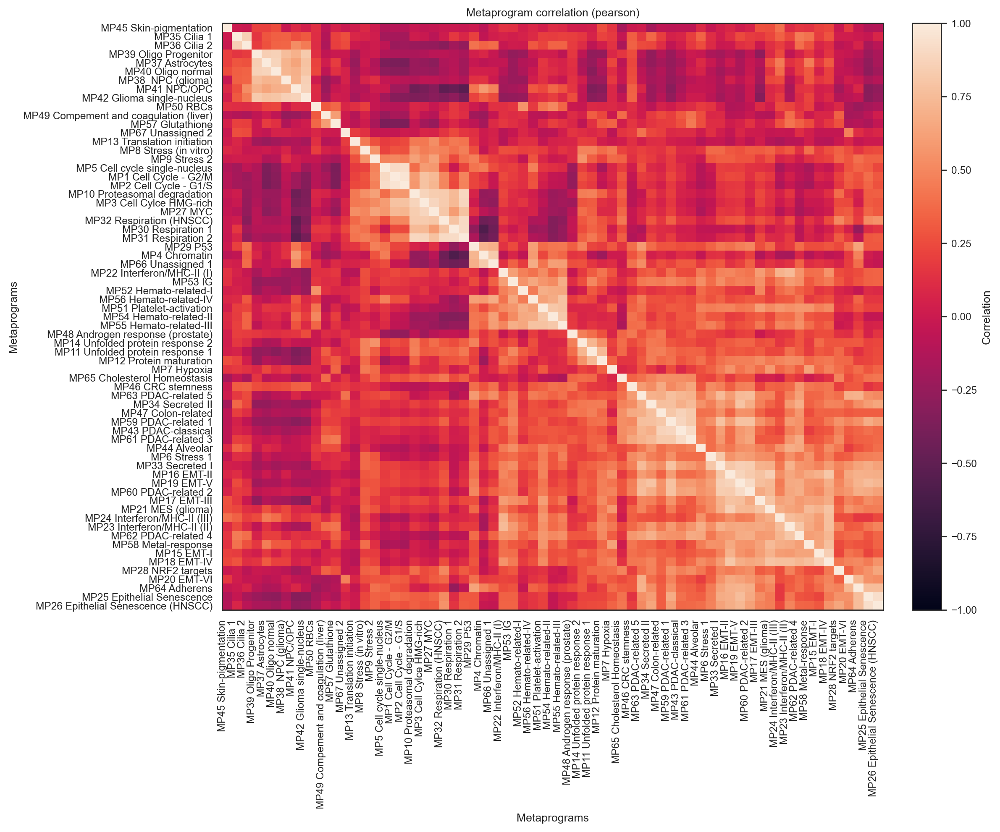

In [24]:
# 1) after you ran bk.tl.score_metaprograms(...) storing adata.obsm["X_mp"]
df_corr = bk.pl.metaprogram_corr(
    adata,
    obsm_key="X_mp",
    method="pearson",
    cluster=True,
    figsize=(12, 10),
)

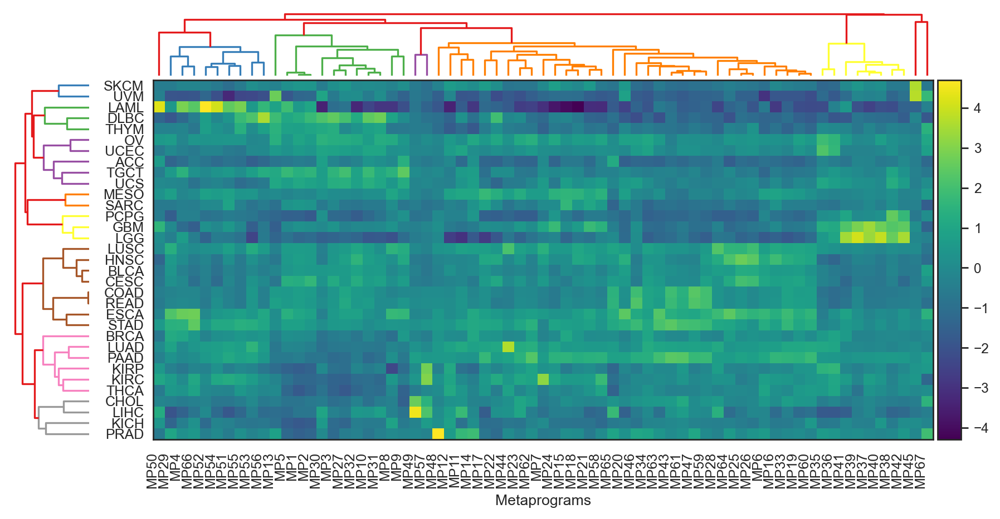

In [18]:
# 2) heatmap aggregated by tumor type
df_heat, df_group = bk.pl.metaprogram_heatmap(
    adata,
    obsm_key="X_mp",
    groupby="Project_ID",
    agg="mean",
    scale="zscore_cols",
    order_mps="cluster",
    order_groups="cluster",              # # "size", "alpha", None, "cluster"
    row_dendrogram=True,
    col_dendrogram=True,
    dendrogram_ratio=(0.1, 0.05),   # (row_dendro_width, col_dendro_height) in figure fraction-ish
    row_dendro_width=0.1,
    col_dendro_height=0.18,
    dendro_gap=0.07,
    ytick_pad=1,
    rotate_xticks=90,
    figsize=(11, 5),
)

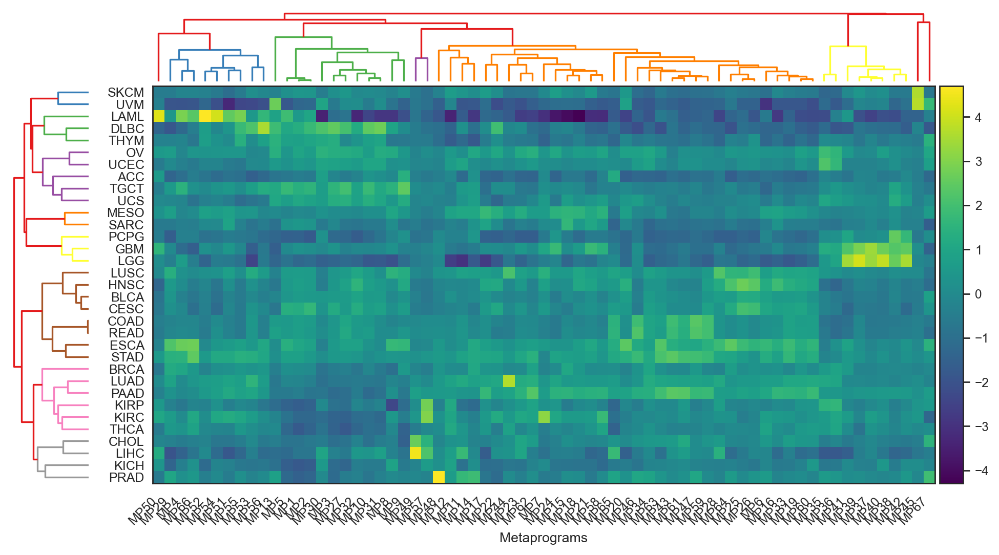

In [19]:
df_heat, df_group = bk.pl.metaprogram_heatmap(
    adata,
    groupby="Project_ID",
    order_groups="cluster",
    order_mps="cluster",
    row_dendrogram=True,
    col_dendrogram=True,
    dendrogram_ratio=(0.1, 0.05),   # (row_dendro_width, col_dendro_height) in figure fraction-ish
    row_dendro_width=0.1,
    col_dendro_height=0.18,
    dendro_gap=0.07,
    ytick_pad=1,
)

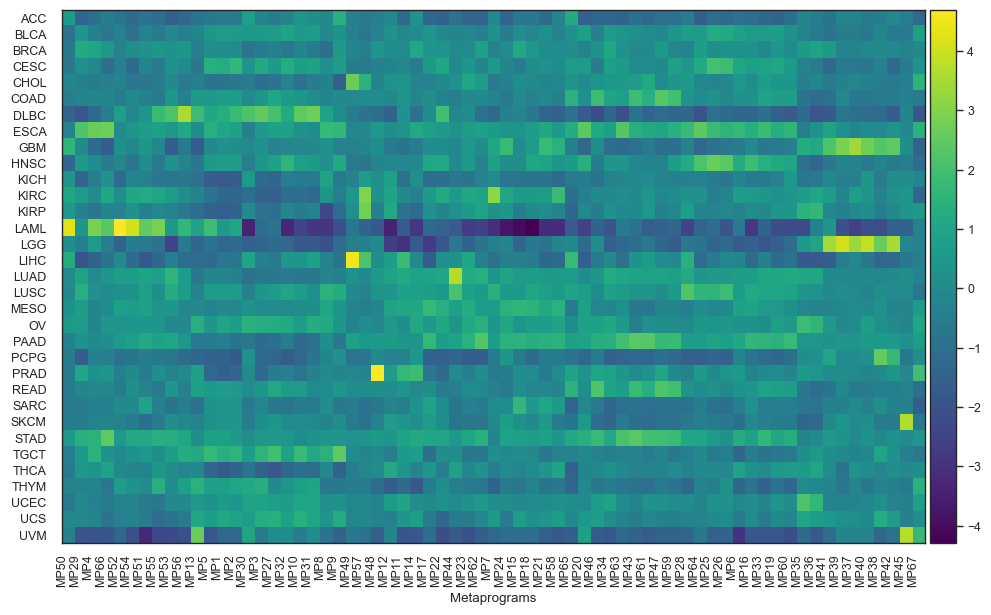

In [22]:
df_heat, df_group = bk.pl.metaprogram_heatmap(
    adata,
    groupby="Project_ID",
    order_groups="alpha",       #"cluster"
    order_mps="cluster",
    row_dendrogram=False,
    col_dendrogram=False,
    rotate_xticks=90,
    figsize=(12, 7),
)

## 11.2. Functional tumor heterogeneity and dispersion in metaprograms

In [26]:
# 1) compute per-sample metaprogram heterogeneity + dispersion
bk.tl.metaprogram_sample_metrics(
    adata,
    groupby="Project_ID",
    out_prefix="mp",
    heterogeneity="entropy",
    dispersion="mad",
    zscore_within_group=True,
)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


In [27]:
# 2) compute per-group metaprogram dispersion table
bk.tl.metaprogram_dispersion_by_group(adata, groupby="Project_ID", method="mad")

,group,metaprogram,dispersion,n
0,ACC,MP1,0.520609,77
1,ACC,MP2,0.444303,77
2,ACC,MP3,0.283294,77
3,ACC,MP4,0.227157,77
4,ACC,MP5,0.398499,77
...,...,...,...,...
2206,UVM,MP63,0.085296,79
2207,UVM,MP64,0.109303,79
2208,UVM,MP65,0.088886,79
2209,UVM,MP66,0.293019,79


In [28]:
# 3) optional: link metaprograms to NE signature score
bk.tl.metaprogram_ne_enrichment(adata, ne_signature_key="Neuroendocrine_score")

,metaprogram,rho,pval,n,qval
0,MP39,0.371733,0.000000e+00,10534,0.000000e+00
1,MP55,-0.366421,0.000000e+00,10534,0.000000e+00
2,MP66,-0.379799,0.000000e+00,10534,0.000000e+00
3,MP54,-0.304640,4.542518e-225,10534,7.608718e-224
4,MP62,-0.292750,3.240619e-207,10534,4.342430e-206
...,...,...,...,...,...
62,MP5,-0.017152,7.835204e-02,10534,8.332677e-02
63,MP8,-0.013691,1.600044e-01,10534,1.675047e-01
64,MP11,-0.013510,1.655960e-01,10534,1.706912e-01
65,MP41,0.005333,5.841821e-01,10534,5.930334e-01


In [29]:
# 4) optional: compute top-k dominance per sample
bk.tl.metaprogram_topk_contribution(adata, k=3)

,sample,rank,metaprogram,weight,score
0,TCGA-S9-A7J2-01,1,MP39,0.099434,1.801954
1,TCGA-S9-A7J2-01,2,MP42,0.083157,1.623190
2,TCGA-S9-A7J2-01,3,MP37,0.075905,1.531936
3,TCGA-G3-A3CH-11,1,MP49,0.347304,3.383460
4,TCGA-G3-A3CH-11,2,MP57,0.052549,1.495013
...,...,...,...,...,...
31597,TCGA-DD-A115-01,2,MP57,0.037155,1.129155
31598,TCGA-DD-A115-01,3,MP65,0.022571,0.630744
31599,TCGA-FV-A3I0-11,1,MP49,0.372073,3.470628
31600,TCGA-FV-A3I0-11,2,MP57,0.046873,1.398979


obsm["X_mp"] likely has no column names stored. Since you also have metaprograms as .obs columns (MP_MP1_... etc.), you can sync names

In [30]:
#mp_cols = [c for c in adata.obs.columns if c.startswith("MP_")]
#adata.uns["metaprogram_names"] = mp_cols

### Dispersion plots

#### Heatmap: metaprogram dispersion by tumor type
Identify which tumors show highest program variability; highlight NE-related or other MPs later.   

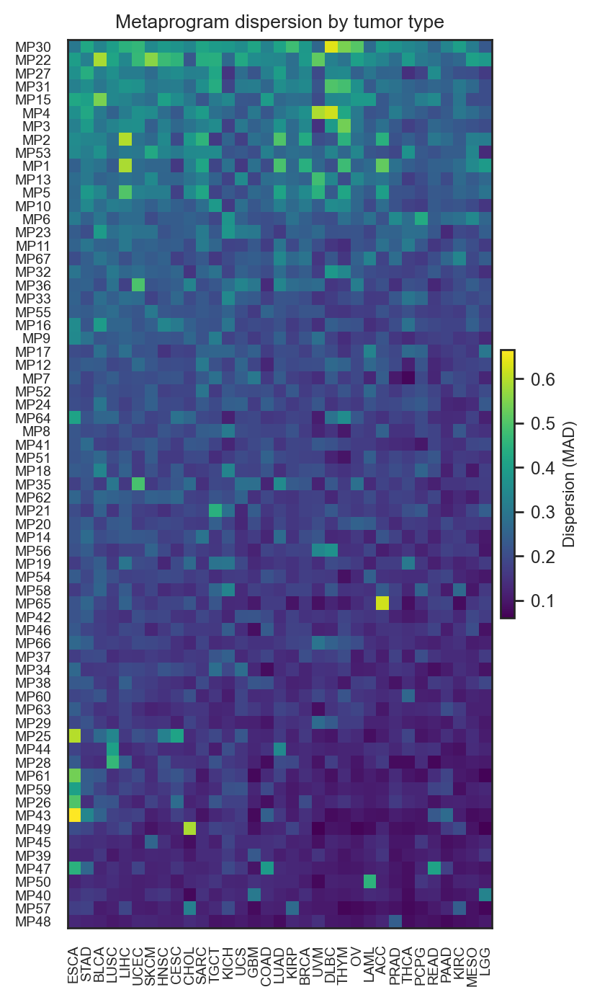

<Axes: title={'center': 'Metaprogram dispersion by tumor type'}>

In [31]:
bk.pl.metaprogram_dispersion_heatmap(adata, figsize=(4,8),
                                    save=DESKTOP + "metaprogram_dispersion.png")

#### Summary: heterogeneity + dispersion by tumor type (two boxplots)

Show cohort-level differences in “program mixture” (entropy) and dispersion.

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/dispersion.py:602: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  order = df.groupby(groupby)[dispersion_key].median().sort_values(ascending=False).index.tolist()


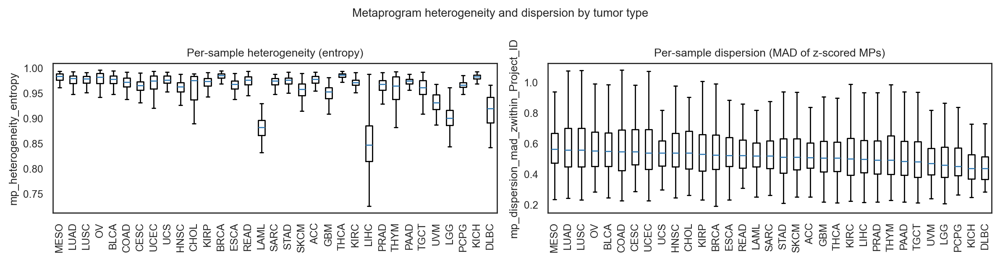

array([<Axes: title={'center': 'Per-sample heterogeneity (entropy)'}, ylabel='mp_heterogeneity_entropy'>,
       <Axes: title={'center': 'Per-sample dispersion (MAD of z-scored MPs)'}, ylabel='mp_dispersion_mad_zwithin_Project_ID'>],
      dtype=object)

In [32]:
bk.pl.metaprogram_metrics_summary(adata,
                                 save=DESKTOP + "metaprogram_metrics.png")

#### Scatter: NE score vs metaprogram heterogeneity (or dispersion)

“NE ↔ heterogeneity” centerpiece.

#### NE vs heterogeneity entropy

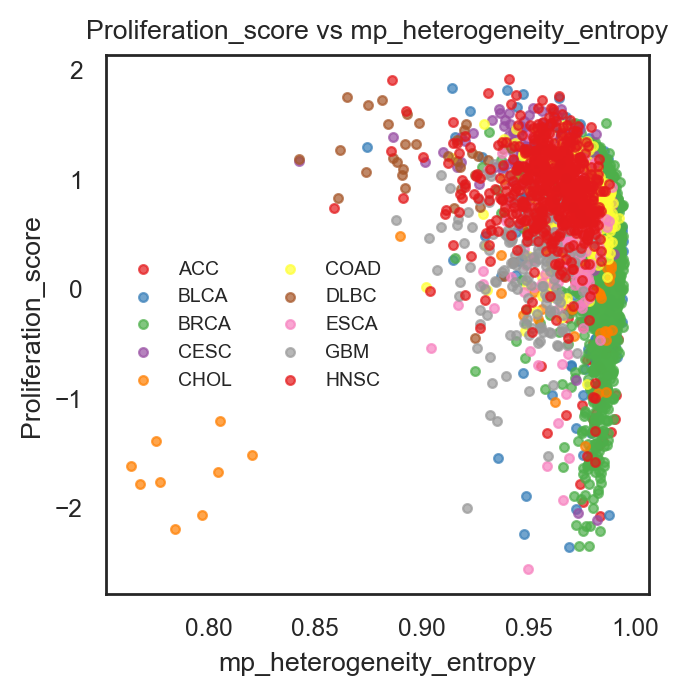

<Axes: title={'center': 'Proliferation_score vs mp_heterogeneity_entropy'}, xlabel='mp_heterogeneity_entropy', ylabel='Proliferation_score'>

In [33]:
bk.pl.metaprogram_ne_scatter(adata, ne_key="Proliferation_score", x_key="mp_heterogeneity_entropy", figsize=(3.5,3.5),
                            save= DESKTOP + "metaprogram_entropy_scatter.png")

#### NE vs dispersion

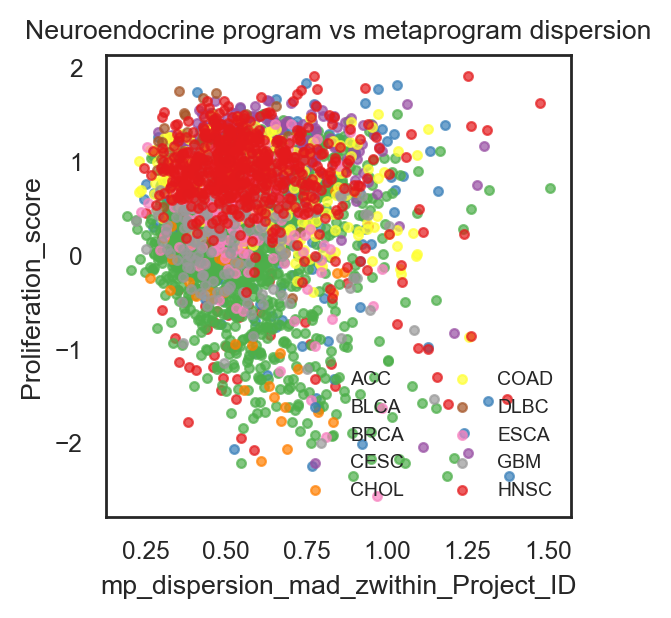

In [34]:
ax = bk.pl.metaprogram_ne_scatter(
    adata,
    ne_key="Proliferation_score",
    x_key="mp_dispersion_mad_zwithin_Project_ID",
    groupby="Project_ID",
    max_groups=10,
    title="Neuroendocrine program vs metaprogram dispersion",
    show=True,
    figsize=(3,3),
    save=DESKTOP + "Fig_NE_vs_MP_dispersion.png",
)

#### Dominance: top metaprogram weight distribution by tumor type

Show whether tumors are dominated by one MP (low heterogeneity) vs distributed (high heterogeneity).  

This uses adata.uns["mp_topk"]. It plots the distribution of the rank-1 metaprogram weight per tumor type.  

In [22]:
bk.tl.metaprogram_topk_contribution(adata)

,sample,rank,metaprogram,weight,score
0,TCGA-S9-A7J2-01,1,MP39,0.099434,1.801954
1,TCGA-S9-A7J2-01,2,MP42,0.083157,1.623190
2,TCGA-S9-A7J2-01,3,MP37,0.075905,1.531936
3,TCGA-G3-A3CH-11,1,MP49,0.347304,3.383460
4,TCGA-G3-A3CH-11,2,MP57,0.052549,1.495013
...,...,...,...,...,...
31597,TCGA-DD-A115-01,2,MP57,0.037155,1.129155
31598,TCGA-DD-A115-01,3,MP65,0.022571,0.630744
31599,TCGA-FV-A3I0-11,1,MP49,0.372073,3.470628
31600,TCGA-FV-A3I0-11,2,MP57,0.046873,1.398979


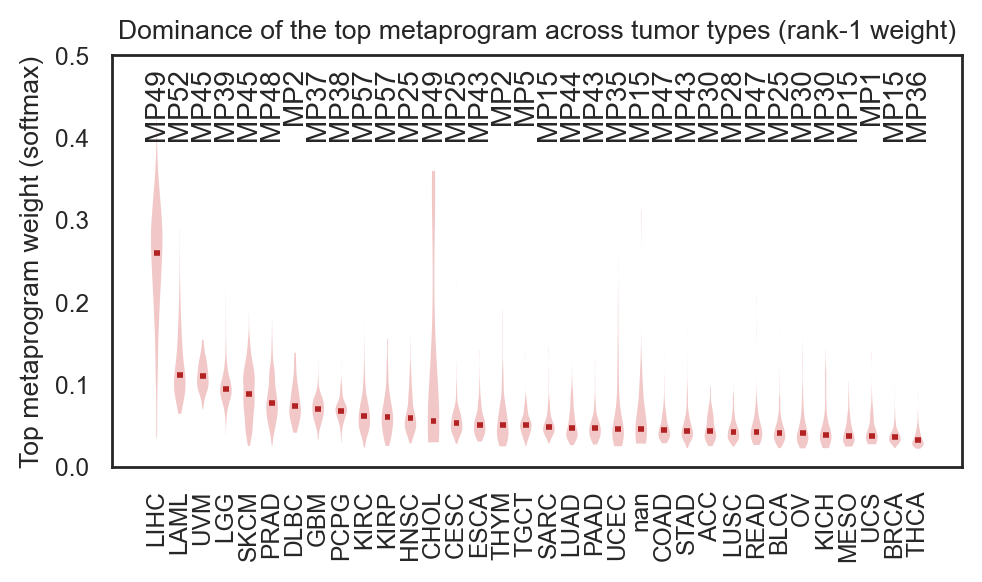

<Axes: title={'center': 'Dominance of the top metaprogram across tumor types (rank-1 weight)'}, ylabel='Top metaprogram weight (softmax)'>

In [23]:
bk.pl.metaprogram_dominance_ridgeplot_like(
    adata,
    topk_key="mp_topk",
    groupby="Project_ID",
    weight_key= "weight",
    rank=1,
    #max_groups=12,
    ylim=(0, 0.5),
    #y_text=1,                                # None
    fontsize=10,
    figsize=(5, 3),
    save=DESKTOP+"Fig_MP_rank1_dominance.png",
)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/cox.py:1903: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


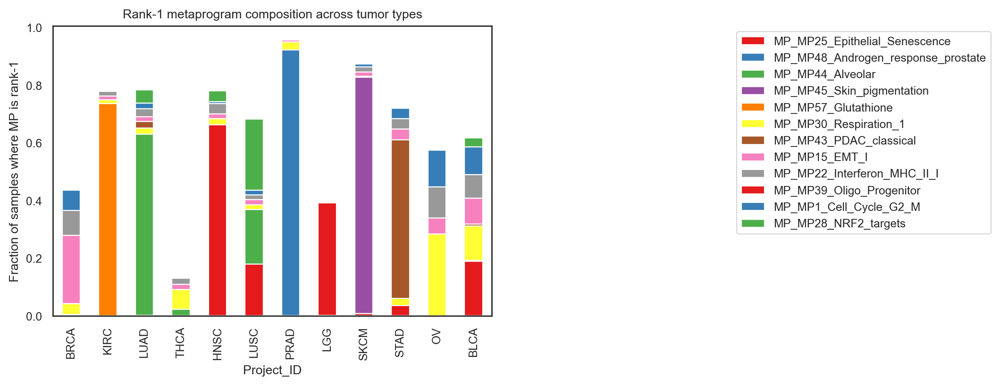

<Axes: title={'center': 'Rank-1 metaprogram composition across tumor types'}, xlabel='Project_ID', ylabel='Fraction of samples where MP is rank-1'>

In [28]:
bk.pl.metaprogram_rank1_composition_stackedbar(
    adata,
    topk_key="mp_topk",
    groupby="Project_ID",
    rank=1,
    top_groups=12,
    top_mps=12,
    figsize=(6, 4),
    legend=True,
    legend_bbox_to_anchor=(2.15, 1.0),
    legend_loc="upper right",
    rotation=90,
    title="Rank-1 metaprogram composition across tumor types",
    ylabel="Fraction of samples where MP is rank-1",
    show=True,
    save=DESKTOP + "mp_stackedbar.png",
    out_key="mp_rank1_composition",
)

In [ ]:
limiting to the top ~10–15 MPs globally keeps the figure readable. You can add a “Other” category if you want.

#### Cox univariate

heterogeneity entropy, continuous values

In [29]:
adata.obs["Neuroendocrine_score"] = pd.to_numeric(adata.obs["Neuroendocrine_score"], errors="coerce")

In [30]:
res, models = bk.tl.cox_univariate(
    adata,
    time_key="OS.time",
    event_key="OS",
    x_keys=[
        "mp_heterogeneity_entropy",
        "mp_dispersion_mad_zwithin_Project_ID",
        "Neuroendocrine_score",
        "Proliferation_score",
    ],
    x_mode="continuous",
    strata="Project_ID",
    out_key="cox_compare_candidates",
)

`bk.pl.cox_forest_from_uns()`:  
If uns is provided, adata can be None. If uns is None, adata must be provided and contain uns_key.

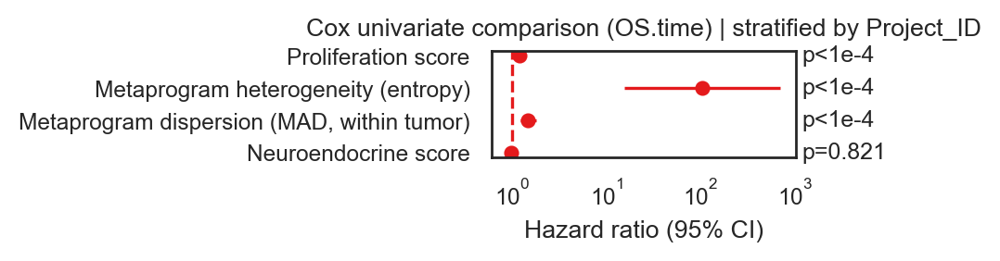

<Axes: title={'center': 'Cox univariate comparison (OS.time) | stratified by Project_ID'}, xlabel='Hazard ratio (95% CI)'>

In [31]:
bk.pl.cox_forest_from_uns(
    adata,
    uns_key="cox_compare_candidates",
    rename={
        "mp_heterogeneity_entropy": "Metaprogram heterogeneity (entropy)",
        "mp_dispersion_mad_zwithin_Project_ID": "Metaprogram dispersion (MAD, within tumor)",
        "Neuroendocrine_score": "Neuroendocrine score",
        "Proliferation_score": "Proliferation score",
    },
    sort_by="p",
    xscale="log",
    figsize=(5,1.5),
    save=DESKTOP+"Fig_CoxForest_compare_predictors.png",
)

### Run cox per group (in Project_ID)

In [32]:
cox_by_project = bk.pl.run_cox_per_group(
    adata,
    group_col="Project_ID",
    min_n=30,
    time_key="OS.time",
    event_key="OS",
    x_keys=[
        "mp_heterogeneity_entropy",
        "mp_dispersion_mad_zwithin_Project_ID",
        "Neuroendocrine_score",
        "Proliferation_score",
    ],
    strata=None,   # or e.g. strata="sex" if present within each tumor type
)

[OK] ACC: n=77 stored 'cox_ACC'
[OK] BLCA: n=426 stored 'cox_BLCA'


/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['x'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


[OK] BRCA: n=1211 stored 'cox_BRCA'
[OK] CESC: n=309 stored 'cox_CESC'
[OK] CHOL: n=45 stored 'cox_CHOL'
[OK] COAD: n=329 stored 'cox_COAD'
[OK] DLBC: n=47 stored 'cox_DLBC'
[OK] ESCA: n=195 stored 'cox_ESCA'
[OK] GBM: n=165 stored 'cox_GBM'
[OK] HNSC: n=564 stored 'cox_HNSC'
[OK] KICH: n=91 stored 'cox_KICH'
[OK] KIRC: n=603 stored 'cox_KIRC'
[OK] KIRP: n=321 stored 'cox_KIRP'
[OK] LAML: n=173 stored 'cox_LAML'
[OK] LGG: n=522 stored 'cox_LGG'
[OK] LIHC: n=421 stored 'cox_LIHC'
[OK] LUAD: n=574 stored 'cox_LUAD'
[OK] LUSC: n=548 stored 'cox_LUSC'
[OK] MESO: n=87 stored 'cox_MESO'
[OK] OV: n=426 stored 'cox_OV'
[OK] PAAD: n=183 stored 'cox_PAAD'


/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['x'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['x'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


[OK] PCPG: n=185 stored 'cox_PCPG'
[OK] PRAD: n=548 stored 'cox_PRAD'
[OK] READ: n=102 stored 'cox_READ'
[OK] SARC: n=264 stored 'cox_SARC'
[OK] SKCM: n=470 stored 'cox_SKCM'
[OK] STAD: n=450 stored 'cox_STAD'
[OK] TGCT: n=137 stored 'cox_TGCT'


/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['x'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


[OK] THCA: n=571 stored 'cox_THCA'
[OK] THYM: n=121 stored 'cox_THYM'
[OK] UCEC: n=194 stored 'cox_UCEC'
[OK] UCS: n=57 stored 'cox_UCS'
[OK] UVM: n=79 stored 'cox_UVM'


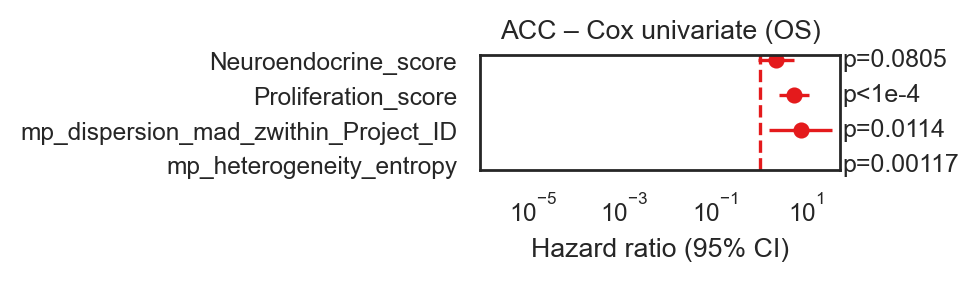

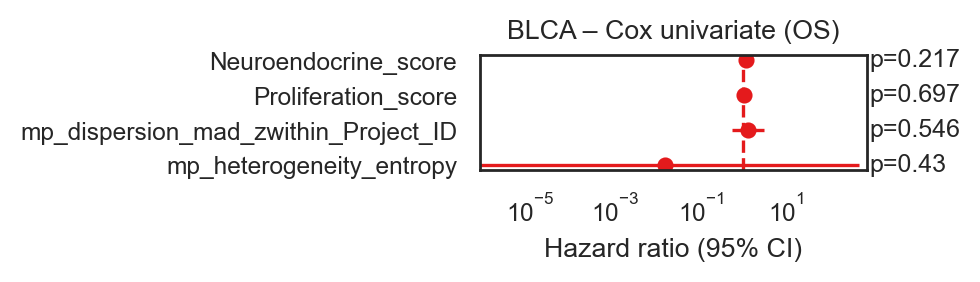

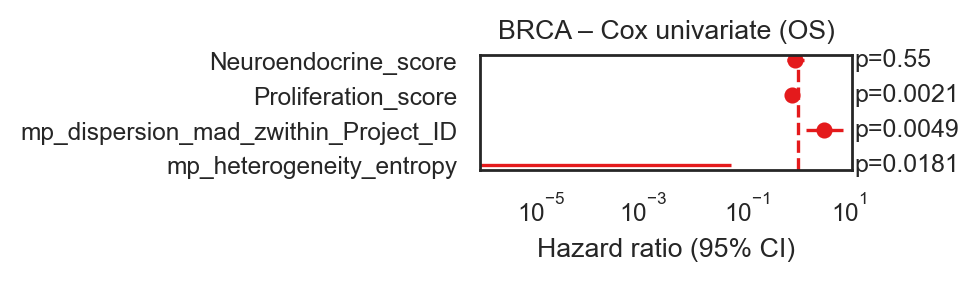

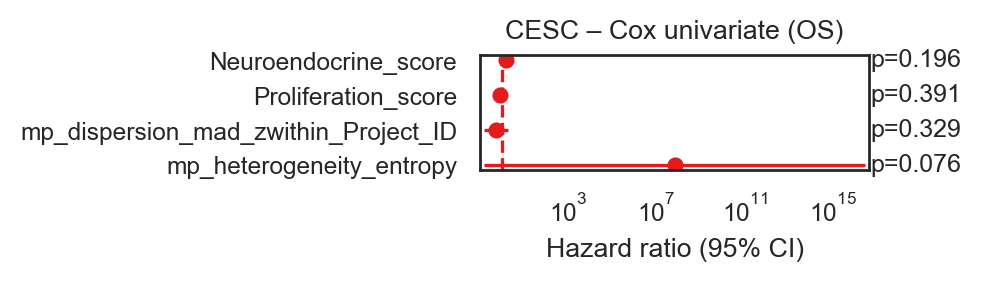

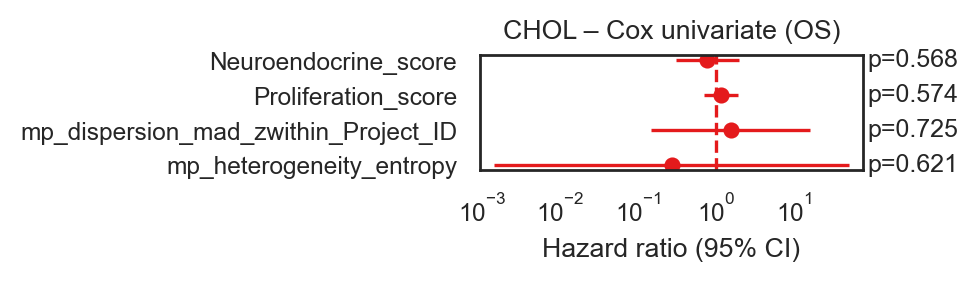

...

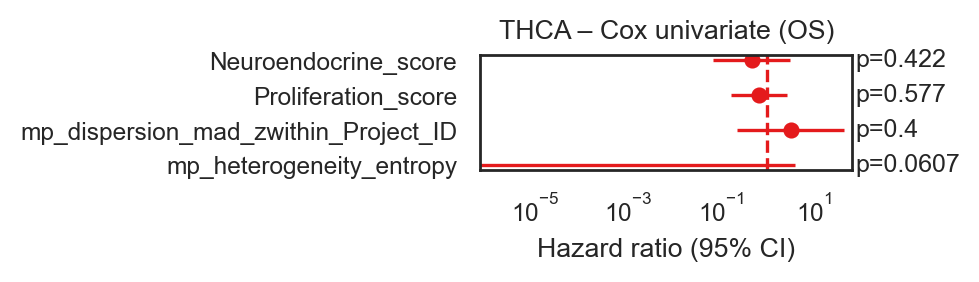

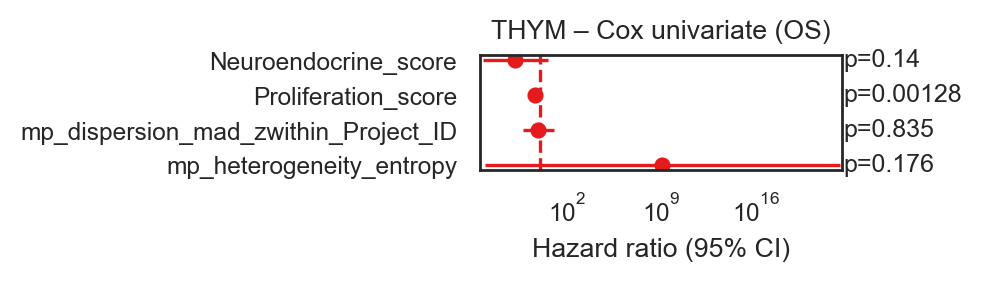

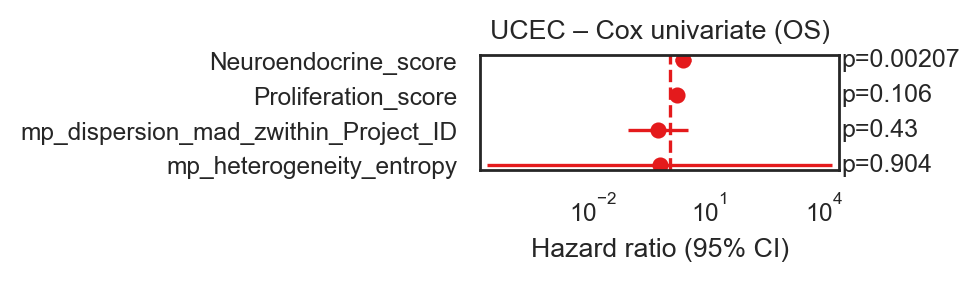

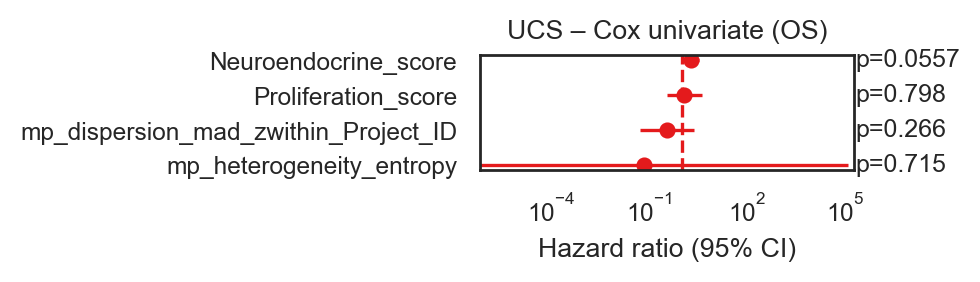

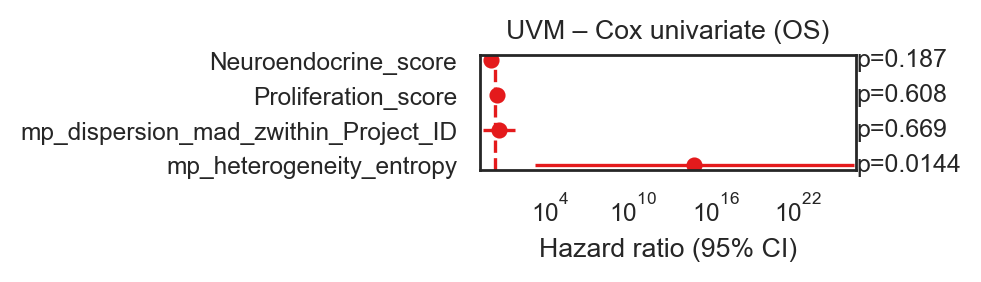

In [37]:
for pid, res in cox_by_project.items():
    bk.pl.cox_forest_from_uns(
        adata=None,
        uns=res,                     # now supported
        title=f"{pid} – Cox univariate (OS)",
        sort_by="name",
        xscale="log",
        figsize=(5, 1.5),          # or None for auto-height
        show=True,
        save=DESKTOP + f"Fig_CoxForest_{pid}.png",
    )

cox_by_project

In [39]:
def summarize_one_x_across_groups(cox_by_project: dict, x_key: str) -> dict:
    rows = []
    for pid, payload in cox_by_project.items():
        summ = payload.get("summary", None)
        if summ is None:
            continue
        if not isinstance(summ, pd.DataFrame):
            summ = pd.DataFrame(summ)

        # --- handle the “tidy multi-x” format ---
        if "x_key" in summ.columns:
            sub = summ[summ["x_key"].astype(str) == str(x_key)].copy()
            if sub.shape[0] == 0:
                continue
            r = sub.iloc[0]

        # --- handle “lifelines-like” single-model summary (indexed by covariate) ---
        else:
            if summ.index.name is None and "covariate" in summ.columns:
                summ = summ.set_index("covariate")
            if str(x_key) not in summ.index.astype(str):
                continue
            r = summ.loc[str(x_key)]

        rows.append(
            dict(
                x_key=str(pid),                       # project name becomes x_key
                term=str(x_key),                      # keep original covariate name
                HR=float(r["HR"]),
                HR_lower_95=float(r["HR_lower_95"]),
                HR_upper_95=float(r["HR_upper_95"]),
                p=float(r.get("p", np.nan)),
                n_used=float(r.get("n_used", np.nan)),
                events=float(r.get("events", np.nan)),
            )
        )

    df = pd.DataFrame(rows)
    return {
        "summary": df,
        "params": {"time_key": "OS.time", "strata": None, "note": f"{x_key} across groups"},
    }

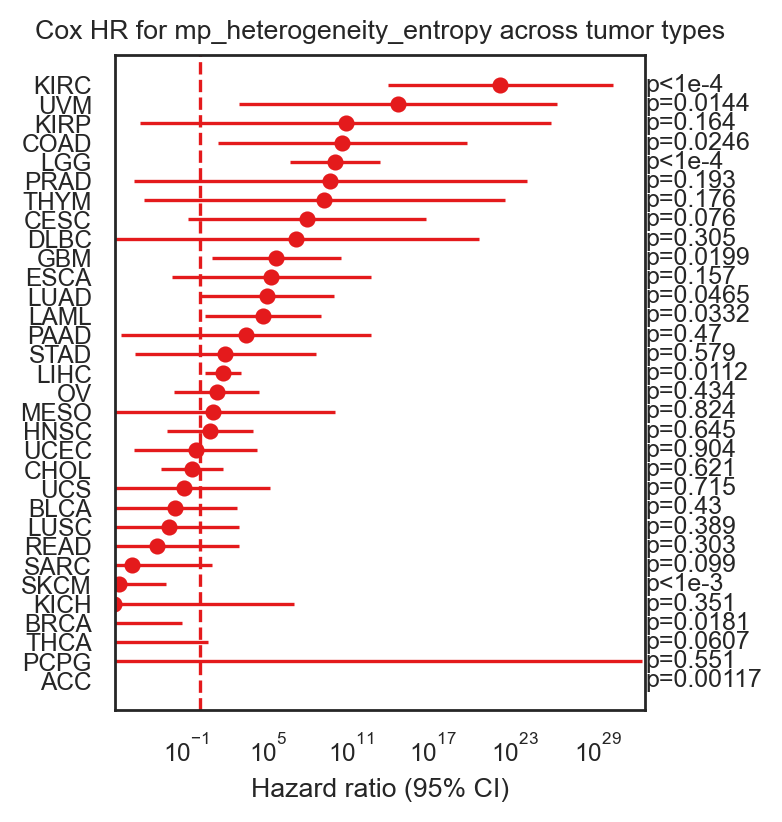

In [55]:
uns_one = summarize_one_x_across_groups(cox_by_project, "mp_heterogeneity_entropy")

ax = bk.pl.cox_forest_from_uns(
    adata=None,                 # if your updated function allows
    uns=uns_one,                # <-- pass directly
    title="Cox HR for mp_heterogeneity_entropy across tumor types",
    sort_by="HR",               # or "p" or "name"
    xscale="log",               # recommended for HR
    figsize=(4, 0.1 * len(uns_one["summary"]) + 0.9),
    show=True,
    save="Fig_CoxForest_mp_heterogeneity_byProject.svg",
)

In [ ]:
keep only projects with enough events or significant p-values

In [47]:
df = uns_one["summary"].copy()
df = df[df["events"].fillna(0) >= 20]          # example
uns_one["summary"] = df

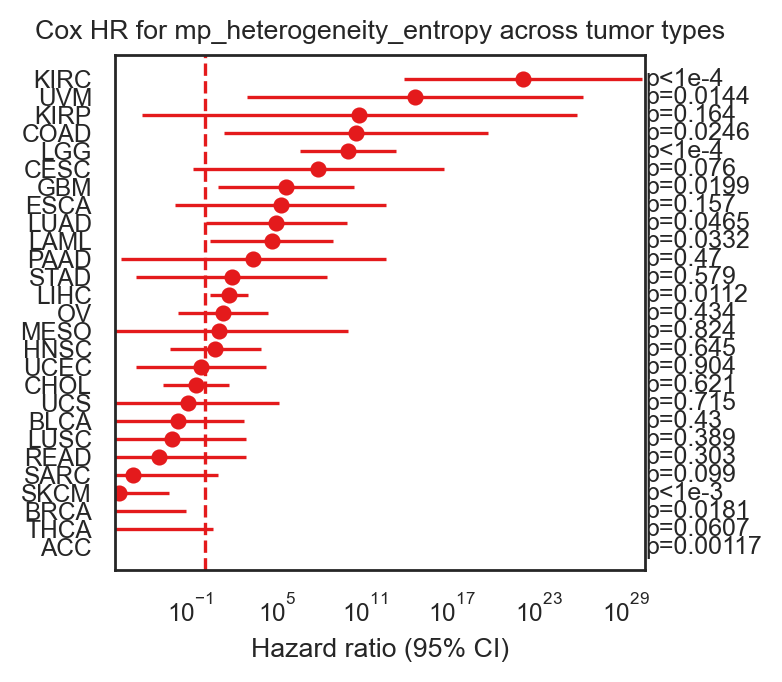

In [52]:
ax = bk.pl.cox_forest_from_uns(
    adata=None,                 # if your updated function allows
    uns=uns_one,                # <-- pass directly
    title="Cox HR for mp_heterogeneity_entropy across tumor types",
    sort_by="HR",               # or "p" or "name"
    xscale="log",               # recommended for HR
    figsize=(4, 0.1 * len(uns_one["summary"]) + 0.8),
    show=True,
    save="Fig_CoxForest_mp_heterogeneity_byProject.svg",
)
ax.set_xlim(, 3.0)
plt.show()

Binary extremes (if you prefer)

In [56]:
bk.tl.cox_univariate(
    adata,
    x_keys=["mp_heterogeneity_entropy", "Neuroendocrine_score"],
    x_mode="binary",
    q=(0.25, 0.75),
    binning="global",
    strata="Project_ID",
    out_key="cox_compare_binary",
)

(                      x_key   term      coef        HR  HR_lower_95  \
 0  mp_heterogeneity_entropy  x_bin  0.056249  1.057861     0.899238   
 1      Neuroendocrine_score  x_bin  0.151970  1.164126     0.993254   
 
    HR_upper_95         p  n_used  events  
 0     1.244466  0.497379    5172    1554  
 1     1.364393  0.060602    5172    1579  ,
 {'mp_heterogeneity_entropy': <lifelines.CoxPHFitter: fitted with 5172 total observations, 3618 right-censored observations>,
  'Neuroendocrine_score': <lifelines.CoxPHFitter: fitted with 5172 total observations, 3593 right-censored observations>})

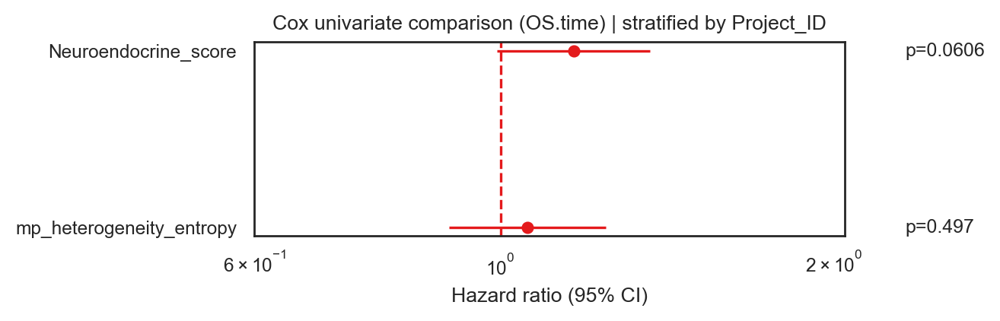

<Axes: title={'center': 'Cox univariate comparison (OS.time) | stratified by Project_ID'}, xlabel='Hazard ratio (95% CI)'>

In [57]:
bk.pl.cox_forest_from_uns(
    adata,
    uns_key="cox_compare_binary",
    sort_by="HR",
    save="Fig_CoxForest_compare_binary.svg",
)

#### Kaplan-Meier curves
Uses module lifetimes: - https://pypi.org/project/Lifetimes/

In [ ]:
2×2 interaction” Kaplan–Meier: NE-high/low × heterogeneity-high/low

This is a killer figure for the story (and it’s simple).
If you want, tell me which survival endpoint you prefer (OS, DSS, PFI) and I’ll give you the exact code that:
	•	bins NE and heterogeneity into high/low (e.g., quartiles),
	•	builds 4 groups,
	•	plots KM + Cox interaction

In [34]:
adata_coad = adata[adata.obs.Project_ID == "COAD"]

               coef        HR  HR_lower_95  HR_upper_95         p
covariate                                                        
x_bin      0.200441  1.221942     0.840185     1.777159  0.294266
z_bin      0.095053  1.099718     0.649396     1.862312  0.723586
x_z       -0.134456  0.874191     0.494289     1.546080  0.643947


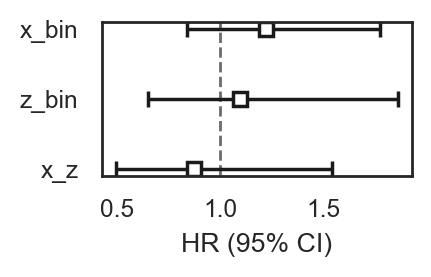

In [24]:
cph, df_used = bk.tl.cox_interaction(
    adata,
    time_key="OS.time",
    event_key="OS",
    x_key="Proliferation_score",
    z_key="mp_heterogeneity_entropy",
    strata="Project_ID",              # stratified baseline hazards by tumor type
    binning="global",          # or "global"within_group
    q=(0.25, 0.75),
    keep="extremes",
    covariates=None,           # e.g. ["gender", "Age at Diagnosis in Years"] after cleaning
    out_key="cox_NE_x_mphet_OS",
)

# Print HRs
print(adata.uns["cox_NE_x_mphet_OS"]["summary"])

# Forest plot
fig, ax = plt.subplots(figsize=(2,1))
ax = cph.plot(hazard_ratios=True)
ax.figure.savefig("Fig_Cox_NE_x_Heterogeneity.svg", bbox_inches="tight")
plt.show()

Text(0.5, 1.0, 'Stratified Cox model: NE × Metaprogram heterogeneity')

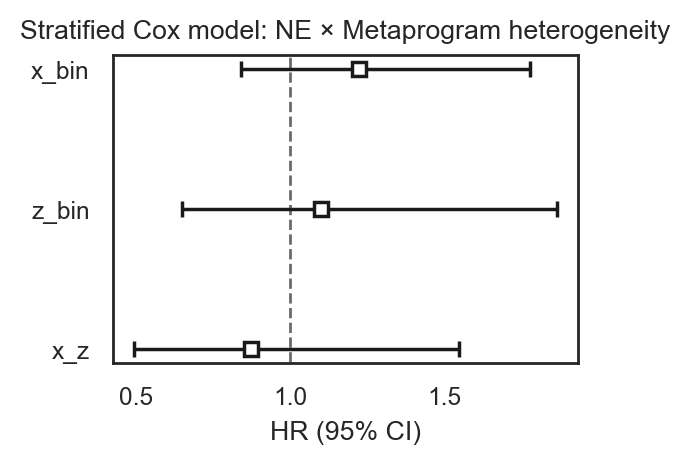

In [25]:
fig, ax = plt.subplots(figsize=(3,2), dpi=200)
ax = cph.plot(hazard_ratios=True)
ax.set_title("Stratified Cox model: NE × Metaprogram heterogeneity")

# ax.figure.savefig("Fig_Cox_NE_x_Heterogeneity.svg", bbox_inches="tight")

#### KM Univariate

In [ ]:
Produces:
	•	KM curves (low vs high)
	•	Log-rank p-value on plot
	•	adata.uns["km_1d"]["logrank_p"] stored for Results text

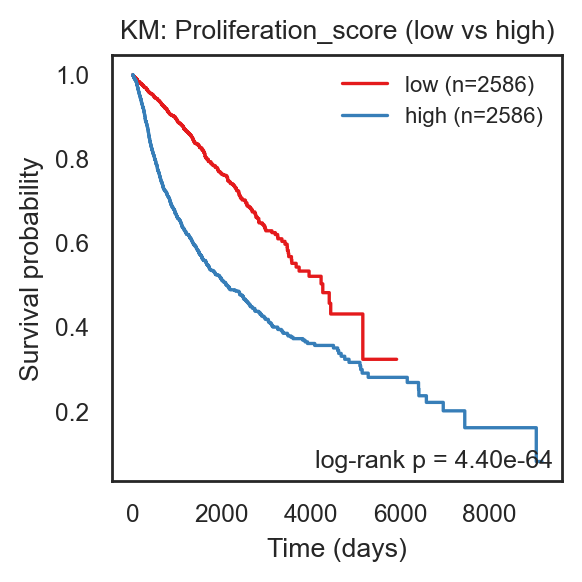

<Axes: title={'center': 'KM: Proliferation_score (low vs high)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [36]:
bk.pl.km_univariate(
    adata,
    x_key="Proliferation_score",
    time_key="OS.time",
    event_key="OS",
    logrank=True,
    figsize=(3, 3),
    save="Fig_KM_Heterogeneity_OS.svg",
)

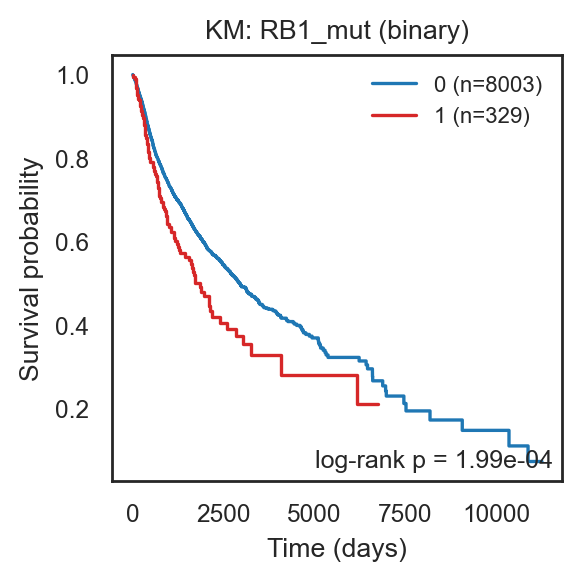

<Axes: title={'center': 'KM: RB1_mut (binary)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [12]:
bk.pl.km_univariate(
    adata,
    x_key="RB1_mut",
    x_source="obs",
    binary_mode="auto",                 # or "force"
    binary_labels=("WT", "Mut"),
    palette={"0":"tab:blue", "1":"tab:red"},
    min_n=20,
    figsize=(3, 3),
    logrank=True,
)

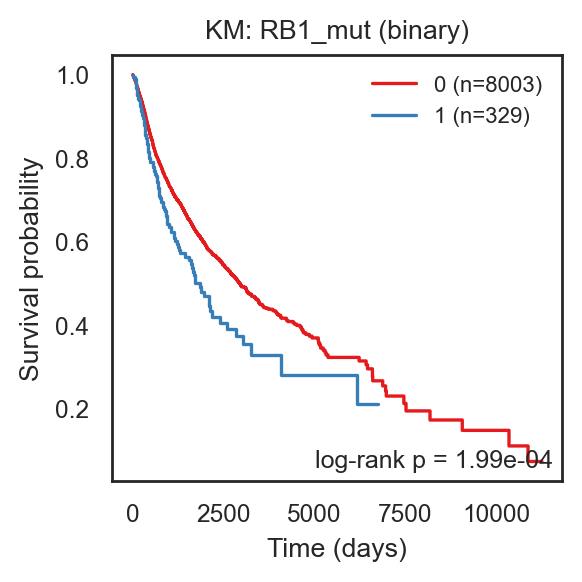

<Axes: title={'center': 'KM: RB1_mut (binary)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [9]:
bk.pl.km_univariate(
    adata,
    x_key="RB1_mut",
    time_key="OS.time",
    event_key="OS",
    logrank=True,
    figsize=(3, 3),
    save="Fig_KM_Heterogeneity_OS.svg",
)

In [13]:
bk.pl.km_univariate(
    adata,
    x_key="mp_heterogeneity_entropy",
    palette=("tab:blue", "tab:orange"),   # low, high
    logrank=True,
)

KeyError: "'mp_heterogeneity_entropy' not found in adata.obs.columns or adata.var_names (source='auto')."

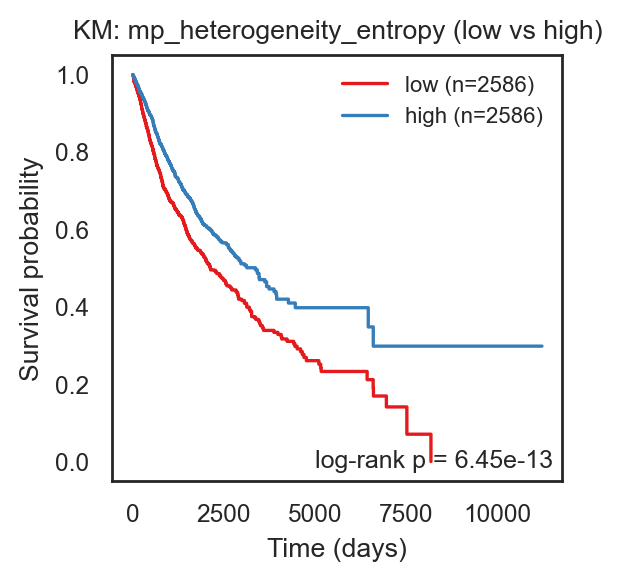

<Axes: title={'center': 'KM: mp_heterogeneity_entropy (low vs high)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [26]:
bk.pl.km_univariate(
    adata,
    x_key="mp_heterogeneity_entropy",
    time_key="OS.time",
    event_key="OS",
    logrank=True,
    figsize=(3, 3),
    save="Fig_KM_Heterogeneity_OS.svg",
)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/cox.py:1717: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[x_obs_key] = _as_1d_gene(adata, x_key, layer)


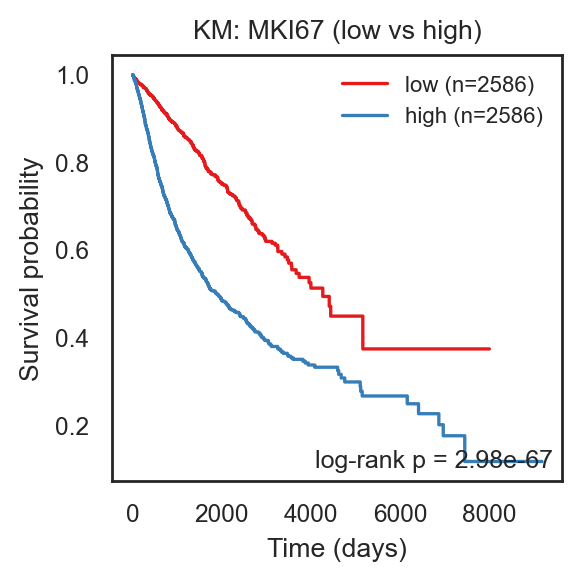

<Axes: title={'center': 'KM: MKI67 (low vs high)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [28]:
bk.pl.km_univariate(
    adata,
    x_key="MKI67",
    x_source="gene",
    time_key="OS.time",
    event_key="OS",
    layer="log1p_cpm",
    group_col=None,
    orce_rebin=True,    # if iterating quickly
    logrank=True,
    figsize=(3, 3),
    save="Fig_KM_Heterogeneity_OS.svg",
)

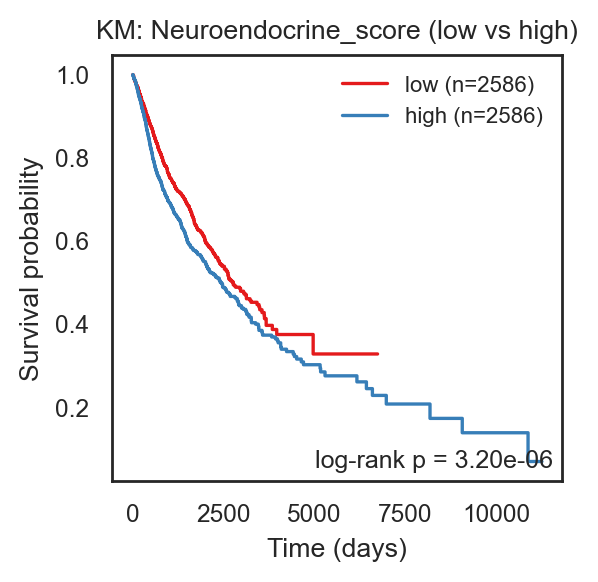

<Axes: title={'center': 'KM: Neuroendocrine_score (low vs high)'}, xlabel='Time (days)', ylabel='Survival probability'>

In [29]:
bk.pl.km_univariate(
    adata,
    x_key="Neuroendocrine_score",
    time_key="OS.time",
    event_key="OS",
    logrank=True,
    figsize=(3, 3),
    save="Fig_KM_Heterogeneity_OS.svg",
)

#### KM 2x2 interaction

#### Cox model stratified by Project_ID (main result)

Uses lifelines

| Term | Meaning | 
| --------- | ----------------------------- |
| NE_bin | Effect of high vs low NE when heterogeneity is low |
| HET_bin |  Effect of high vs low heterogeneity when NE is low |
| NE_x_HET | Extra risk (or protection) when both NE and heterogeneity are high |

If NE_x_HET is significant, that’s your interaction:  
NE programs are particularly deleterious in heterogeneous tumors.

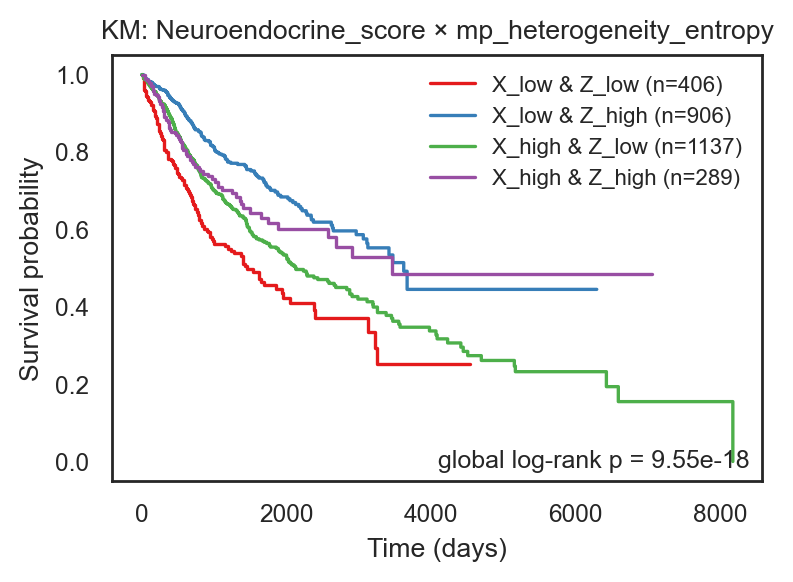

<Axes: title={'center': 'KM: Neuroendocrine_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [32]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="Neuroendocrine_score",
    x_source="obs",
    z_key="mp_heterogeneity_entropy",
    z_source="auto",
    layer="log1p_cpm",
    group_col=None,      # strongly recommended
    force_rebin=True,
    logrank=True,
    figsize=(4,3),
)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/cox.py:2021: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  obs[out_col] = group


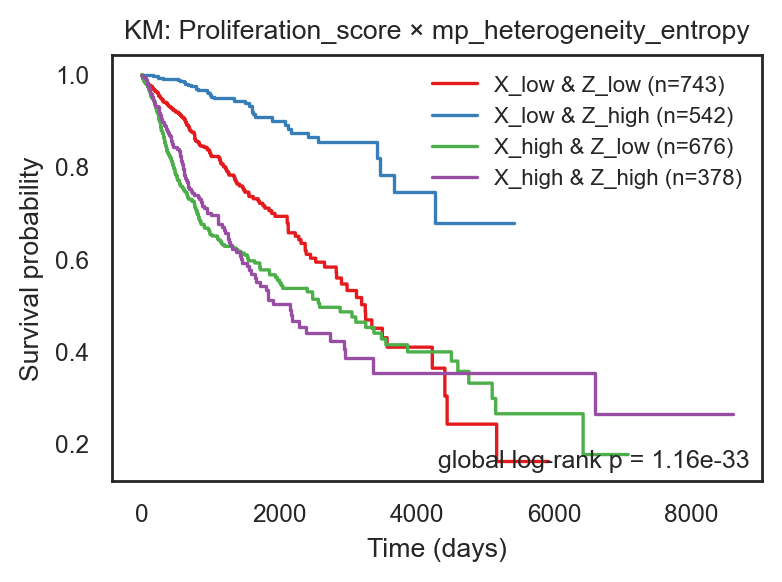

<Axes: title={'center': 'KM: Proliferation_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [33]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="Proliferation_score",
    x_source="obs",
    z_key="mp_heterogeneity_entropy",
    z_source="auto",
    layer="log1p_cpm",
    group_col=None,      # strongly recommended
    force_rebin=True,
    logrank=True,
    figsize=(4,3),
)

In [45]:
adata_coad = adata[(adata.obs["Project_ID"] == "COAD") | (adata.obs["Project_ID"] == "LUAD")].copy()

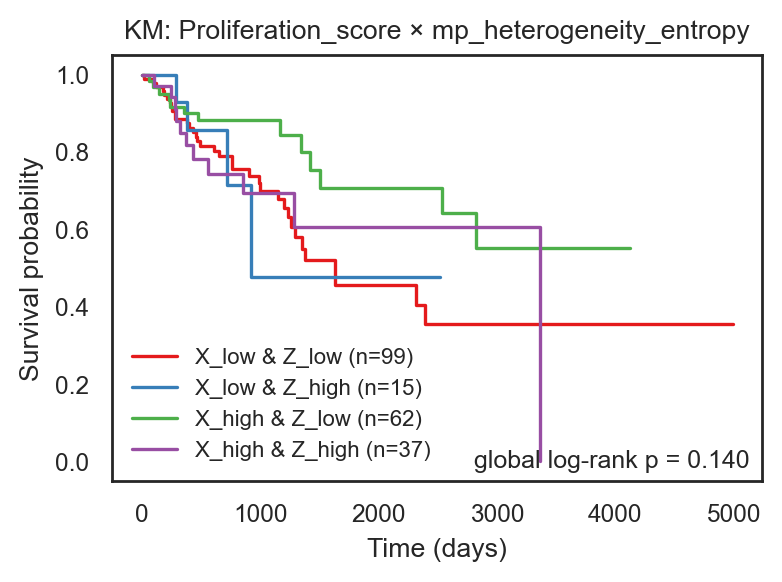

<Axes: title={'center': 'KM: Proliferation_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [46]:
bk.pl.km_2x2_interaction(
    adata_coad,
    x_key="Proliferation_score",
    x_source="obs",
    z_key="mp_heterogeneity_entropy",
    z_source="auto",
    min_n=15, 
    keep="extremes",
    layer="log1p_cpm",
    group_col=None,      # strongly recommended
    force_rebin=True,
    logrank=True,
    figsize=(4,3),
)

Global quantiles (pan-cancer):

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/cox.py:2021: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  obs[out_col] = group


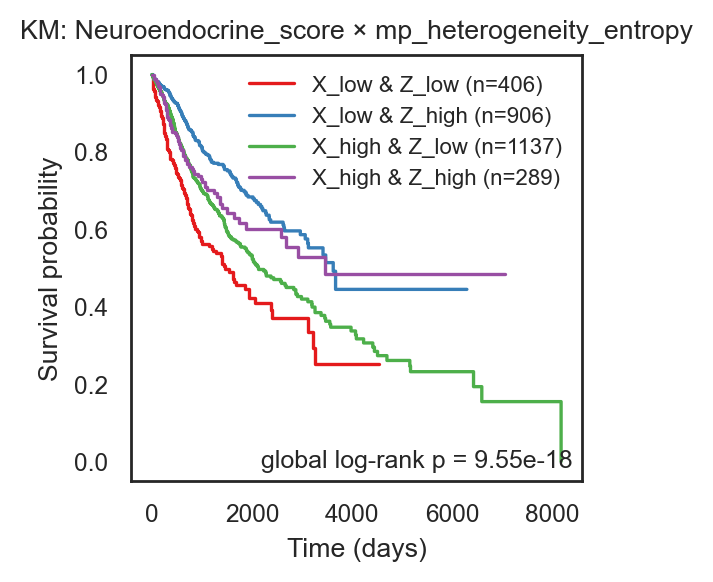

<Axes: title={'center': 'KM: Neuroendocrine_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [47]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="Neuroendocrine_score",         # or "NE25_score"
    z_key="mp_heterogeneity_entropy",
    x_source="obs",                      # ["auto", "obs", "gene"] = "auto",
    z_source="obs",                      # ["auto", "obs", "gene"] = "auto",
    time_key="OS.time",
    event_key="OS",
    binning="global",               # "global" | "within_group"
    logrank=True,
    q=(0.25, 0.75),
    min_n=50,
    figsize=(3, 3),
    save="Fig_KM_NE_x_Heterogeneity.svg",
)

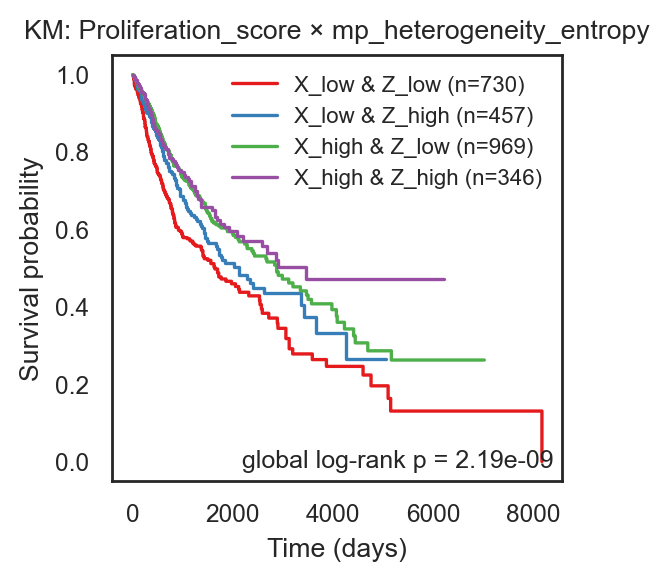

<Axes: title={'center': 'KM: Proliferation_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [274]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="Proliferation_score",         # or "NE25_score"
    z_key="mp_heterogeneity_entropy",
    time_key="OS.time",
    event_key="OS",
    binning="global",
    logrank=True,
    q=(0.25, 0.75),
    min_n=50,
    figsize=(3, 3),
    save="Fig_KM_NE_x_Heterogeneity.svg",
)

In [ ]:
Within tumor type quantiles (optional, often fairer):

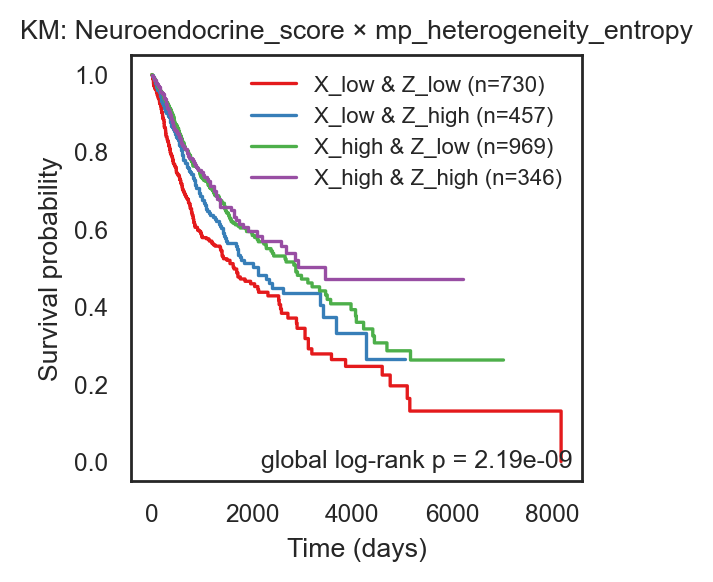

<Axes: title={'center': 'KM: Neuroendocrine_score × mp_heterogeneity_entropy'}, xlabel='Time (days)', ylabel='Survival probability'>

In [277]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="Neuroendocrine_score",
    z_key="mp_heterogeneity_entropy",
    time_key="OS.time",
    event_key="OS",
    binning="within_group",
    groupby_for_binning="Project_ID",
    logrank=True,
    q=(0.25, 0.75),
    min_n=40,
    figsize=(3, 3),
    save=DESKTOP+"Fig_KM_NE_x_Heterogeneity_withinTumor.svg",
)

Use it also for interaction between genes

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/cox.py:1932: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[x_obs_key] = _as_1d_gene(adata, x_key, layer)
/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/tl/cox.py:2021: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  obs[out_col] = group


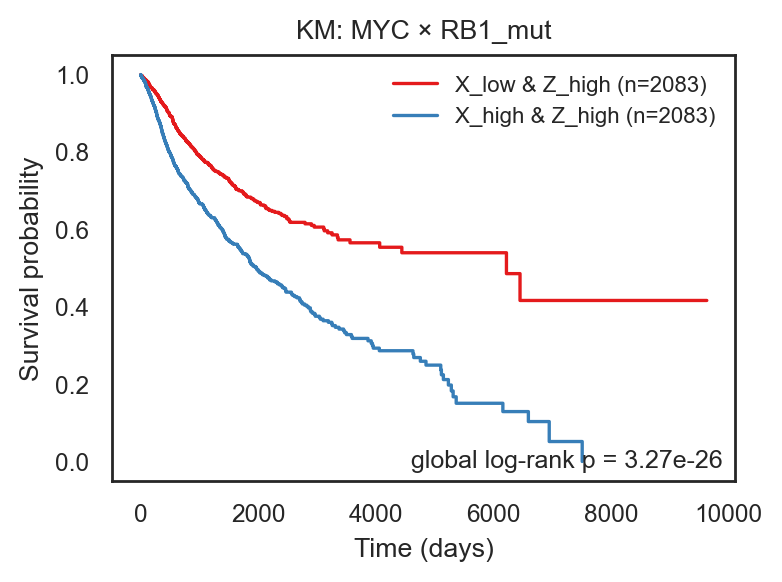

<Axes: title={'center': 'KM: MYC × RB1_mut'}, xlabel='Time (days)', ylabel='Survival probability'>

In [39]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="MYC",
    x_source="gene",
    z_key="RB1_mut",
    z_source="obs",
    layer="log1p_cpm",
    group_col=None,      # strongly recommended
    force_rebin=True,
    logrank=True,
    figsize=(4,3),
)

/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/cox.py:1932: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[x_obs_key] = _as_1d_gene(adata, x_key, layer)
/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/BioInformatics/BioProjects/MM01_BULLKpy/bullkpy-skeleton/src/bullkpy/pl/cox.py:1937: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs[z_obs_key] = _as_1d_gene(adata, z_key, layer)
/Users/mmalumbres/Library/CloudStorage/OneDrive-VHIO/B

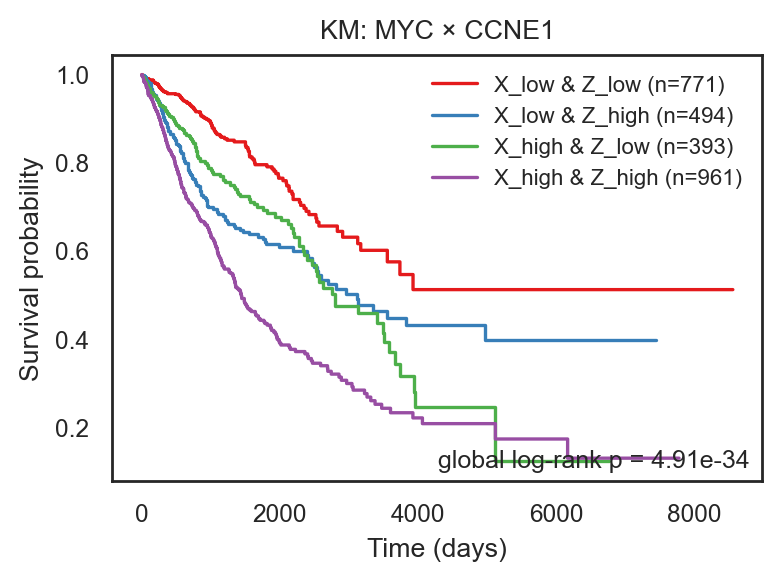

<Axes: title={'center': 'KM: MYC × CCNE1'}, xlabel='Time (days)', ylabel='Survival probability'>

In [50]:
bk.pl.km_2x2_interaction(
    adata,
    x_key="MYC",
    x_source="gene",
    z_key="CCNE1",
    z_source="gene",
    layer="log1p_cpm",
    group_col=None,      # strongly recommended
    force_rebin=True,
    logrank=True,
    figsize=(4,3),
)

In [ ]:
You can easily extend the model:
formula = "NE_bin + HET_bin + NE_x_HET + age + gender"

In [ ]:
Change palette in km_2x2:
bk.pl.km_2x2_interaction(
    adata,
    x_key="RB1_mut",
    x_source="obs",
    x_binary_mode="auto",
    x_binary_labels=("WT","Mut"),
    z_key="mp_heterogeneity_entropy",
    z_source="obs",
    palette={
        "X_low & Z_low": "tab:blue",
        "X_low & Z_high": "tab:cyan",
        "X_high & Z_low": "tab:orange",
        "X_high & Z_high": "tab:red",
    },
    min_n=30,
    logrank=True,
    force_rebin=True,
)

In [ ]:
bk.pl.km_2x2_interaction(
    adata,
    palette=("tab:blue", "tab:green", "tab:orange", "tab:red"),
)

# 12. Additional Plots 
<a id="plots"></a>

## 11.1. Dotplot

In [5]:
# Check if genes have zeros (e.g. Fraction of samples expressing is not 1)

genes = ["CDK1","MKI67","CD3E","CD79A","MS4A1"]
gidx = [adata.var_names.get_loc(g) for g in genes]
X = adata.layers["counts"][:, gidx]
X = X.toarray() if hasattr(X, "toarray") else np.asarray(X)

print("fraction >0 per gene:", (X > 0).mean(axis=0))
print("min/max counts per gene:", X.min(axis=0), X.max(axis=0))

fraction >0 per gene: [1.         1.         0.98876404 0.88764045 0.88764045]
min/max counts per gene: [5 2 0 0 0] [1156 1003  195  383  966]


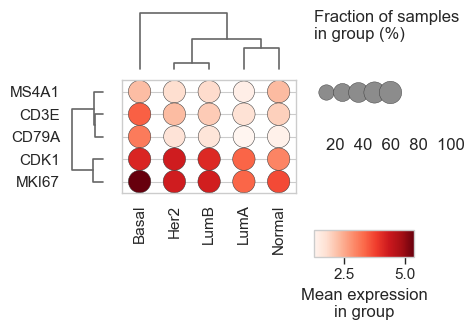

(<Figure size 615x475 with 5 Axes>, <Axes: >)

In [6]:
bk.pl.dotplot(
    adata,
    var_names=["CDK1","MKI67","CD3E","CD79A","MS4A1"],
    groupby="Subtype_PAM50",
    swap_axes=True,
    row_spacing = 0.4,
    dendrogram_top=True,
    dendrogram_rows=True,
    row_dendrogram_position="outer_left",
    title=None,
)

In [7]:
markers = {
    "B-cell": ["CD79A","MS4A1"],
    "Dendritic": ["FCER1A"],
    "Monocytes": ["CST3","FCGR3A"],
    "NK": ["GNLY","NKG7"],
    "Other": ["IGLL1"],
    "T-cell": ["CD3D"],
}

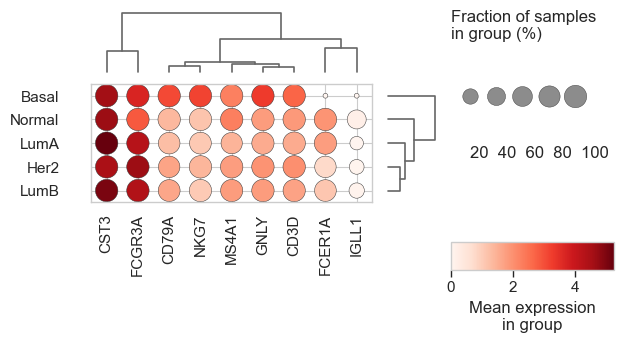

(<Figure size 835x475 with 5 Axes>, <Axes: >)

In [8]:
#var_groups dict (Scanpy-like brackets + ordering)

bk.pl.dotplot(
    adata,
    var_groups=markers,
    groupby="Subtype_PAM50",
    swap_axes=False,
    row_spacing = 0.4,
    dendrogram_rows=True,  # cluster groups
    dendrogram_top=True,  # cluster genes within the full list (still keeps brackets)
    save="figs/dotplot_scanpy_like.png",
)

### CHECK MARKERS DICT GROUPS WITH NO DENDRIMGRAM

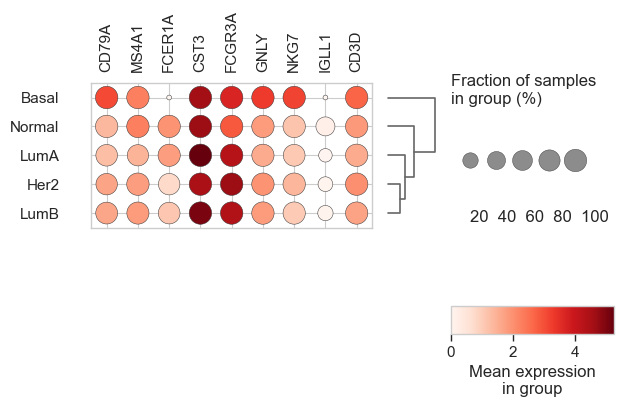

(<Figure size 835x475 with 4 Axes>, <Axes: >)

In [12]:
bk.pl.dotplot(
    adata,
    var_groups=markers,
    groupby="Subtype_PAM50",
    swap_axes=False,
    row_spacing = 0.4,
    dendrogram_rows=True,  # cluster groups
    dendrogram_top=False,  # cluster genes within the full list (still keeps brackets)
    save="figs/dotplot_scanpy_like.png",
)

## 11.2. Heatmap

In [13]:
res.columns.tolist()

['gene', 'log2FC', 't', 'pval', 'qval', 'mean_group', 'mean_ref']

In [51]:
# 2) heatmap of top DE genes
bk.pl.heatmap_de(
    adata,
    contrast="LumB_vs_LumA",
    groupby="Subtype_PAM50",
    groups=["LumA", "LumB"],
    layer="log1p_cpm",
    top_n=60,
    mode="both",
    col_colors=["Subtype_PAM50"],
    save=DESKTOP + "clustermap.png",
)


KeyError: "Could not find DE results at adata.uns['de']['LumB_vs_LumA']['results']"

## 11.3. Violin plot

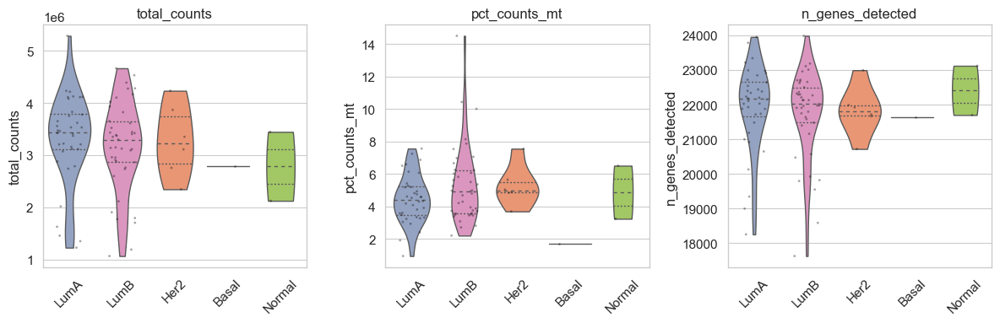

(<Figure size 1200x400 with 3 Axes>,
 array([<Axes: title={'center': 'total_counts'}, ylabel='total_counts'>,
        <Axes: title={'center': 'pct_counts_mt'}, ylabel='pct_counts_mt'>,
        <Axes: title={'center': 'n_genes_detected'}, ylabel='n_genes_detected'>],
       dtype=object))

In [14]:
bk.pl.violin(
    adata,
    keys=["total_counts", "pct_counts_mt", "n_genes_detected"],
    groupby="Subtype_PAM50",
    order=["LumA", "LumB", "Her2", "Basal", "Normal"],
    #figsize=(6, 3),
    save="figs/violin_qc.png",
)

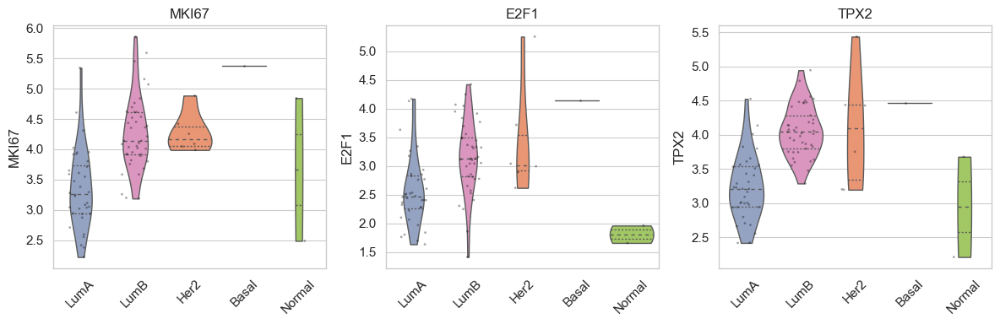

(<Figure size 1200x400 with 3 Axes>,
 array([<Axes: title={'center': 'MKI67'}, ylabel='MKI67'>,
        <Axes: title={'center': 'E2F1'}, ylabel='E2F1'>,
        <Axes: title={'center': 'TPX2'}, ylabel='TPX2'>], dtype=object))

In [13]:
bk.pl.violin_genes(adata, genes=["MKI67","E2F1", "TPX2"], groupby="Subtype_PAM50", 
                   order=["LumA", "LumB", "Her2", "Basal", "Normal"],
                   layer="log1p_cpm",
                   #figsize=(3, 4),
                   save="figs/violin_genes.png")

## 11.4. Violin Gene Plot

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

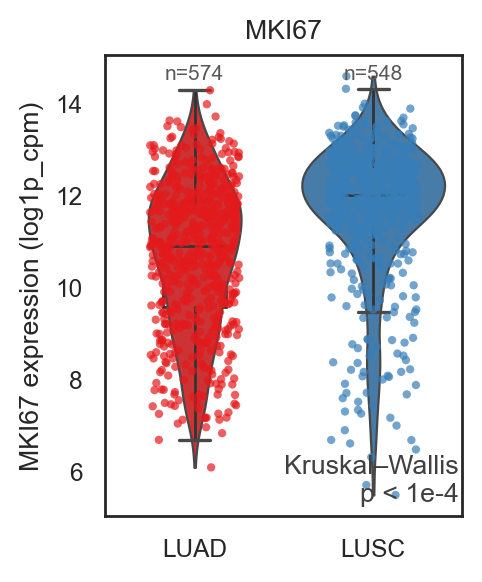

(<Figure size 500x600 with 1 Axes>,
 <Axes: title={'center': 'MKI67'}, ylabel='MKI67 expression (log1p_cpm)'>,
 {'test': 'Kruskal–Wallis', 'pvalue': 9.651818201137253e-34, 'compare': None})

In [55]:
bk.pl.gene_plot(
    adata_lung,
    gene="MKI67",
    groupby="Project_ID",
    layer="log1p_cpm",
    test="auto",           # defaults to Kruskal
    kind="both",
    figsize=(2.5,3),
    save=DESKTOP + "MKI67_by_lung.png",
)

/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/mmalumbres/mambaforge/envs/biopython/lib/python3.10/site-packages/seaborn/categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain

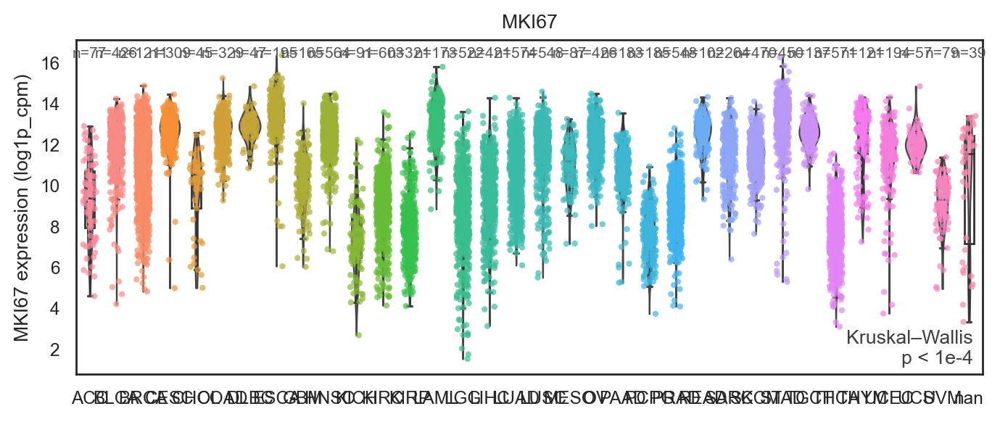

(<Figure size 1400x600 with 1 Axes>,
 <Axes: title={'center': 'MKI67'}, ylabel='MKI67 expression (log1p_cpm)'>,
 {'test': 'Kruskal–Wallis', 'pvalue': 0.0, 'compare': None})

In [57]:
bk.pl.gene_plot(
    adata,
    gene="MKI67",
    groupby="Project_ID",
    layer="log1p_cpm",
    test="auto",           # defaults to Kruskal
    kind="both",
    figsize=(7,3),
    save=DESKTOP + "MKI67_by_lung.png",
)

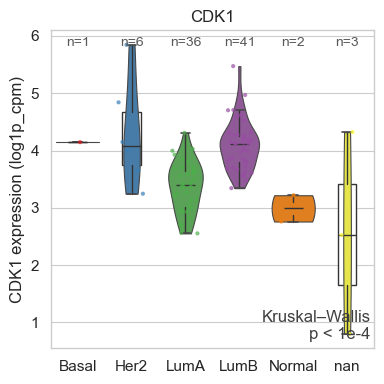

(<Figure size 400x400 with 1 Axes>,
 <Axes: title={'center': 'CDK1'}, ylabel='CDK1 expression (log1p_cpm)'>,
 {'test': 'Kruskal–Wallis', 'pvalue': 3.3816506907753345e-07, 'compare': None})

In [22]:
# Overall p-value across all PAM50 subtypes
bk.pl.gene_plot(
    adata,
    gene="CDK1",
    groupby="Subtype_PAM50",
    layer="log1p_cpm",
    test="auto",           # defaults to Kruskal
    kind="both",
    figsize=(4,4),
    save="figs/CDK1_by_PAM50.png",
)

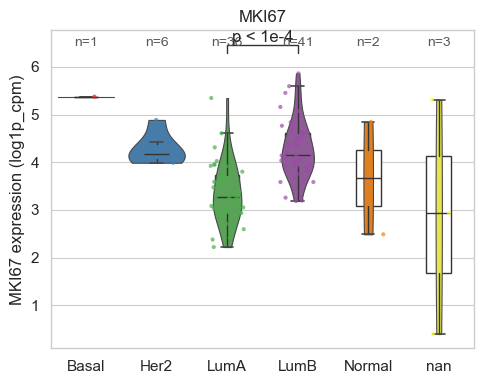

(<Figure size 500x400 with 1 Axes>,
 <Axes: title={'center': 'MKI67'}, ylabel='MKI67 expression (log1p_cpm)'>,
 {'test': 'Mann–Whitney U',
  'pvalue': 5.433595540609767e-08,
  'compare': ['LumA', 'LumB']})

In [24]:
# Pairwise LumA vs LumB with bracket
bk.pl.gene_plot(
    adata,
    gene="MKI67",
    groupby="Subtype_PAM50",
    layer="log1p_cpm",
    compare=["LumA", "LumB"],
    test="wilcoxon",       # Mann–Whitney U
    kind="both",
    figsize=(5,4),
    save="figs/MKI67_LumA_vs_LumB.png",
)

## 11.5. Sample distances

A) Sample distances (Euclidean on log1p_cpm) + metadata colors

In [ ]:
bk.pl.sample_distances(
    adata,
    layer="log1p_cpm",
    metric="euclidean",
    method="average",
    col_colors=["Subtype_PAM50", "Batch"],
    show_labels=False,
    save="figs/sample_distances.png",
)

B) Sample correlation clustergram (recommended for bulk QC)

In [ ]:
bk.pl.sample_correlation_clustergram(
    adata,
    layer="log1p_cpm",
    method="pearson",
    col_colors=["Subtype_PAM50", "Batch"],
    show_labels=False,
    save="figs/sample_corr_clustergram.png",
)

C) Spearman correlation version (robust)

In [ ]:
bk.pl.sample_correlation_clustergram(
    adata,
    layer="log1p_cpm",
    method="spearman",
    col_colors=["Subtype_PAM50"],
    save="figs/sample_corr_spearman.png",
)

## 11.6. Oncoprint

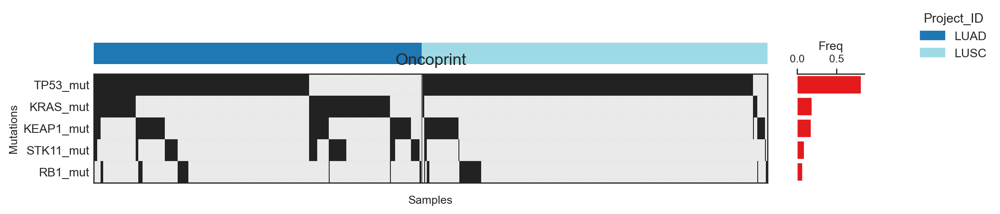

(<Figure size 3000x400 with 3 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [15]:
bk.pl.oncoprint(
    adata_lung,
    mut_cols=["KRAS_mut", "TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    group_blocks=True,
    grid_color="0.9",
    title=None,
    fontsize=12,
    #figsize=(15,2),
    save=DESKTOP + "oncoprint_mutfirst_by_project.png",
)

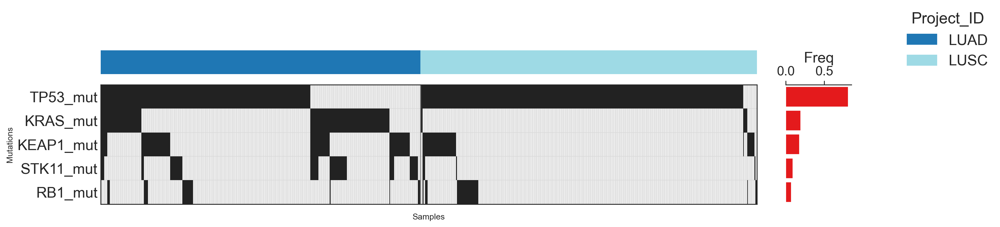

(<Figure size 4000x600 with 3 Axes>,
 <Axes: title={'center': ' '}, xlabel='Samples', ylabel='Mutations'>)

In [33]:
bk.pl.oncoprint(
    adata_lung,
    mut_cols=["KRAS_mut", "TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    group_blocks=True,
    fontsize=20,
    title=" ",
    figsize=(20,3),
    save=DESKTOP + "oncoprint_mutfirst_by_project_lung.png",
)

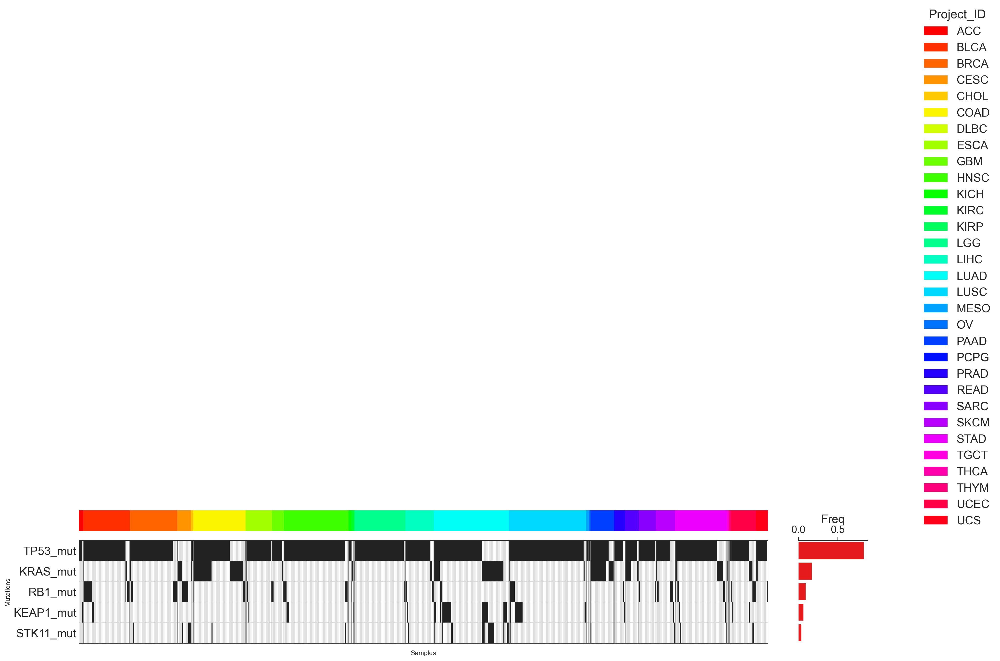

(<Figure size 5360x660 with 3 Axes>,
 <Axes: title={'center': ' '}, xlabel='Samples', ylabel='Mutations'>)

In [29]:
# Large datasets (avoid huge images)
bk.pl.oncoprint(
    adata,
    mut_cols=["KRAS_mut", "TP53_mut", "RB1_mut", "STK11_mut", "KEAP1_mut"],
    groupby="Project_ID",
    max_samples=800,          # IMPORTANT for TCGA-scale
    cell_size=0.03,           # compact columns
    fontsize=20,
    title=" ",
    save_dpi=300,             # keep under pixel limit
    save=DESKTOP + "oncoprint_big.png",
)

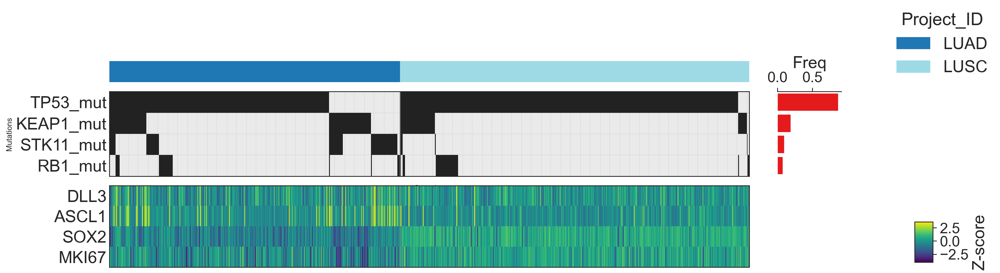

(<Figure size 4160x860 with 5 Axes>,
 <Axes: title={'center': ' '}, xlabel='Samples', ylabel='Mutations'>)

In [28]:
#Add expression tracks under the mutations
bk.pl.oncoprint(
    adata_lung,
    mut_cols=["RB1_mut", "TP53_mut", "KEAP1_mut", "STK11_mut"],
    expr_genes=["DLL3", "ASCL1", "SOX2", "MKI67"],
    layer="log1p_cpm",
    expr_zscore=True,              # makes expression rows comparable
    groupby="Project_ID",
    sort_samples="pattern",
    #top_annotation_height=0.35,
    title=" ",
    fontsize=24,
    save_dpi=300,
    save=DESKTOP + "oncoprint_plus_expr.png",
)

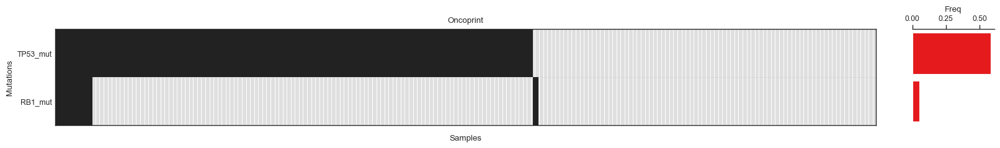

(<Figure size 2524x190 with 2 Axes>,
 <Axes: title={'center': 'Oncoprint'}, xlabel='Samples', ylabel='Mutations'>)

In [18]:
# Control the order
bk.pl.oncoprint(
    adata_lung,
    drop_all_wt = False,
    mut_cols=["RB1_mut", "TP53_mut"],
    #group_order=,  # or any subset/order list(adata.obs_names),
    sort_samples="mut_first"     # "burden",     #"none",
)

# 13. Other Utilities
<a id="utilities"></a>

## 12.1. Batch Correction

Best practice is to run ComBat on log-normalized expression (not raw counts):

In [7]:
adata.obs.Batch.value_counts()

Batch4    29
Batch2    17
Batch3    17
Batch1    13
Batch5    10
Name: Batch, dtype: int64

In [8]:
bk.pp.batch_correct_combat(
    adata,
    batch_key="Batch",
    layer="log1p_cpm",
    covariates=["Subtype_PAM50"],   # preserve biology
    key_added="combat_log1p_cpm",
)

INFO: ComBat: correcting layer='log1p_cpm' with batch_key='Batch' (5 batches), covariates=['Subtype_PAM50']
INFO: ComBat: stored corrected matrix in adata.layers['combat_log1p_cpm']


In [10]:
adata.layers

Layers with keys: counts, cpm, log1p_cpm, combat_log1p_cpm

In [ ]:
#then use downstream
bk.tl.pca(adata, layer="combat_log1p_cpm", use_highly_variable=True)
bk.tl.neighbors(adata, use_rep="X_pca", n_neighbors=15)
bk.tl.umap(adata)

## 12.2. Solve problems when saving h5ad object

In [ ]:
#adata.uns.setdefault("bullkpy", {})
#adata.uns["bullkpy"]["loaded_with_version"] = bk.__version__
#adata.uns["bullkpy"]["load_date"] = datetime.now().isoformat()

In [37]:
adata.uns["bullkpy"] = {
    "version": bk.__version__,
    "date": __import__("datetime").datetime.now().isoformat(),
}

In [35]:
adata.write("251222_CDKpredict_BULLKpy_RNAseq.h5ad",
            #compression="gzip",
           )

### If Errors in saving

In [41]:
bad_cols = [
    c for c in adata.obs.columns
    if adata.obs[c].dtype == "object"
]
len(bad_cols)

1

In [40]:
for col in adata.obs.columns:
    if adata.obs[col].dtype == "object":
        adata.obs[col] = adata.obs[col].astype(str)

In [34]:
bad = []
for col in adata.obs.columns:
    s = adata.obs[col]
    if pd.api.types.is_categorical_dtype(s):
        cats = list(s.cat.categories)
        # flag anything that is not a plain string
        if any((c is not None) and (not isinstance(c, str)) for c in cats):
            bad.append(col)

bad

[]

In [35]:
for col in bad:
    s = adata.obs[col]
    # keep as category but ensure categories are strings
    adata.obs[col] = s.astype("category")
    adata.obs[col] = adata.obs[col].cat.rename_categories(
        [str(c) for c in adata.obs[col].cat.categories]
    )

In [36]:
def _make_serializable(x):
    # numpy scalars
    if isinstance(x, (np.generic,)):
        return x.item()
    # pandas objects
    if isinstance(x, (pd.Index,)):
        return x.astype(str).tolist()
    if isinstance(x, (pd.Series,)):
        return x.to_list()
    if isinstance(x, (pd.DataFrame,)):
        return x.to_dict(orient="list")
    # sets/tuples
    if isinstance(x, (set, tuple)):
        return list(x)
    # dicts/lists recurse
    if isinstance(x, dict):
        return {str(k): _make_serializable(v) for k, v in x.items()}
    if isinstance(x, list):
        return [_make_serializable(v) for v in x]
    # numpy arrays OK
    if isinstance(x, np.ndarray):
        return x
    # basic python types OK
    if isinstance(x, (str, int, float, bool)) or x is None:
        return x
    # fallback: stringify
    return str(x)

adata.uns = _make_serializable(adata.uns)